In [1]:
%load_ext autoreload
%autoreload 2
from stock_prediction.etl.ticker_data_extractors import train_test_split
from stock_prediction.utils.series import get_normalized_nsteps_ahead_predictions_array
from stock_prediction.evaluation.analysis import summary_analysis
from stock_prediction.helpers.logging.log_config import get_logger
import matplotlib.pyplot as plt
from lightgbm import LGBMRegressor
from stock_prediction.modeling.lightgbm import UnivariateLightGBMs
import pickle
import os
import pandas as pd

logger = get_logger()

In [2]:
df_train, df_test = train_test_split()

2025-01-04 15:16:24,028 - stock_logger - INFO - Dataset loaded with 3318 samples and 100 features.


## Definitions

In [3]:
w_size = 20
# We want to use at least half of the training data to fit
# the model on each TCV step so here we define the range on
# which to predict. Note that we also reject the last w_size
# points because we compute our prediction error on the w_size
# days at each time step
i_predict_min = df_train.shape[0] // 2
i_predict_max = df_train.shape[0] - w_size - 1

In [4]:
df_train_cumulative = (1 + df_train).cumprod()
actuals = get_normalized_nsteps_ahead_predictions_array(
    df=df_train_cumulative,
    n_steps_ahead=w_size,
    index_start=i_predict_min,
    index_end=i_predict_max,
)

# LightGBM regressors

In this notebook we explore using lightgbm regressors per symbol. For this to work we need to prepare features for each symbol together with targets. We will use a model that takes as input:
- The number $n$ of steps ahead to predict (1, 2, 3,..., n_max)
- The values of the series in the last N steps (e.g., 20)
- Rolling window statistics in the last 5, 20, 60, 180, 400 days (average, std, min, max) ==> 20
- fraction of week
- fraction of month
- fraction of year

And the label is the value of the return $n$ steps ahead

If $N$ is 20, we end up with a 1 + 20 + 20 + 3 = 44 features + label and if $n_{max}=20$ we expand the train dataset by a factor of 20.

Training BIB...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001836 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8589
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features: 44
[LightGBM] [Info] Start training from score 0.003317
Training CSM...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002940 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8617
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features: 44
[LightGBM] [Info] Start training from score 0.000691
Training CURE...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002705 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8582
[LightGBM] [Info] Number of data points in the train set: 11500, number

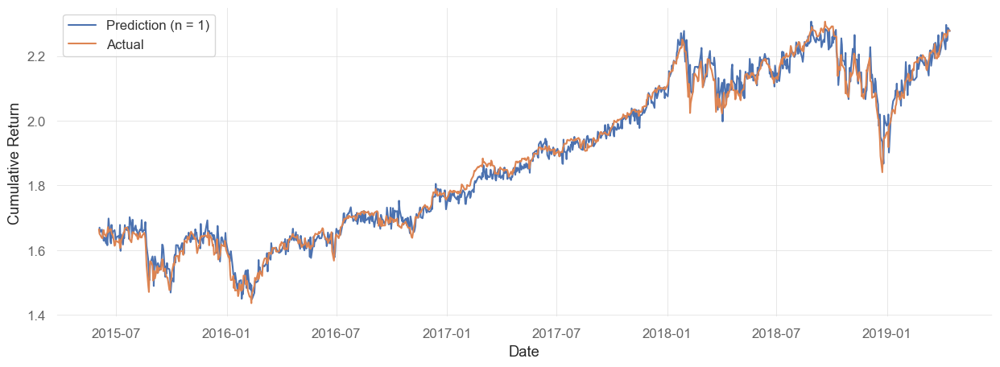

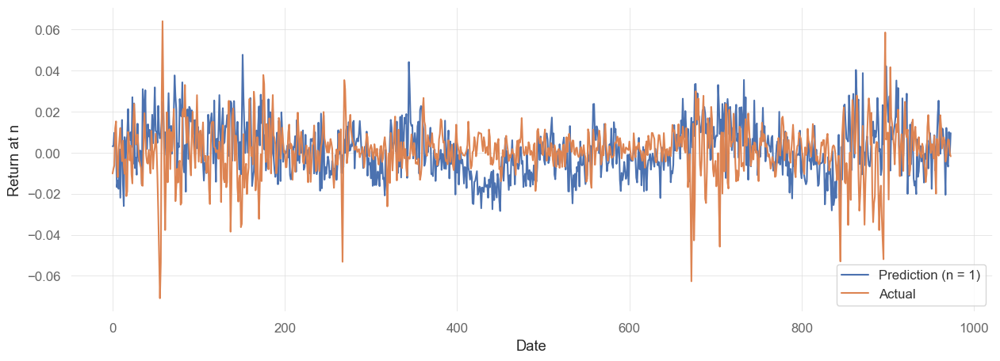

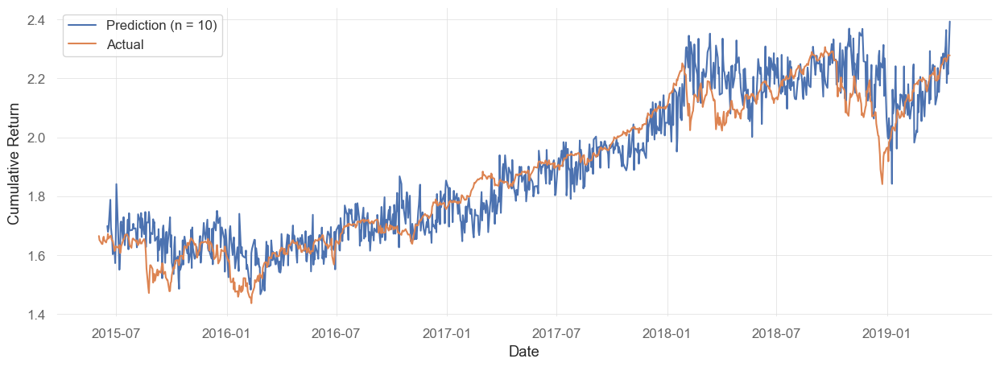

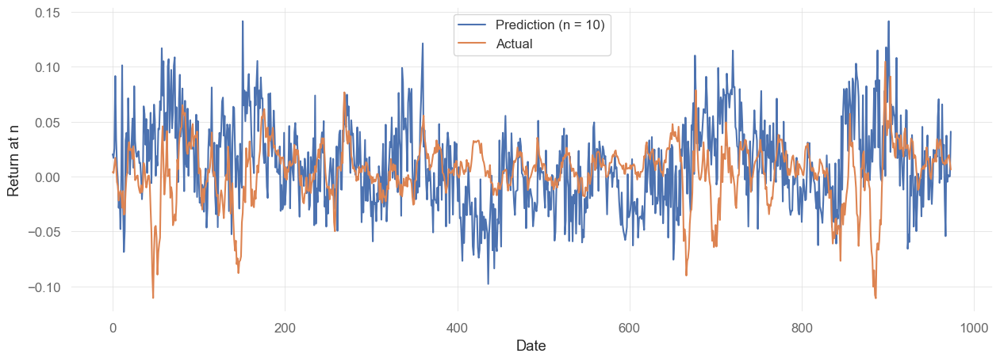

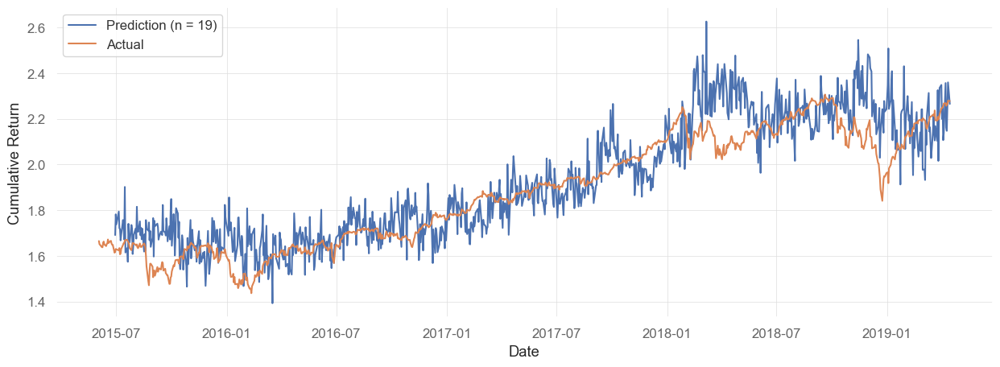

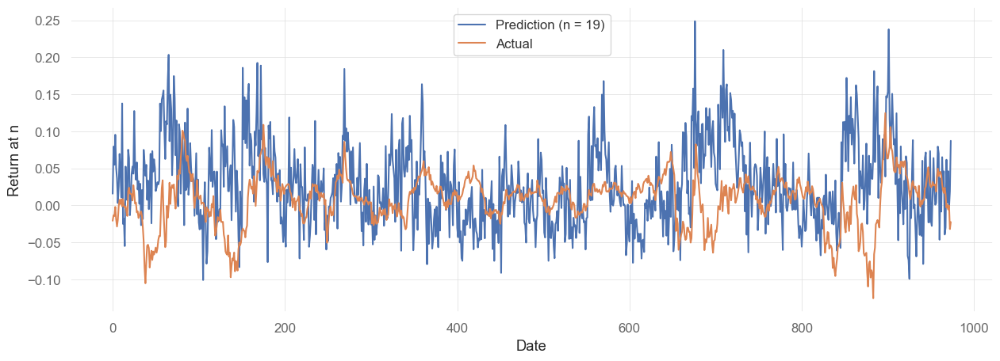

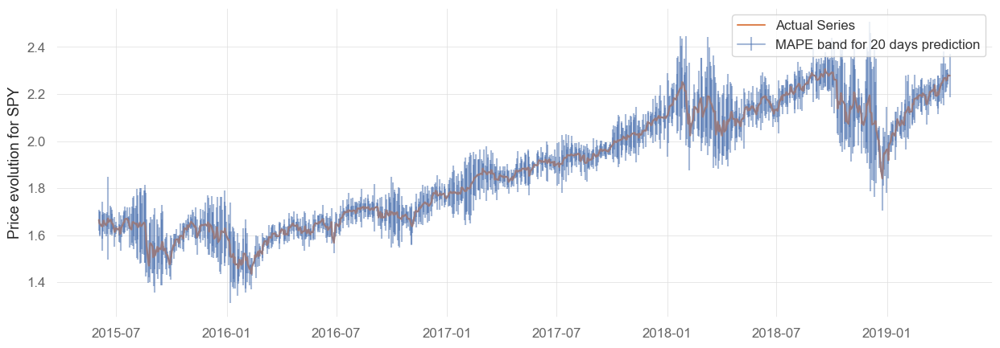

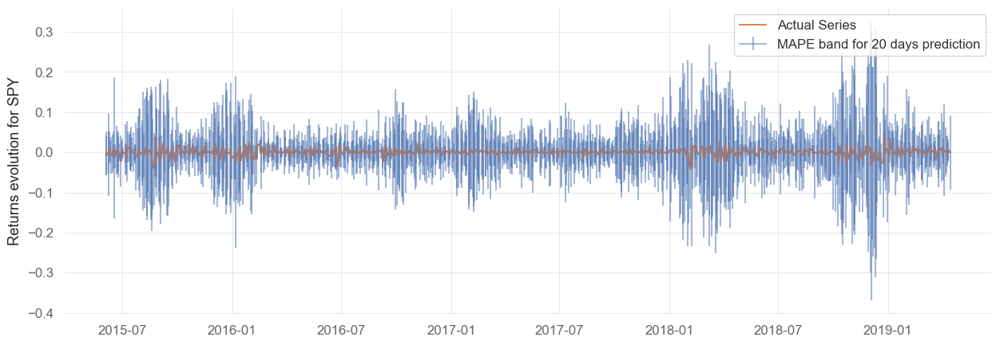

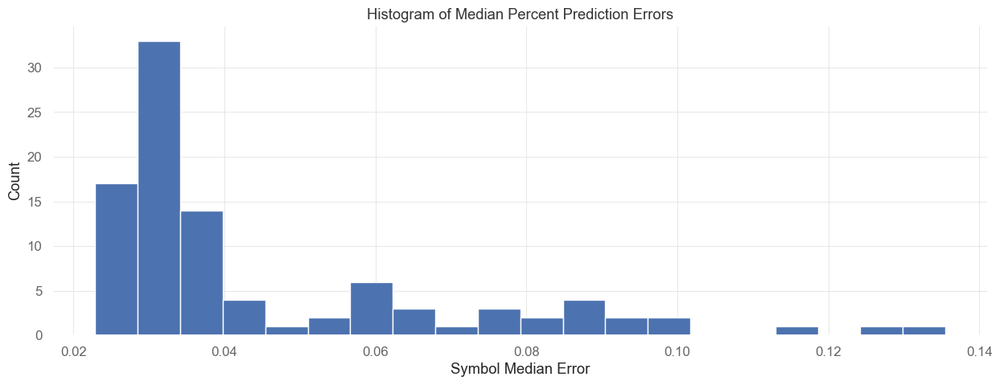

count    97.000000
mean      0.045913
std       0.024966
min       0.022888
25%       0.029420
50%       0.033848
75%       0.057501
max       0.135512
Name: 50%, dtype: float64
Median of Median Errors    0.033848
Mean of Median Errors      0.045913
Mean of Mean Errors        0.057638
dtype: float64
max_depth: -1, learning_rate: 0.9
------
Training BIB...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001698 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8589
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features: 44
[LightGBM] [Info] Start training from score 0.003317
Training CSM...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002064 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8617
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features

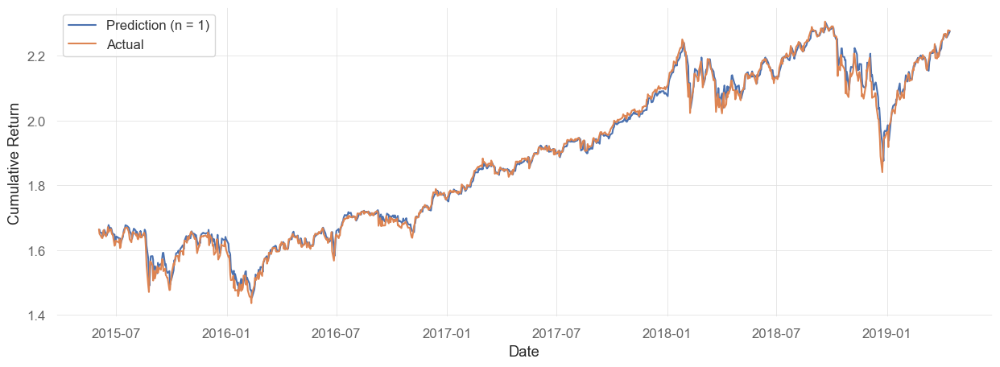

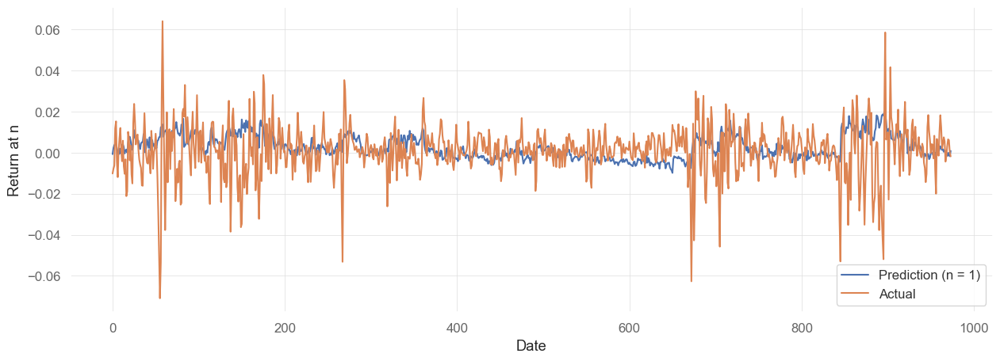

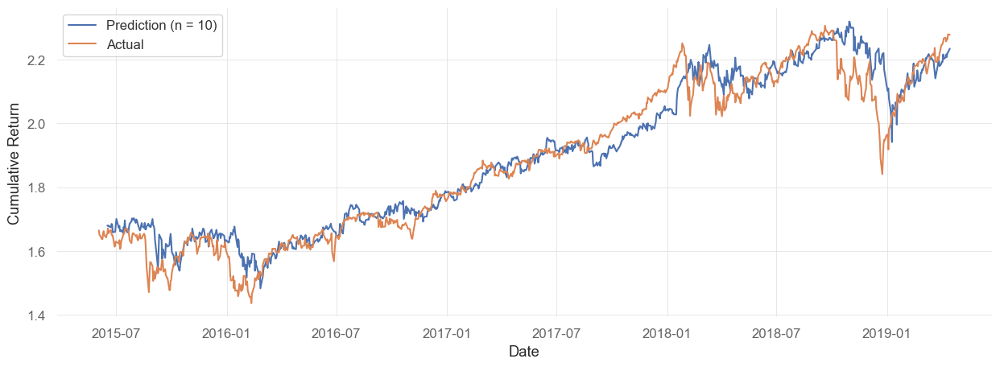

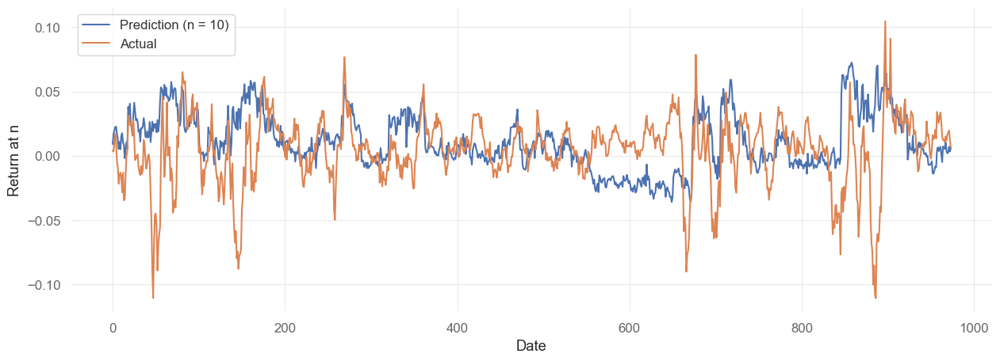

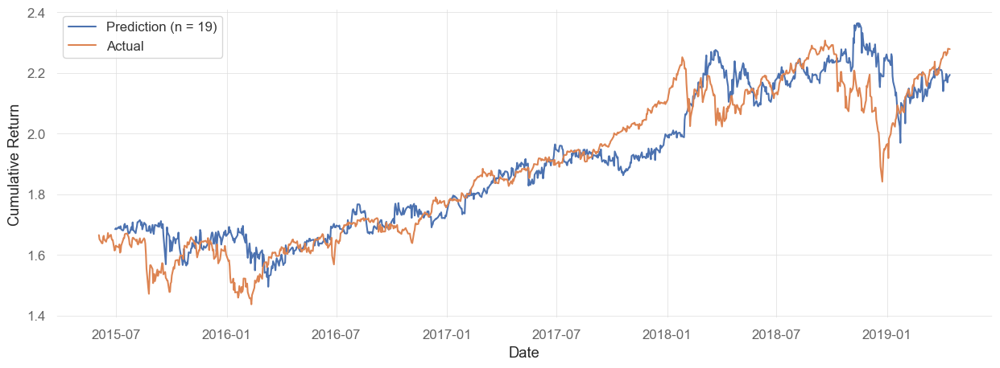

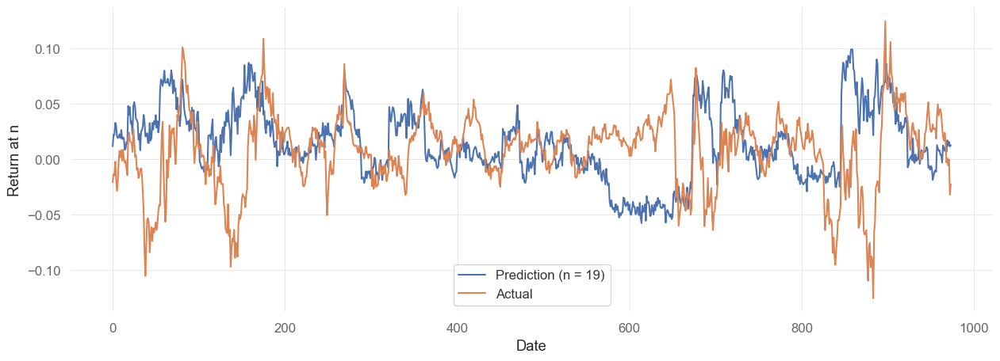

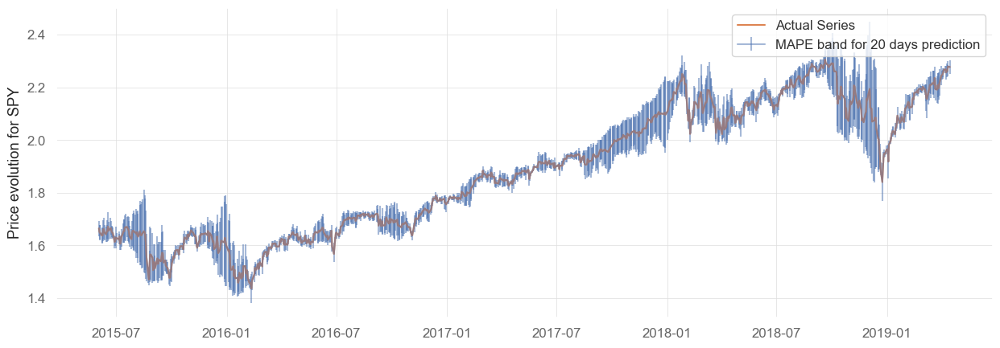

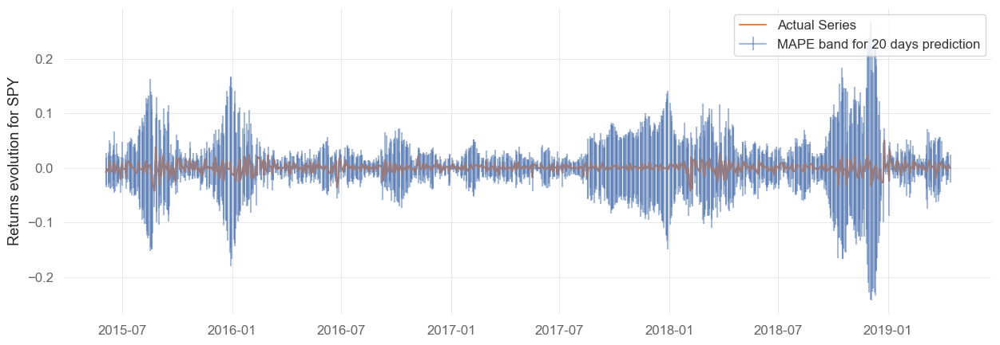

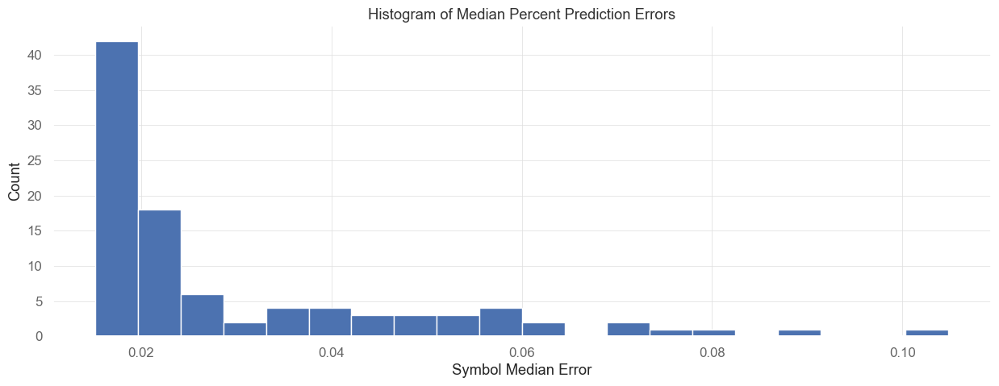

count    97.000000
mean      0.030209
std       0.018905
min       0.015190
25%       0.017328
50%       0.020537
75%       0.038748
max       0.104831
Name: 50%, dtype: float64
Median of Median Errors    0.020537
Mean of Median Errors      0.030209
Mean of Mean Errors        0.039877
dtype: float64
max_depth: -1, learning_rate: 0.1
------
Training BIB...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001533 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8589
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features: 44
[LightGBM] [Info] Start training from score 0.003317
Training CSM...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003367 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8617
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features

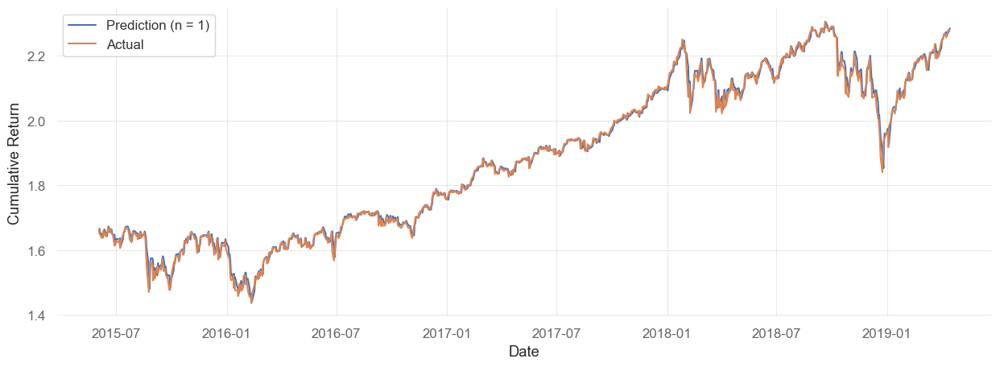

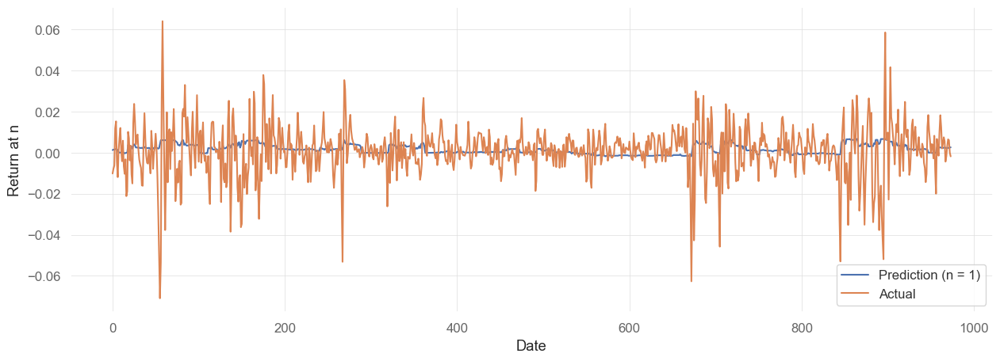

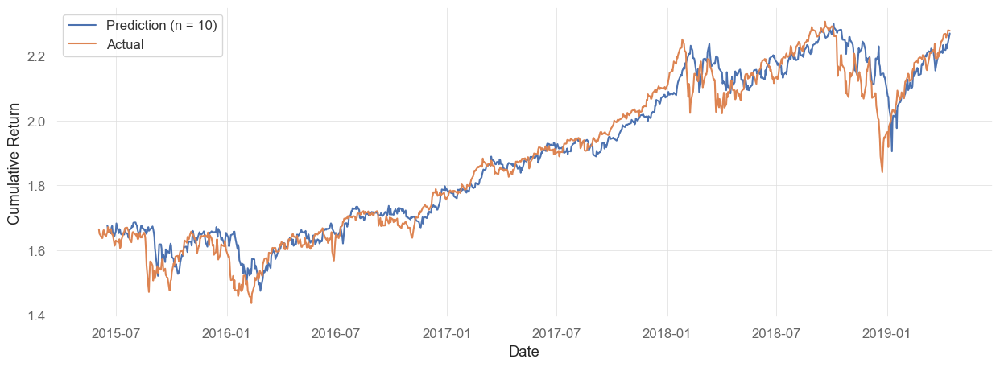

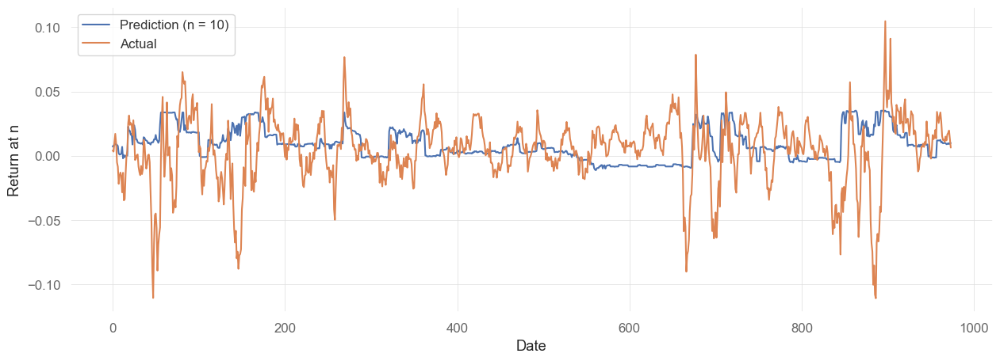

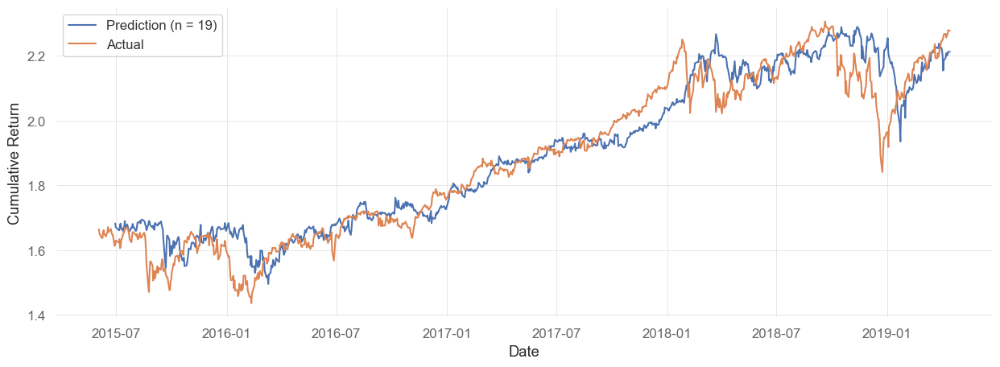

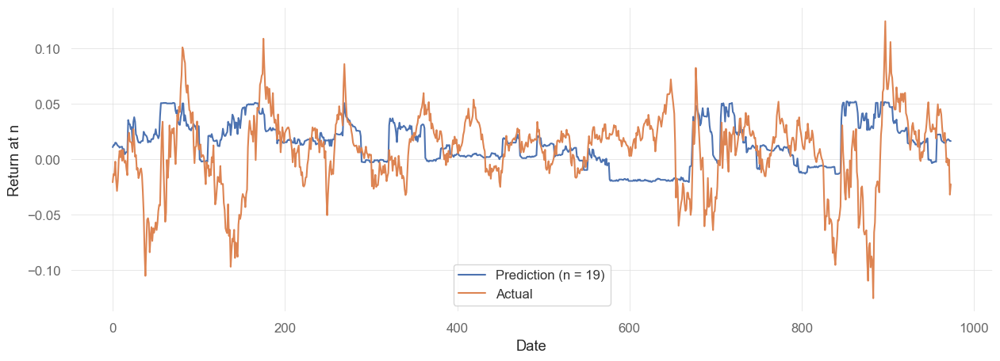

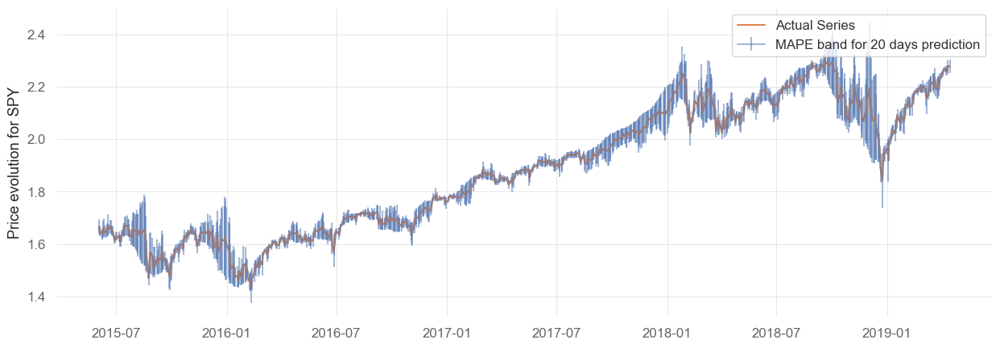

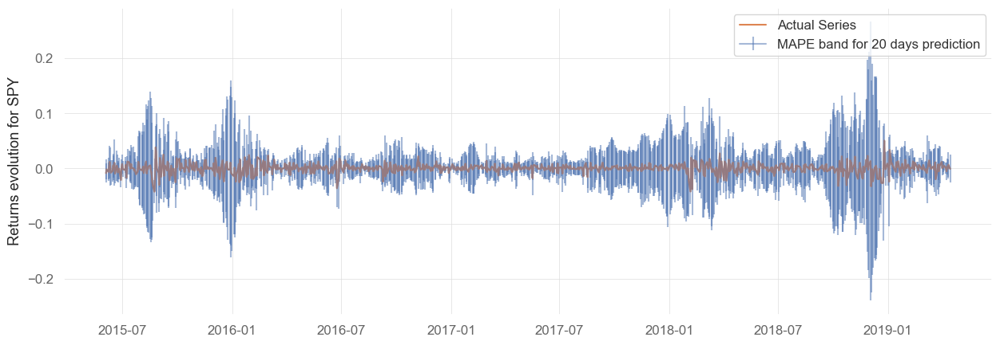

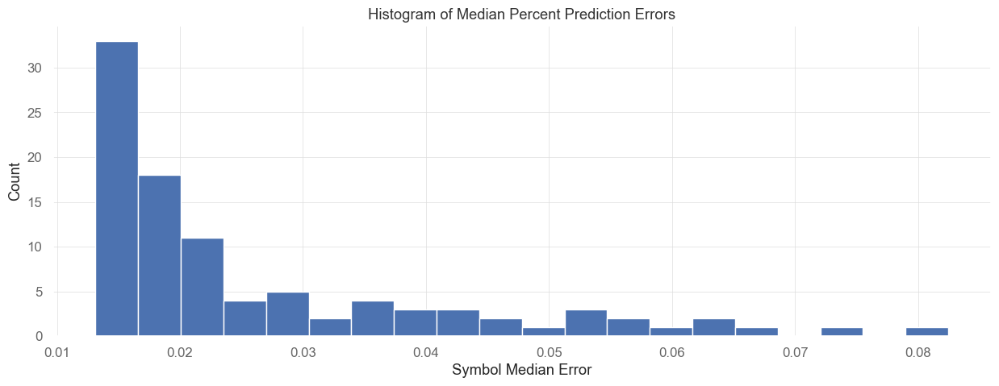

count    97.000000
mean      0.026622
std       0.015720
min       0.013135
25%       0.015675
50%       0.019208
75%       0.033093
max       0.082469
Name: 50%, dtype: float64
Median of Median Errors    0.019208
Mean of Median Errors      0.026622
Mean of Mean Errors        0.034735
dtype: float64
max_depth: -1, learning_rate: 0.01
------
Training BIB...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002603 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8589
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features: 44
[LightGBM] [Info] Start training from score 0.003317
Training CSM...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001657 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8617
[LightGBM] [Info] Number of data points in the train set: 11500, number of used feature

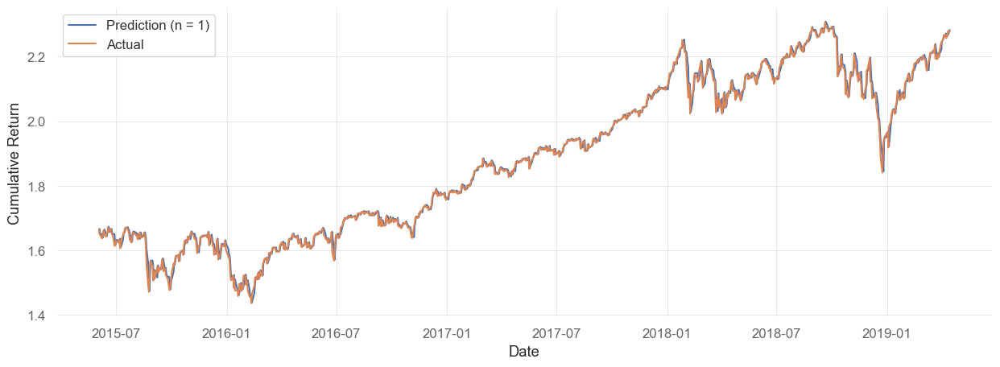

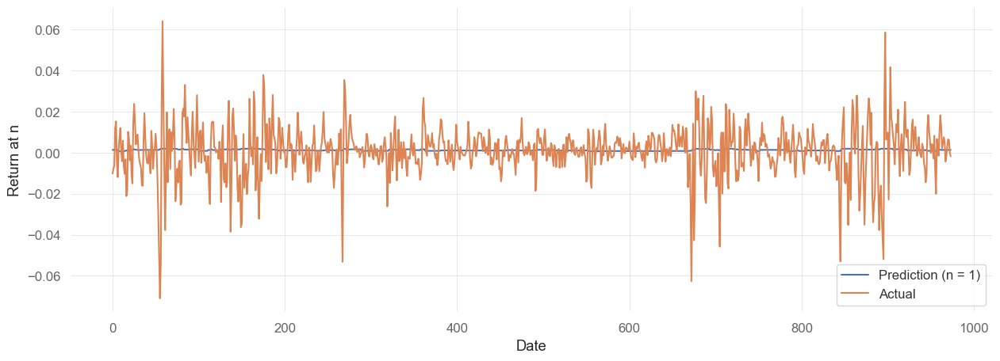

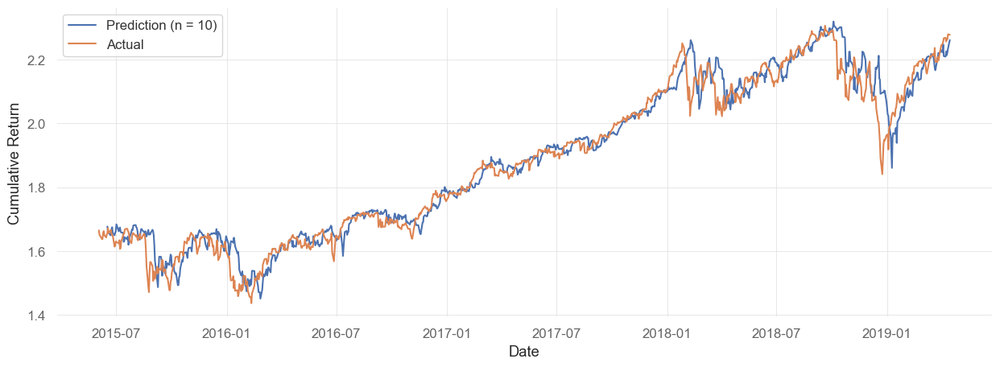

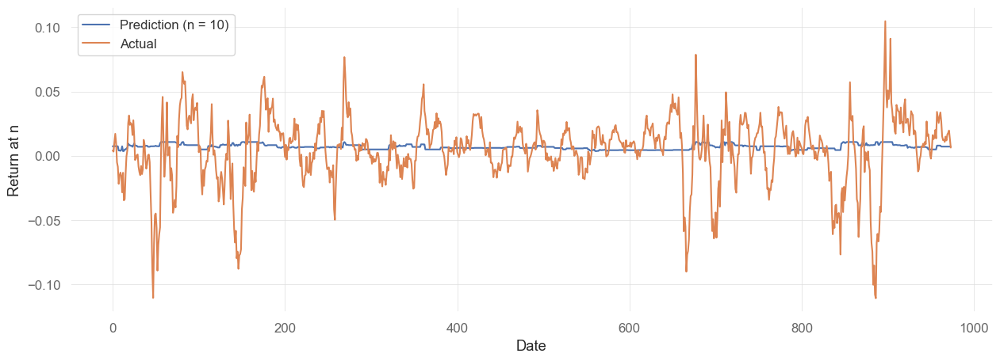

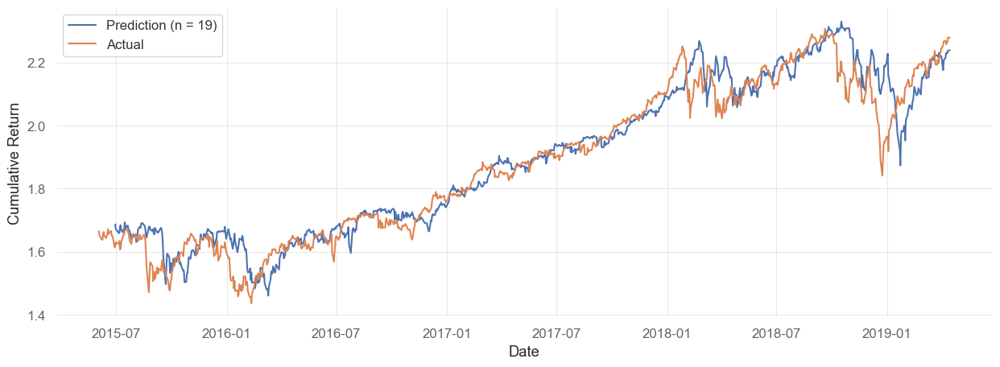

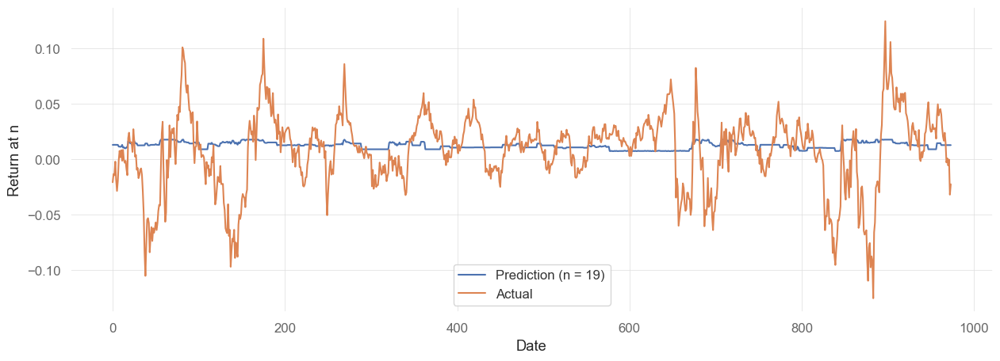

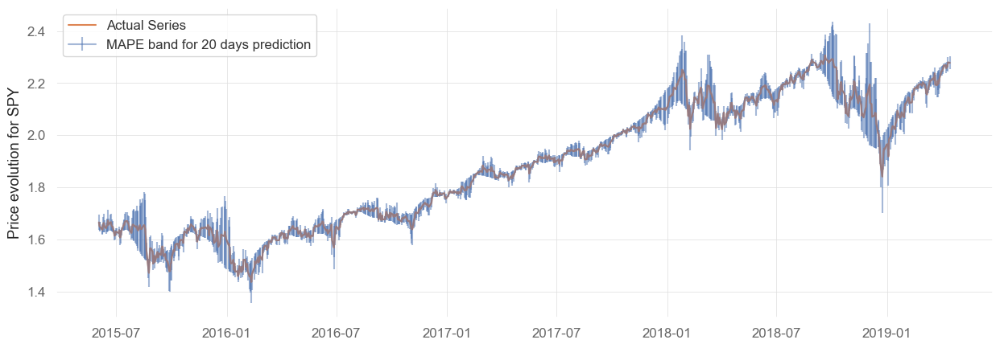

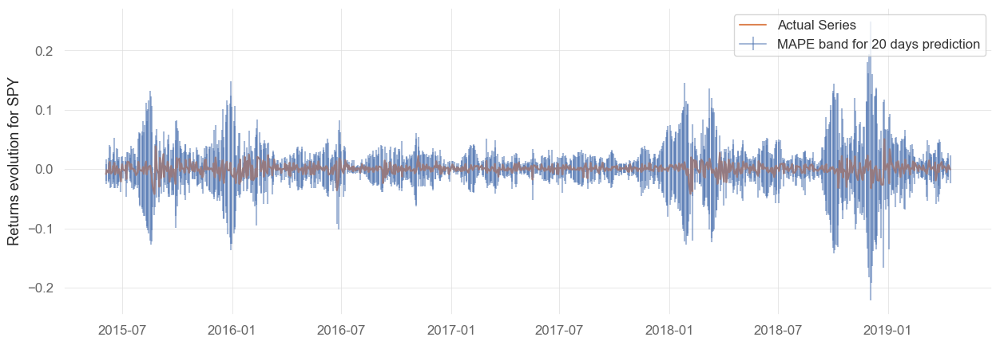

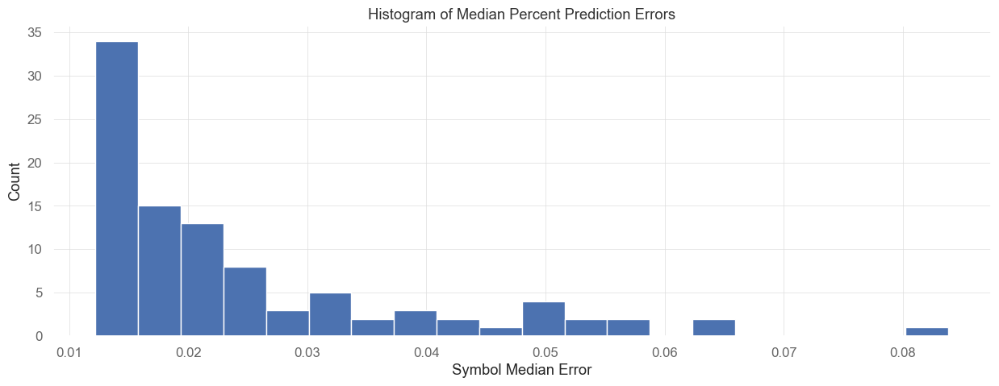

count    97.000000
mean      0.024537
std       0.014436
min       0.012222
25%       0.014364
50%       0.019114
75%       0.028876
max       0.083813
Name: 50%, dtype: float64
Median of Median Errors    0.019114
Mean of Median Errors      0.024537
Mean of Mean Errors        0.032004
dtype: float64
max_depth: -1, learning_rate: 0.001
------
Training BIB...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001455 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8589
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features: 44
[LightGBM] [Info] Start training from score 0.003317
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

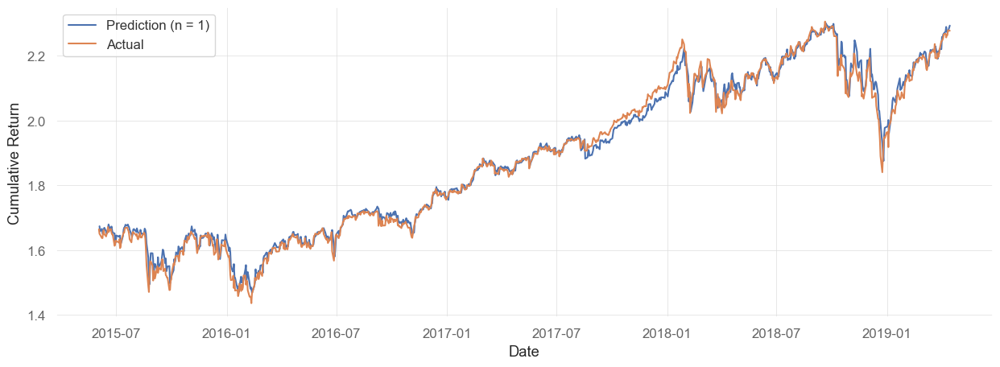

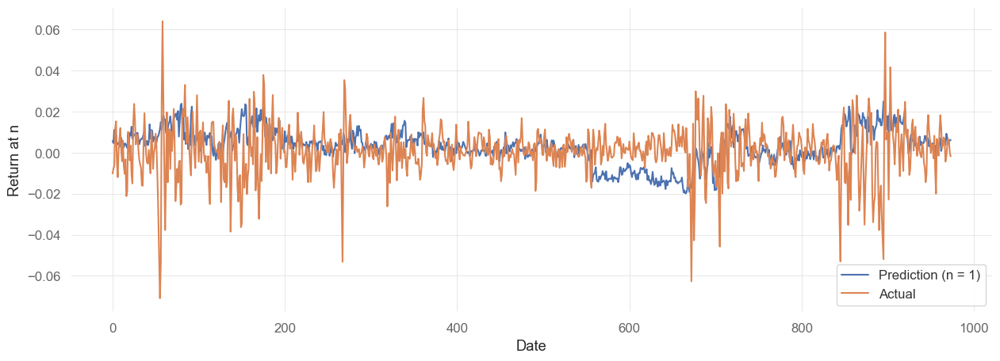

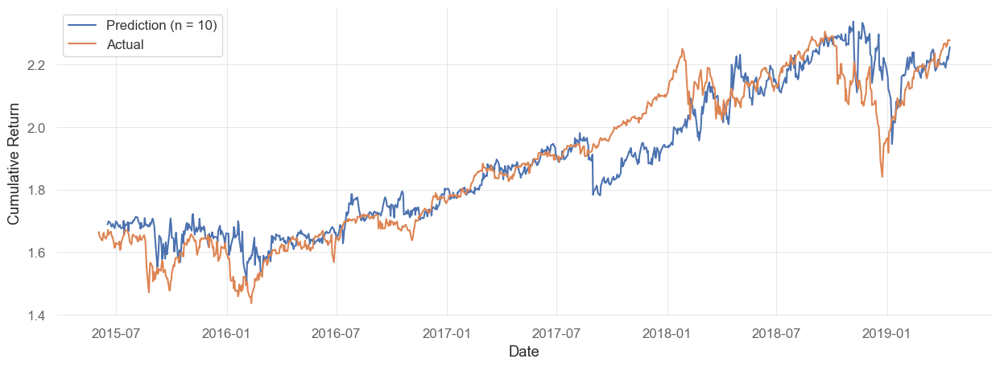

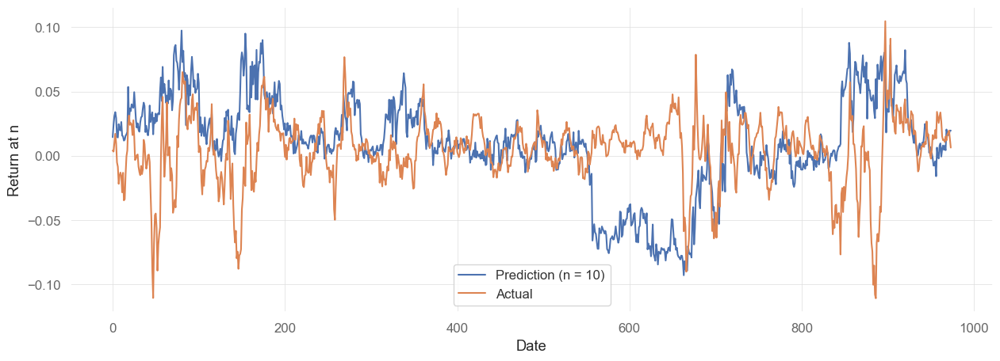

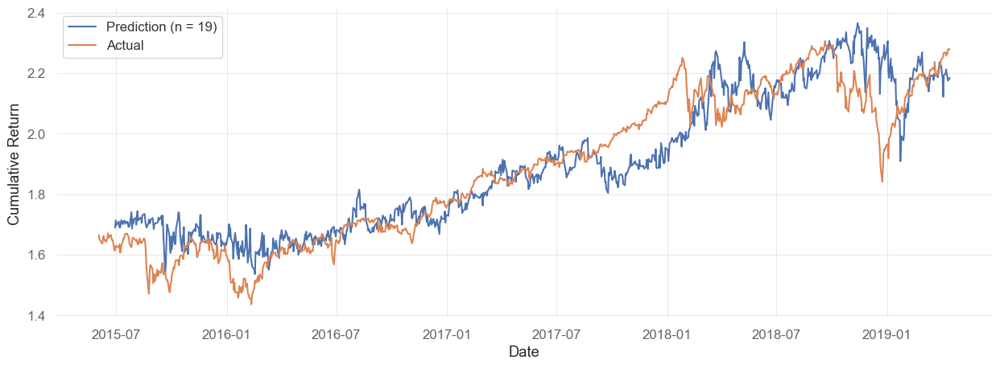

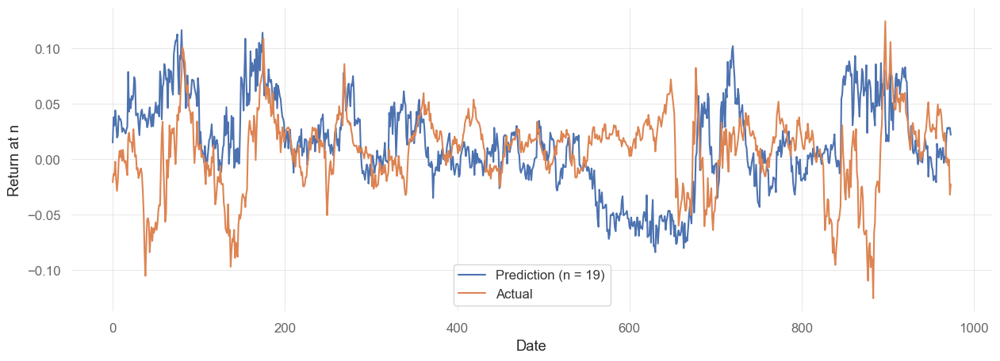

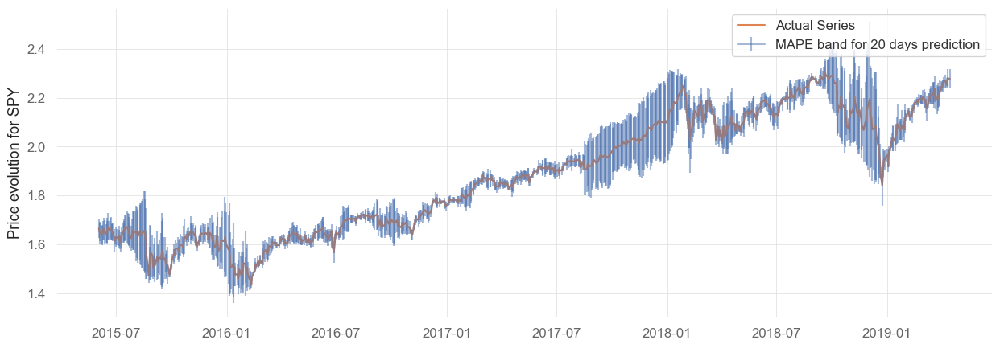

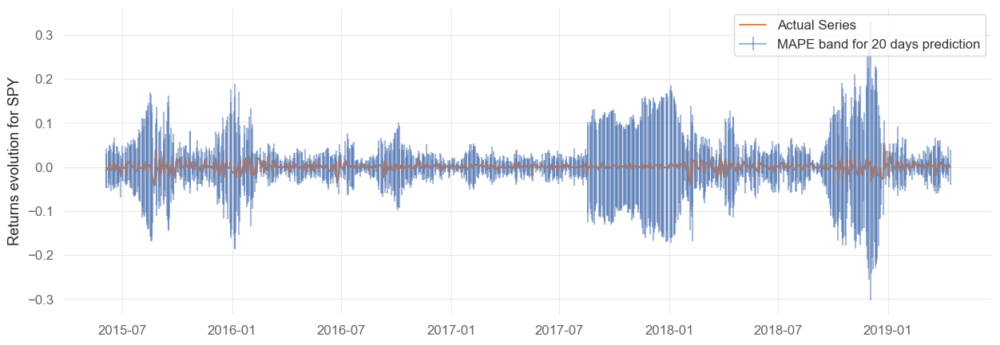

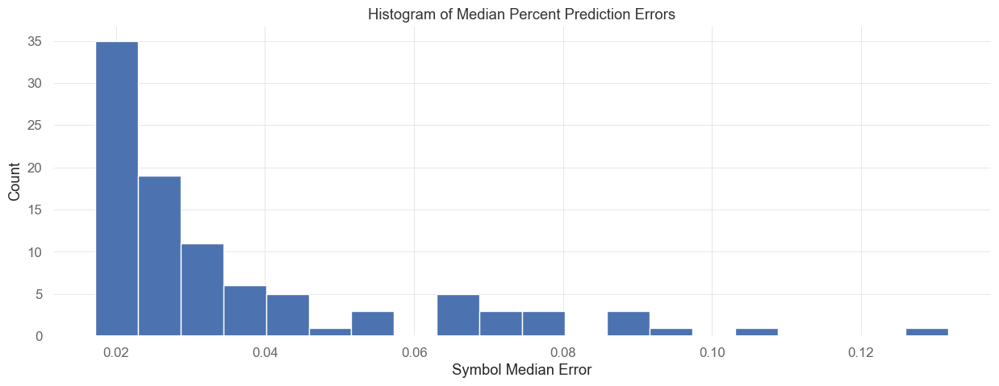

count    97.000000
mean      0.036904
std       0.023322
min       0.017237
25%       0.021456
50%       0.025411
75%       0.042773
max       0.131725
Name: 50%, dtype: float64
Median of Median Errors    0.025411
Mean of Median Errors      0.036904
Mean of Mean Errors        0.047176
dtype: float64
max_depth: 2, learning_rate: 0.9
------
Training BIB...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003627 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8589
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features: 44
[LightGBM] [Info] Start training from score 0.003317
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

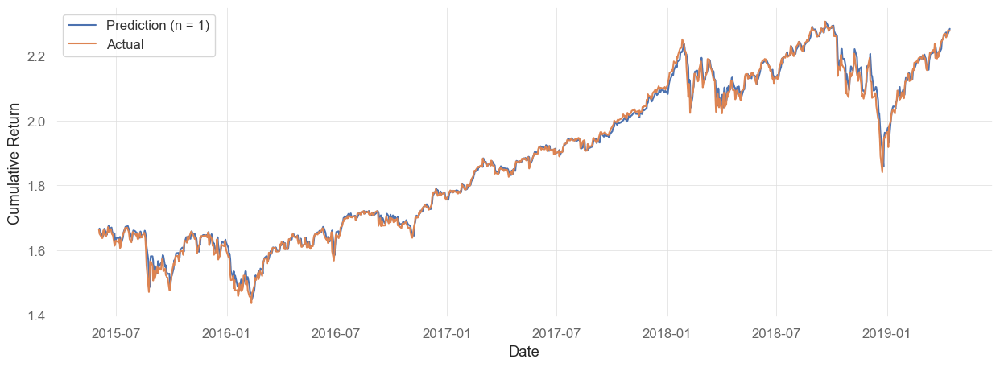

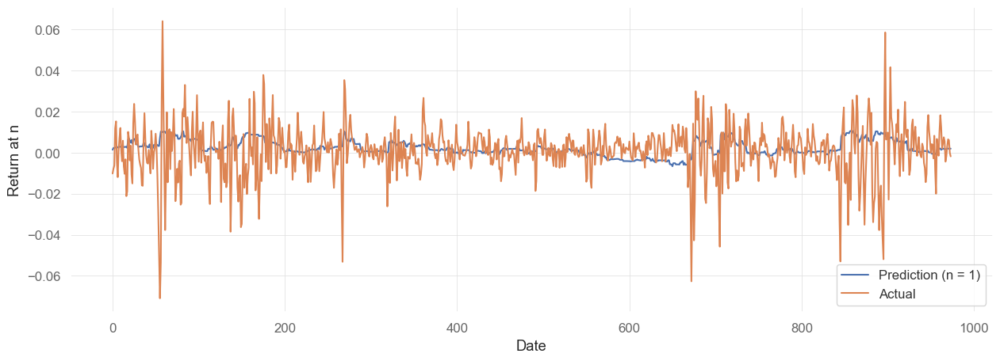

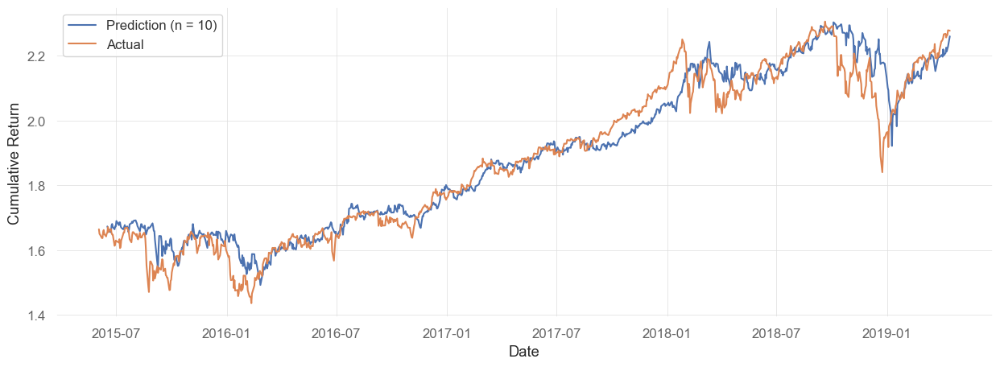

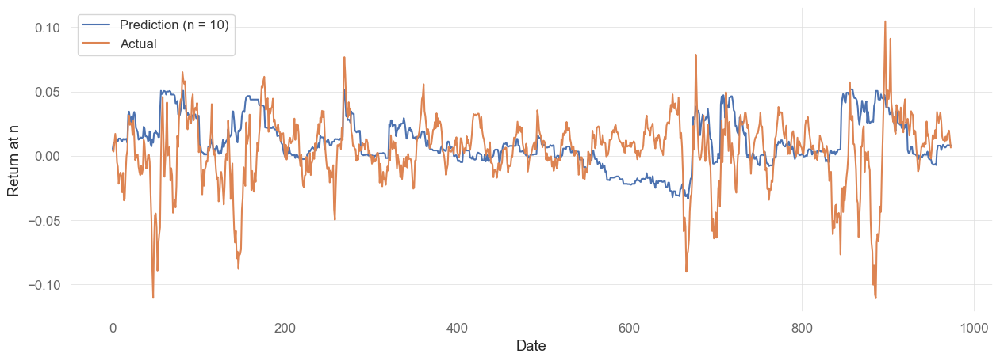

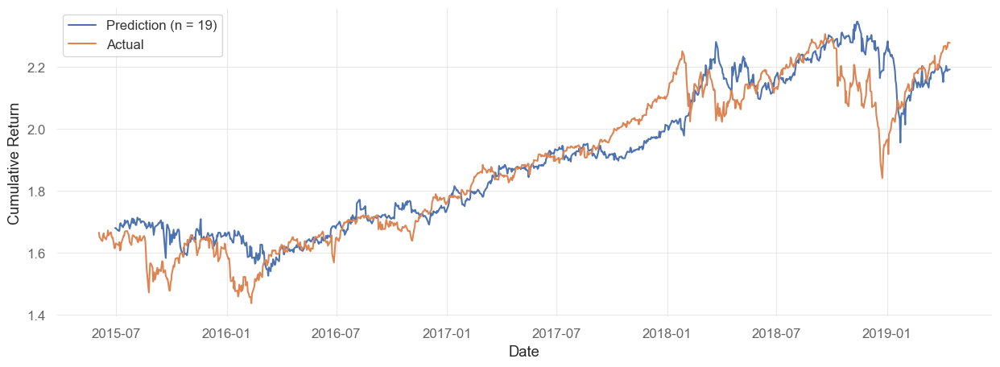

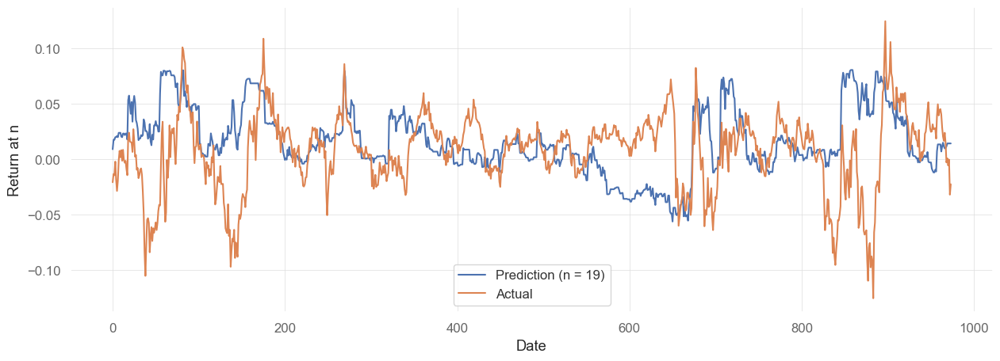

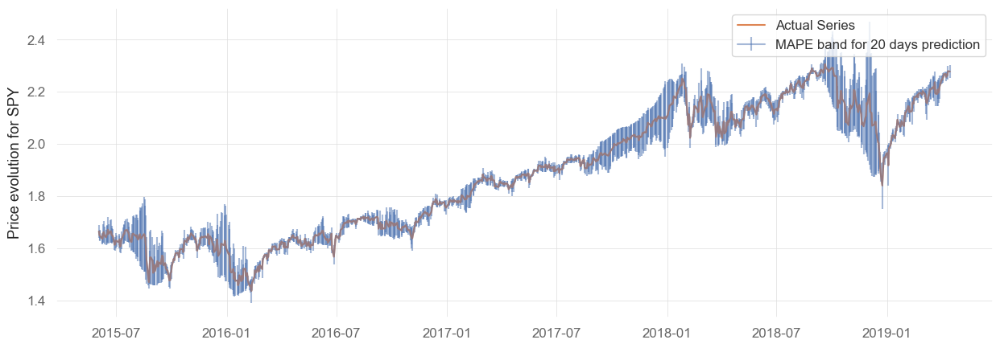

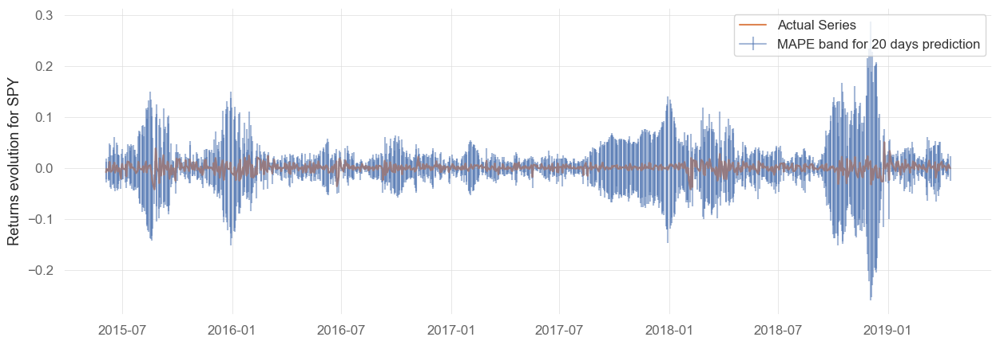

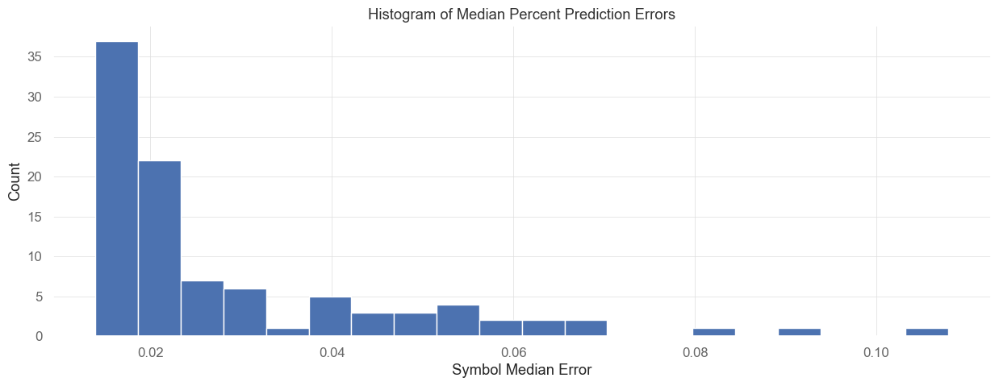

count    97.000000
mean      0.028753
std       0.018338
min       0.013948
25%       0.016294
50%       0.020256
75%       0.036496
max       0.107927
Name: 50%, dtype: float64
Median of Median Errors    0.020256
Mean of Median Errors      0.028753
Mean of Mean Errors        0.037912
dtype: float64
max_depth: 2, learning_rate: 0.1
------
Training BIB...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003684 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8589
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features: 44
[LightGBM] [Info] Start training from score 0.003317
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

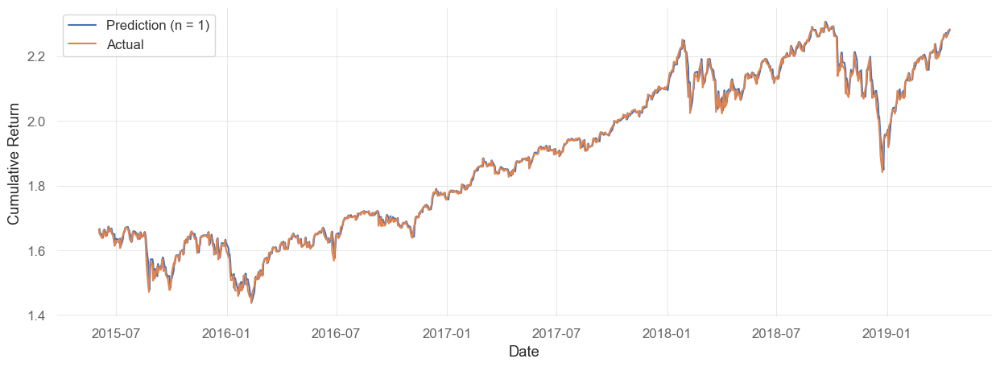

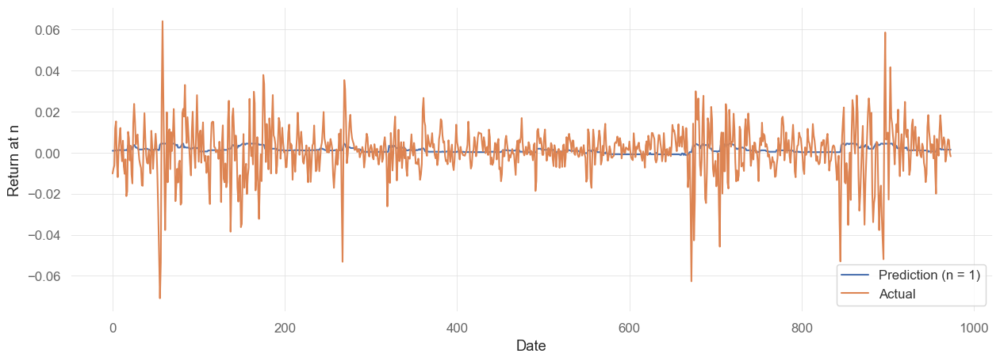

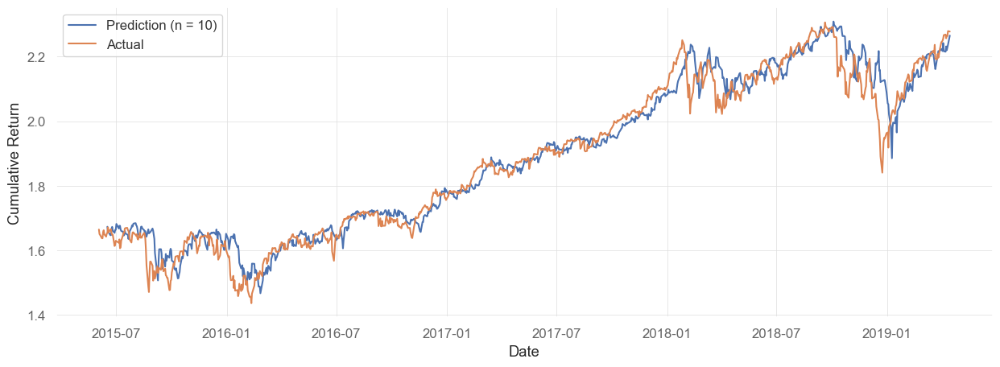

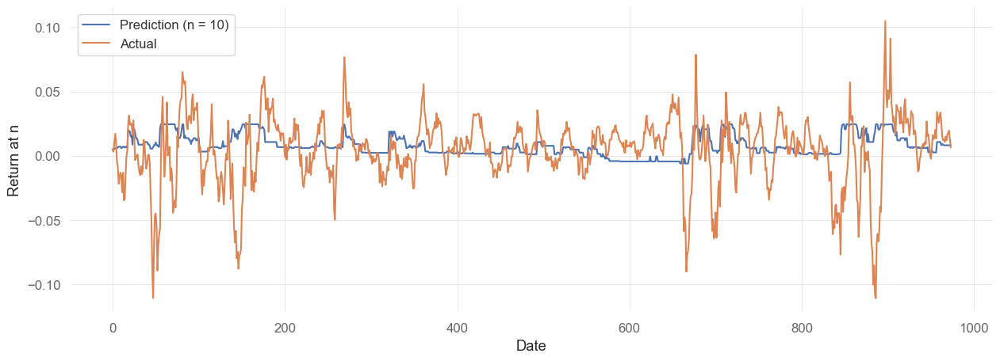

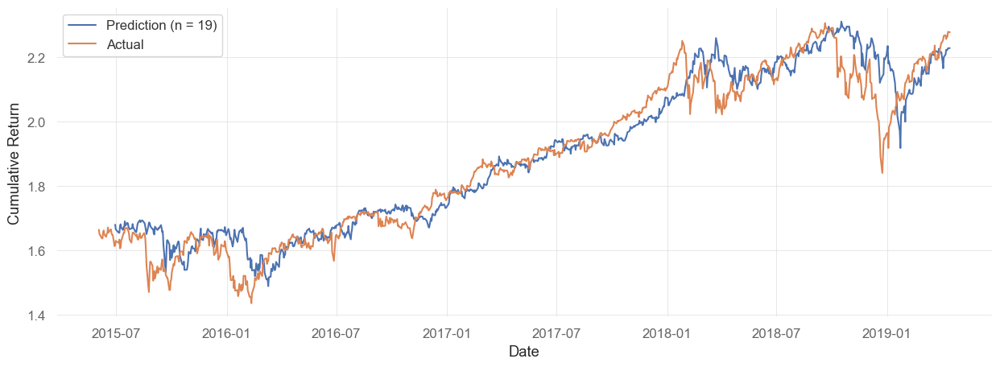

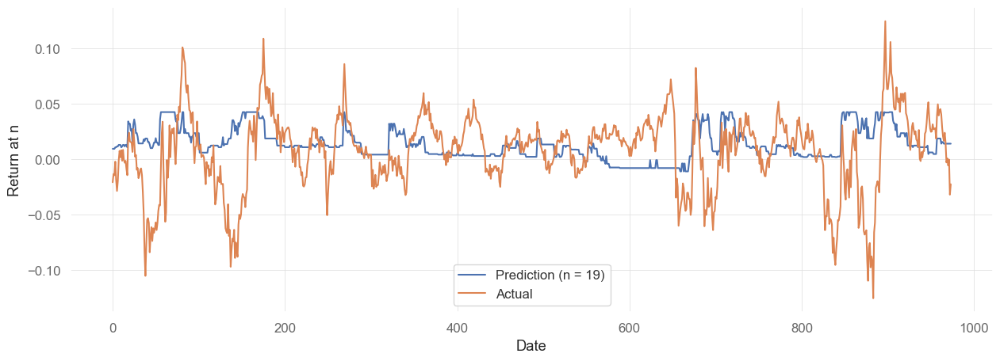

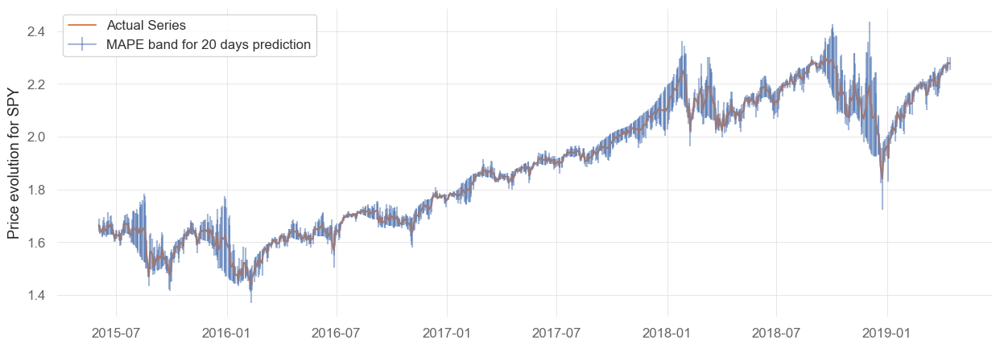

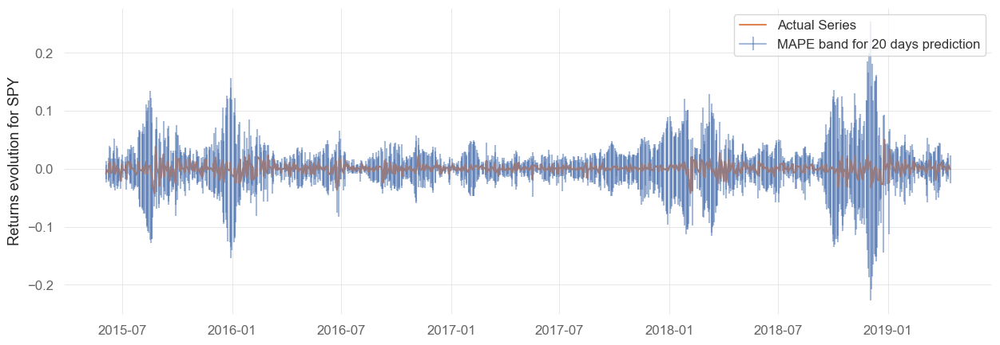

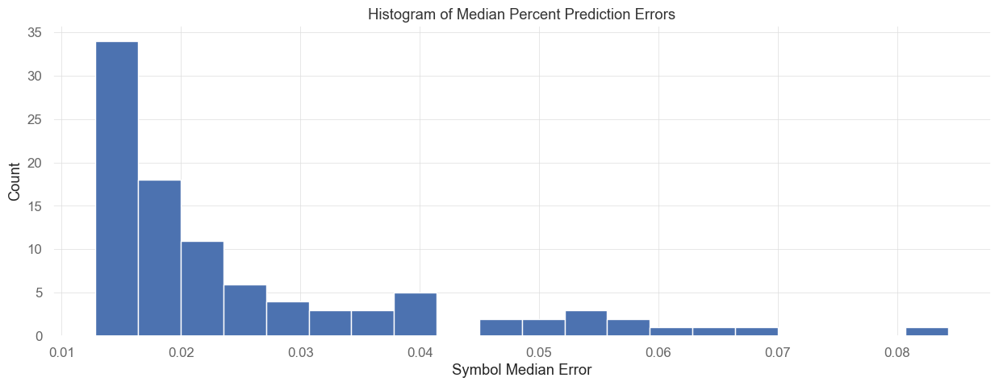

count    97.000000
mean      0.025375
std       0.014976
min       0.012830
25%       0.014668
50%       0.018970
75%       0.030601
max       0.084296
Name: 50%, dtype: float64
Median of Median Errors    0.018970
Mean of Median Errors      0.025375
Mean of Mean Errors        0.033056
dtype: float64
max_depth: 2, learning_rate: 0.01
------
Training BIB...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004204 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8589
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features: 44
[LightGBM] [Info] Start training from score 0.003317
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


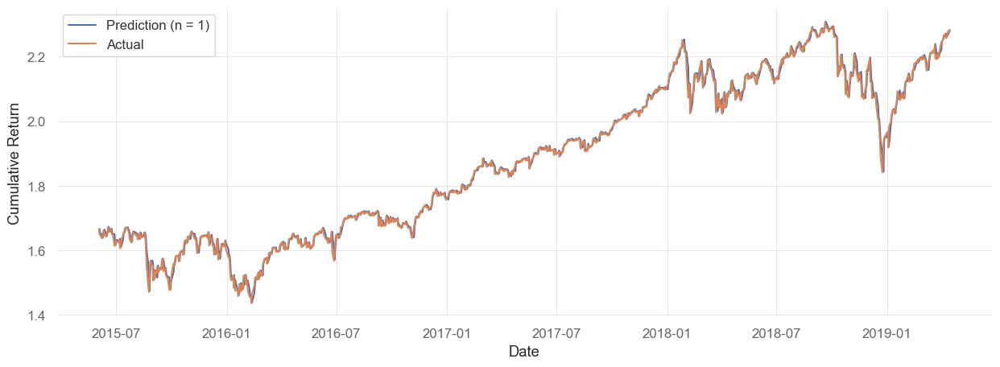

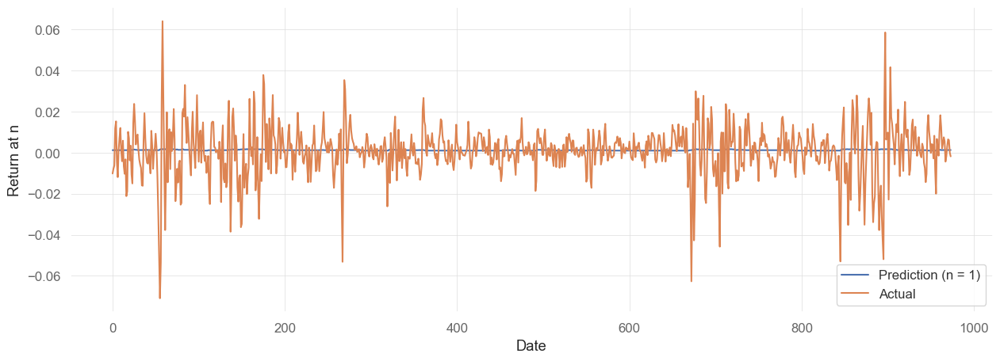

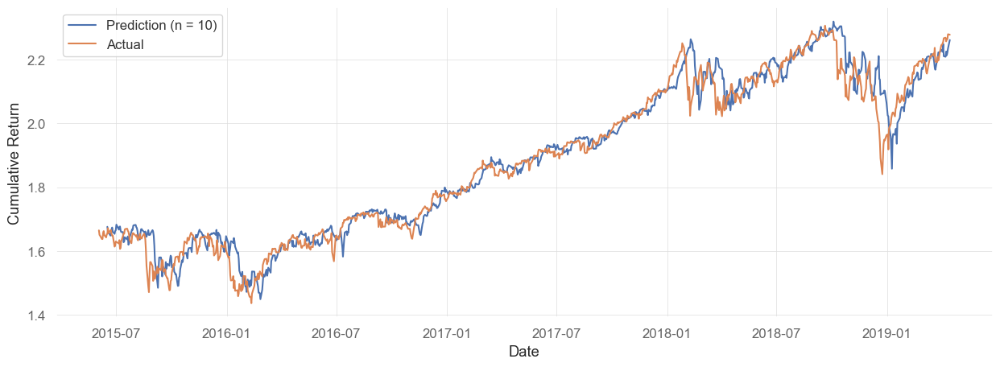

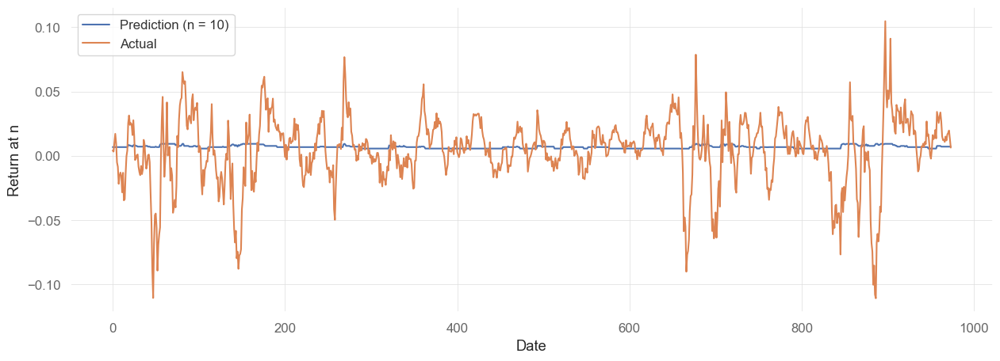

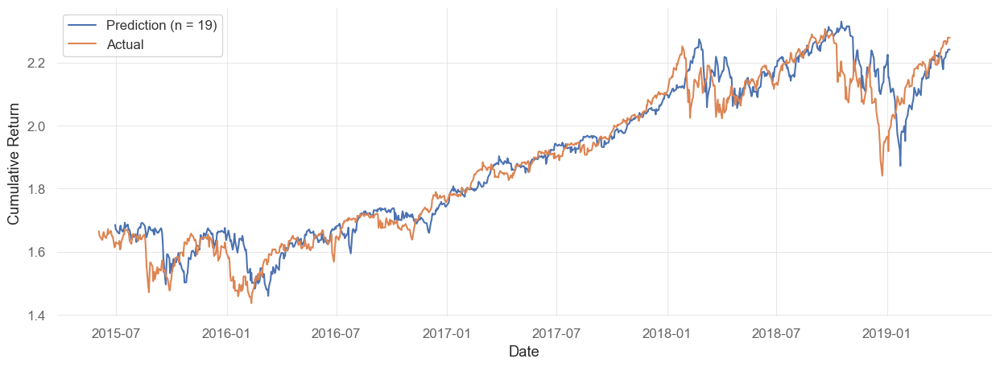

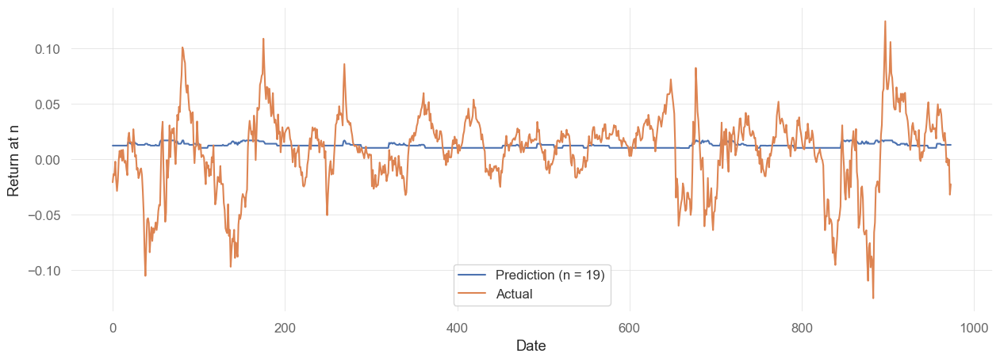

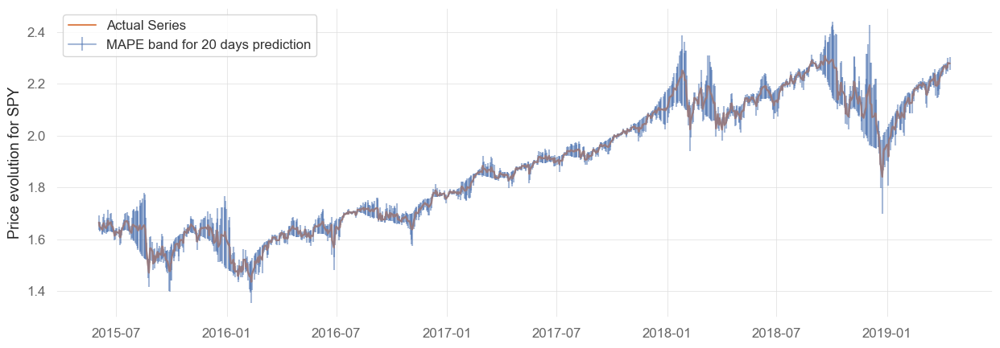

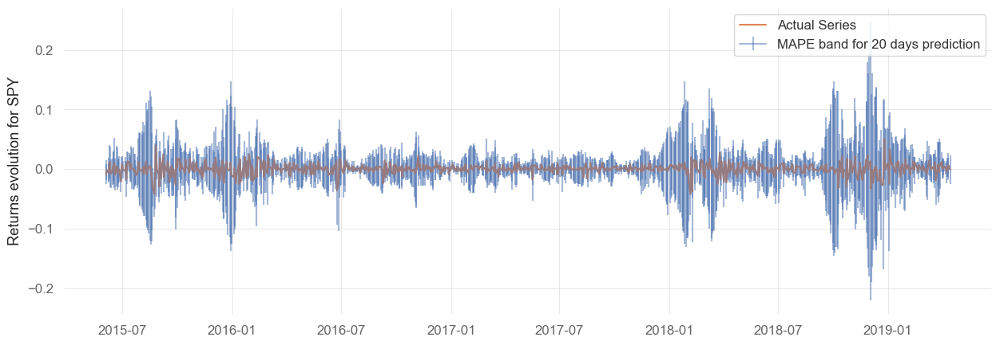

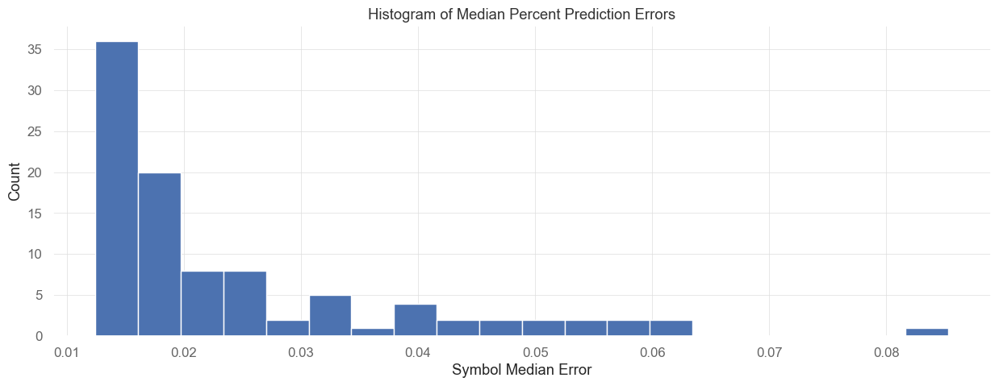

count    97.000000
mean      0.024471
std       0.014432
min       0.012466
25%       0.014245
50%       0.019303
75%       0.028327
max       0.085285
Name: 50%, dtype: float64
Median of Median Errors    0.019303
Mean of Median Errors      0.024471
Mean of Mean Errors        0.031932
dtype: float64
max_depth: 2, learning_rate: 0.001
------
Training BIB...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.010797 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8589
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features: 44
[LightGBM] [Info] Start training from score 0.003317
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

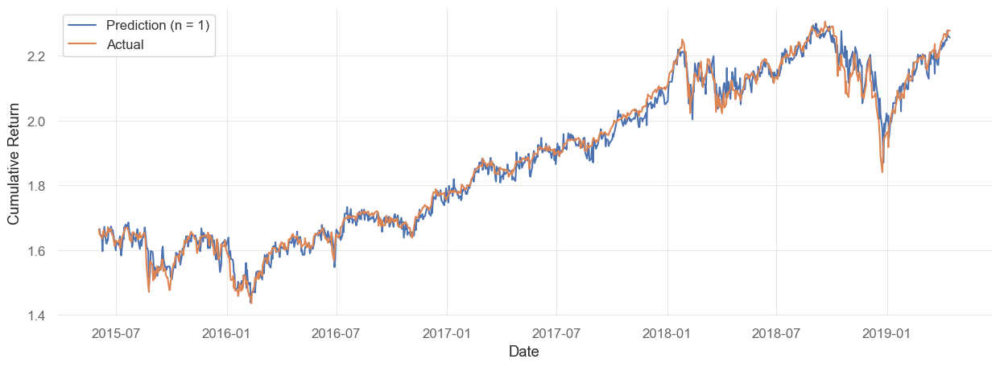

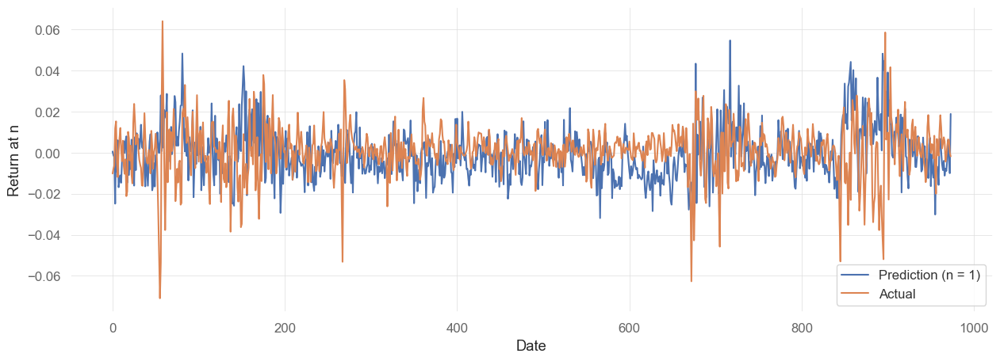

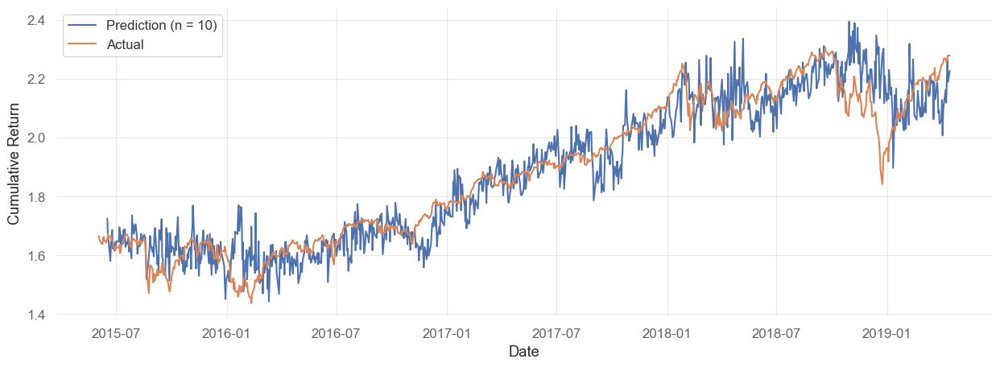

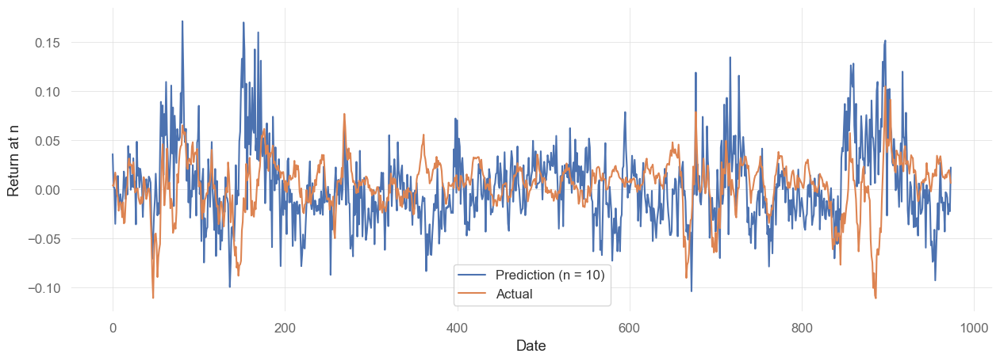

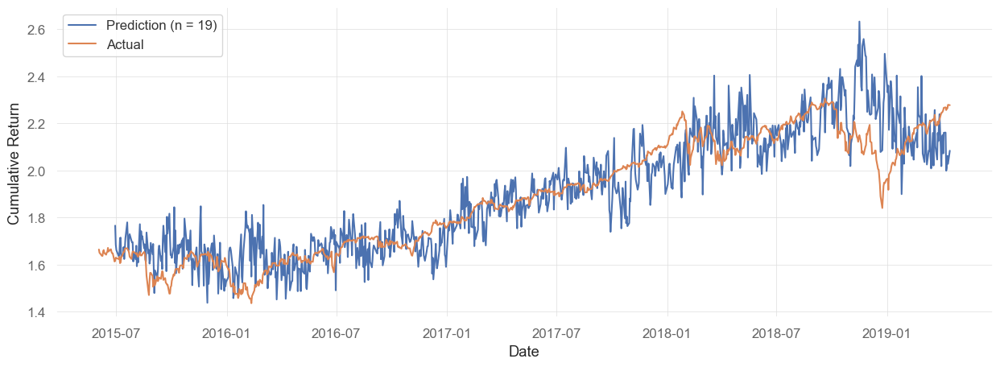

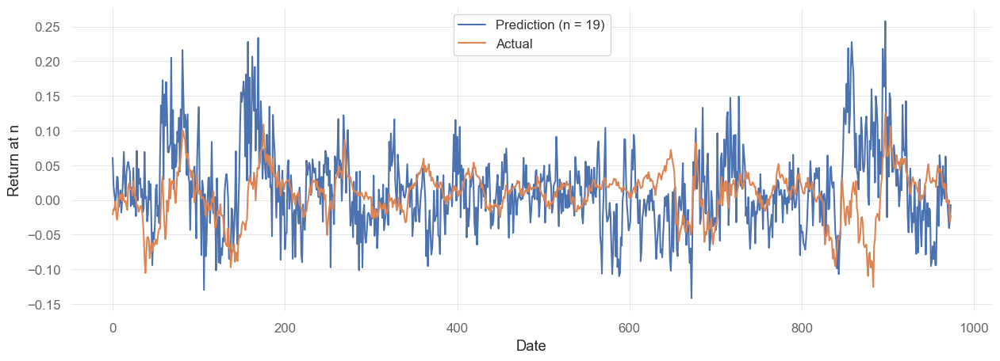

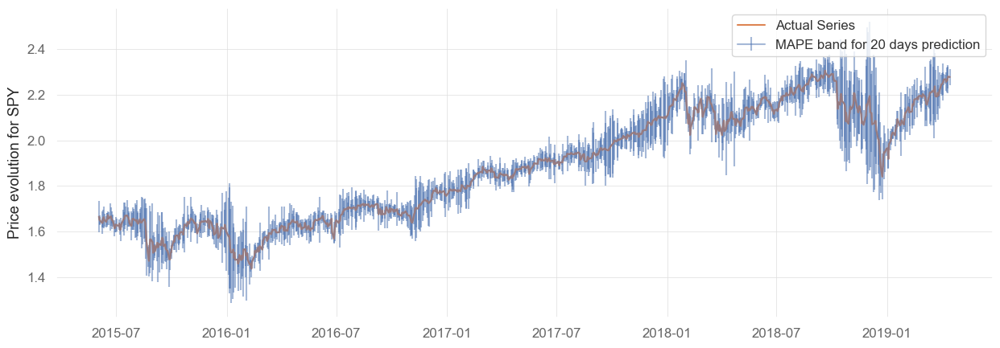

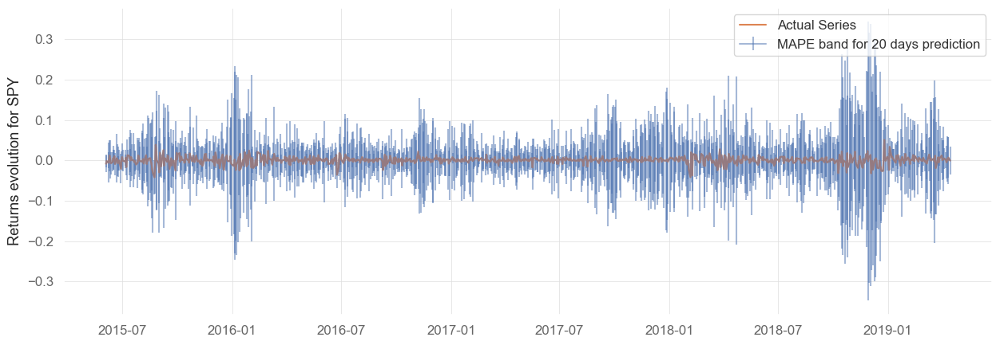

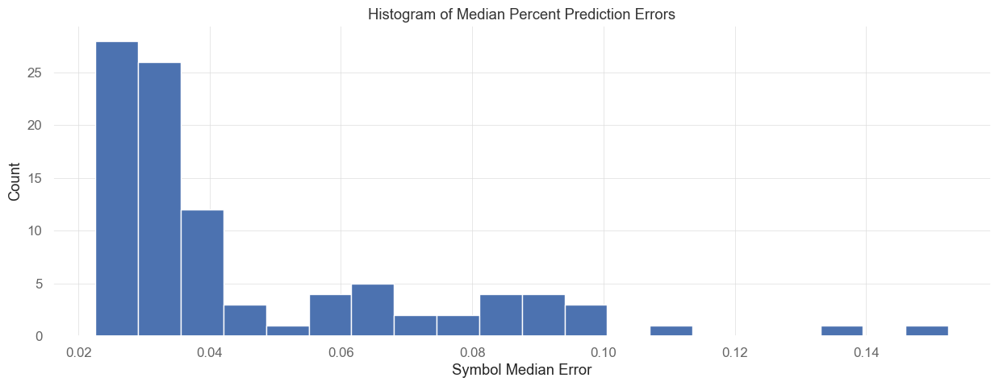

count    97.000000
mean      0.046101
std       0.026753
min       0.022614
25%       0.028547
50%       0.033617
75%       0.058038
max       0.152514
Name: 50%, dtype: float64
Median of Median Errors    0.033617
Mean of Median Errors      0.046101
Mean of Mean Errors        0.058436
dtype: float64
max_depth: 5, learning_rate: 0.9
------
Training BIB...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002500 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8589
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features: 44
[LightGBM] [Info] Start training from score 0.003317
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

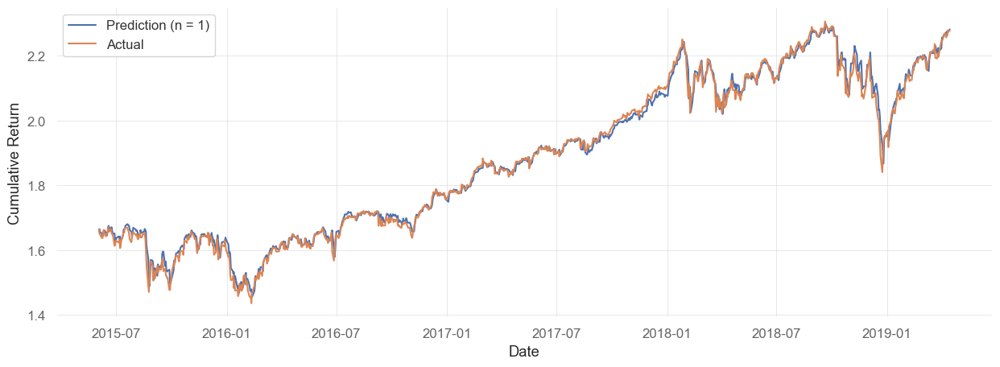

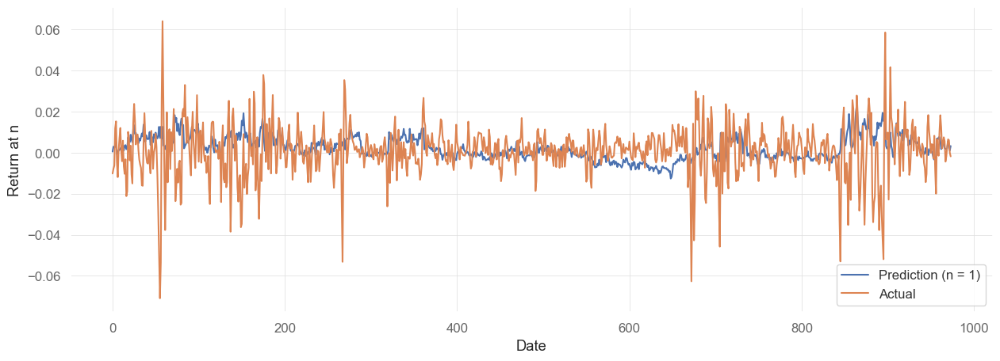

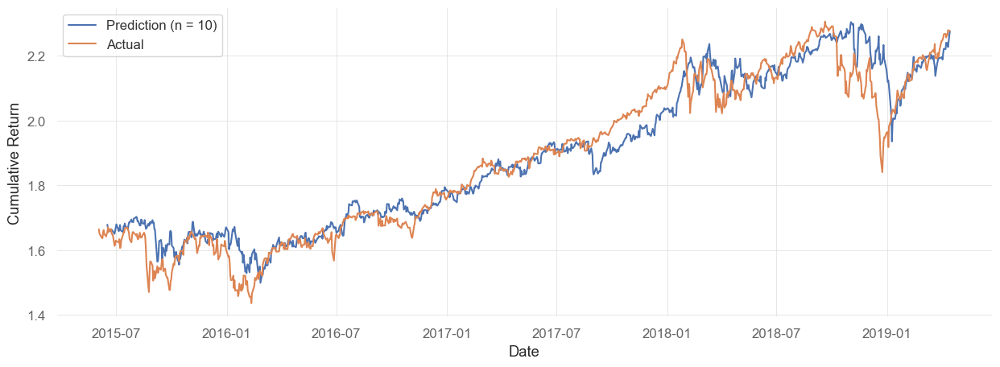

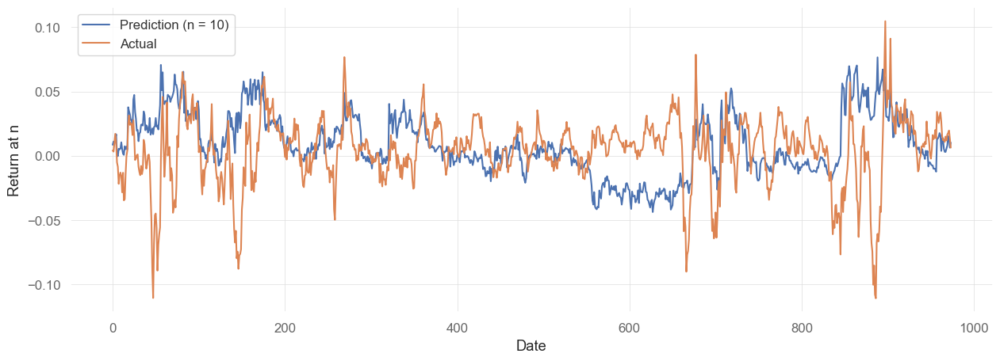

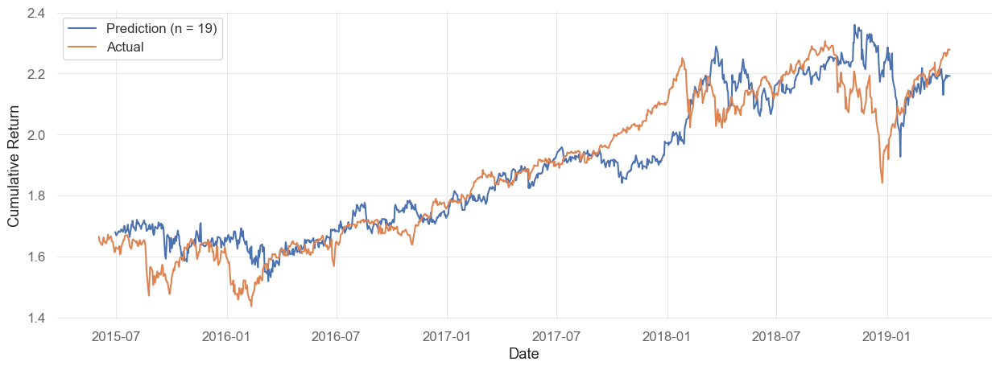

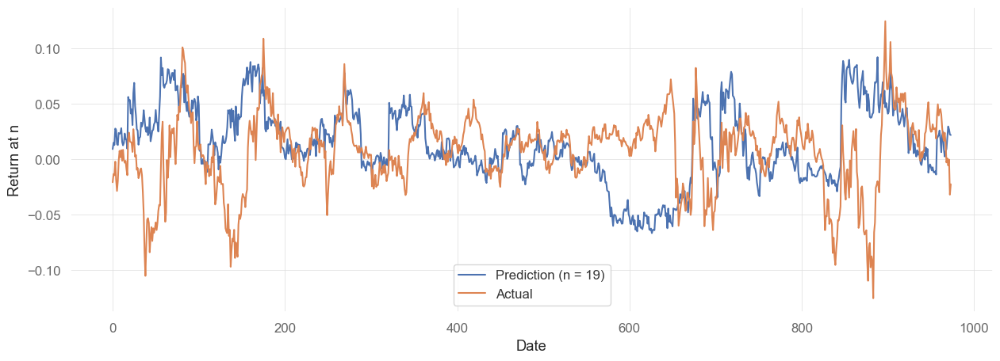

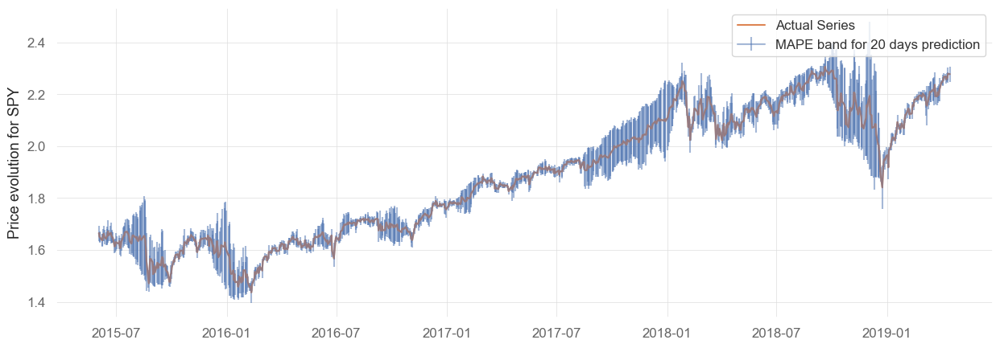

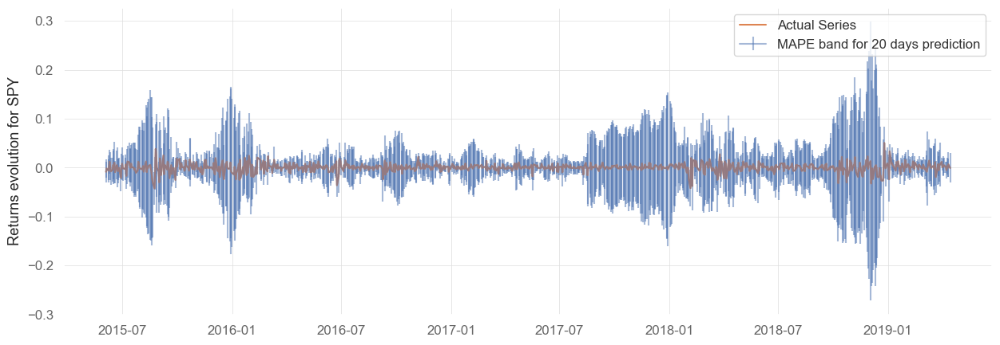

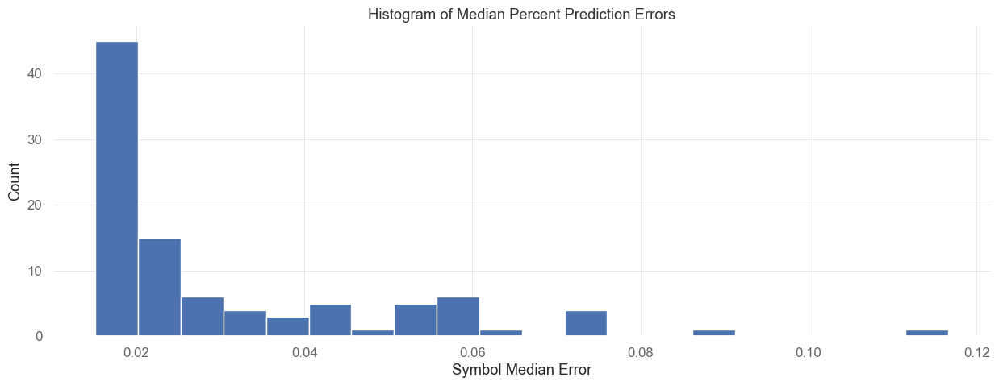

count    97.000000
mean      0.030573
std       0.019332
min       0.015156
25%       0.017574
50%       0.021351
75%       0.038435
max       0.116622
Name: 50%, dtype: float64
Median of Median Errors    0.021351
Mean of Median Errors      0.030573
Mean of Mean Errors        0.040431
dtype: float64
max_depth: 5, learning_rate: 0.1
------
Training BIB...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003959 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8589
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features: 44
[LightGBM] [Info] Start training from score 0.003317
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

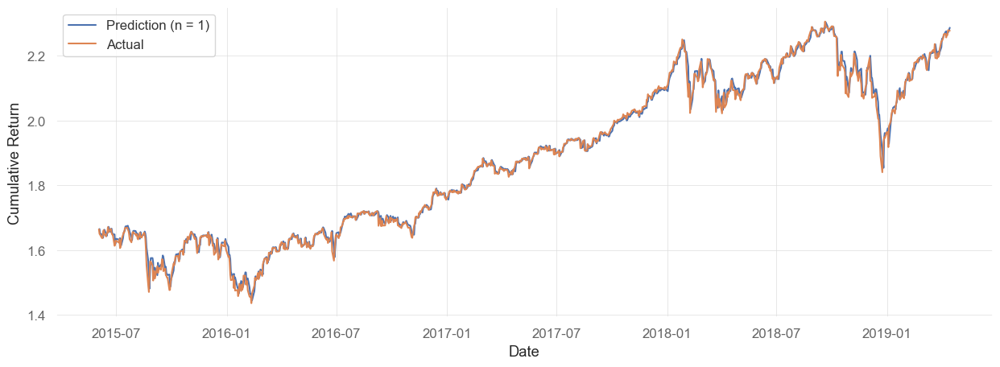

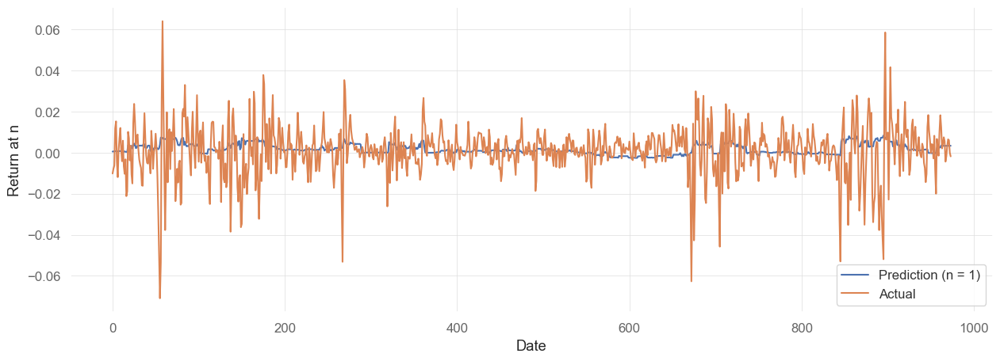

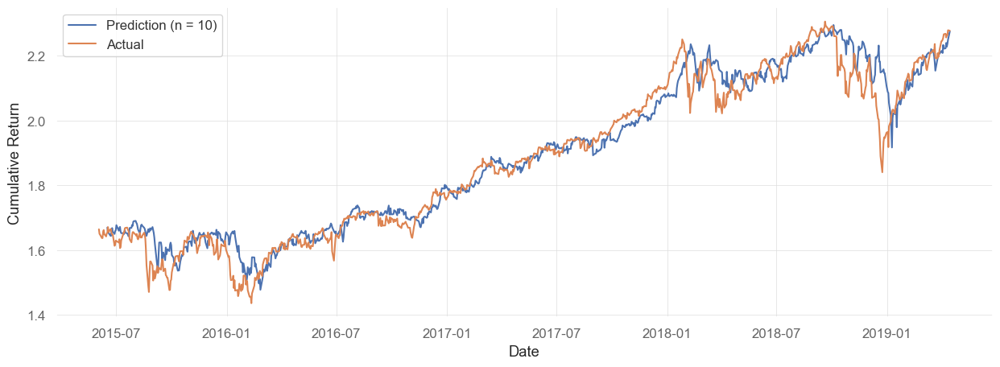

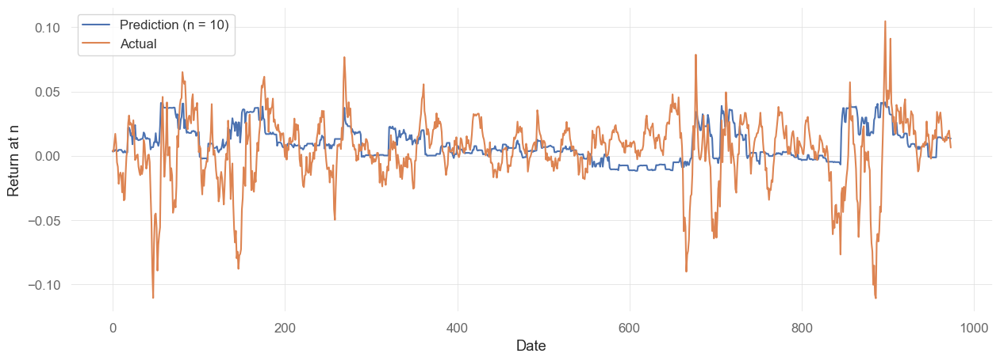

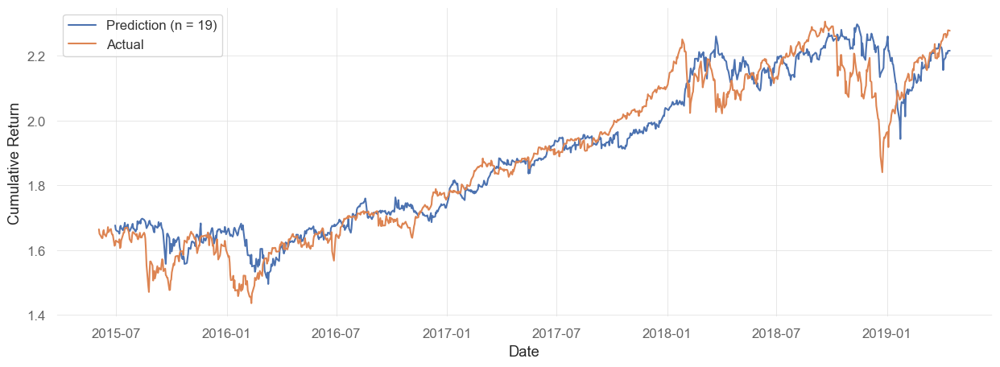

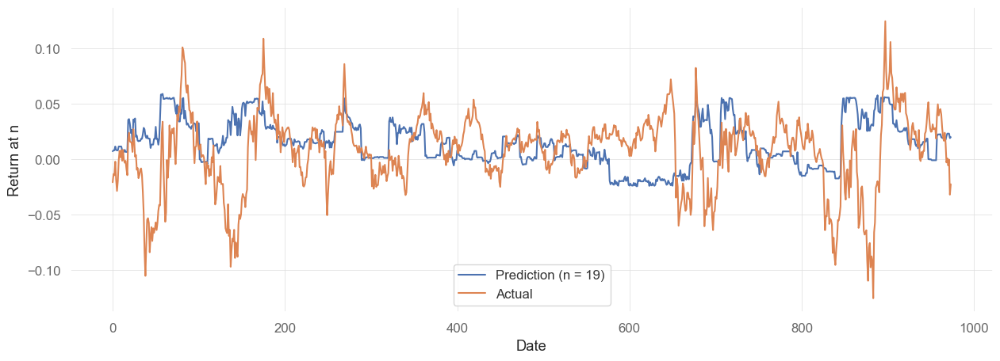

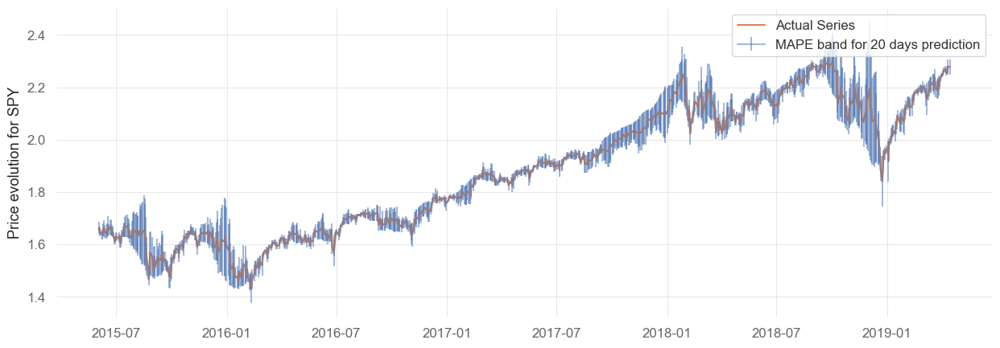

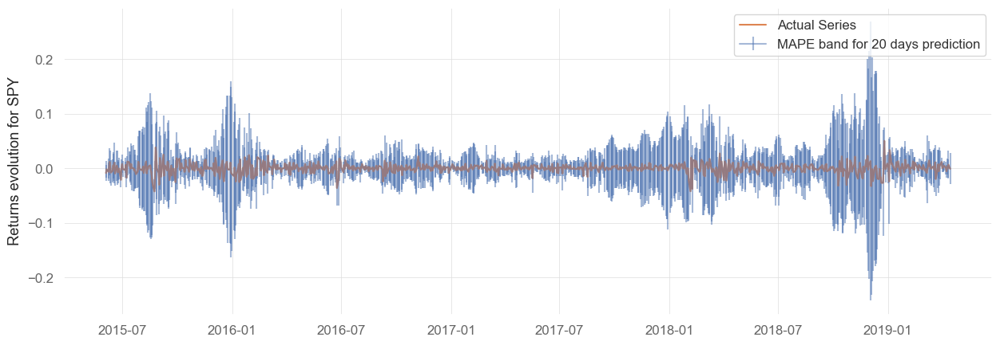

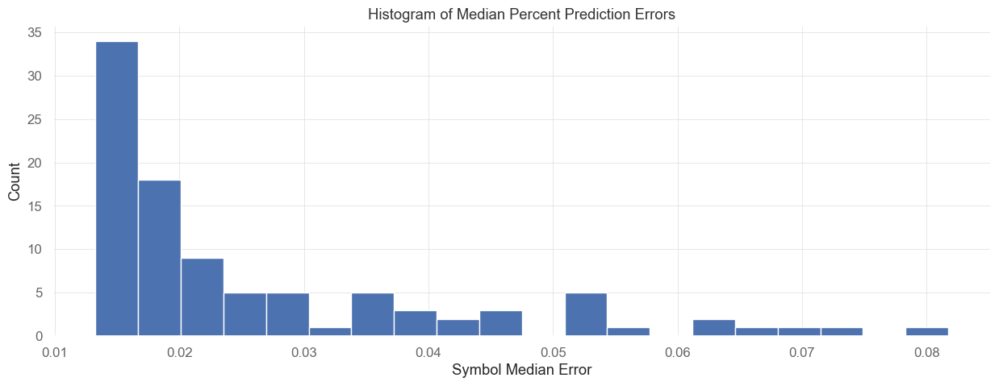

count    97.000000
mean      0.026615
std       0.015899
min       0.013272
25%       0.015276
50%       0.019034
75%       0.034917
max       0.081738
Name: 50%, dtype: float64
Median of Median Errors    0.019034
Mean of Median Errors      0.026615
Mean of Mean Errors        0.034867
dtype: float64
max_depth: 5, learning_rate: 0.01
------
Training BIB...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002845 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8589
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features: 44
[LightGBM] [Info] Start training from score 0.003317
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


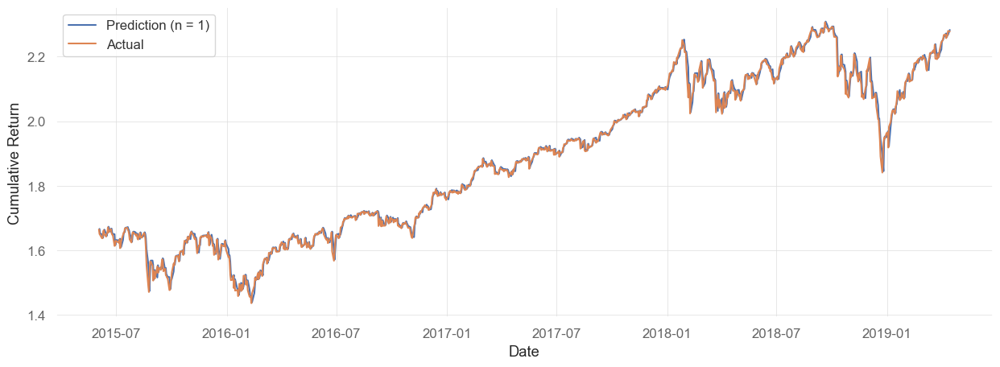

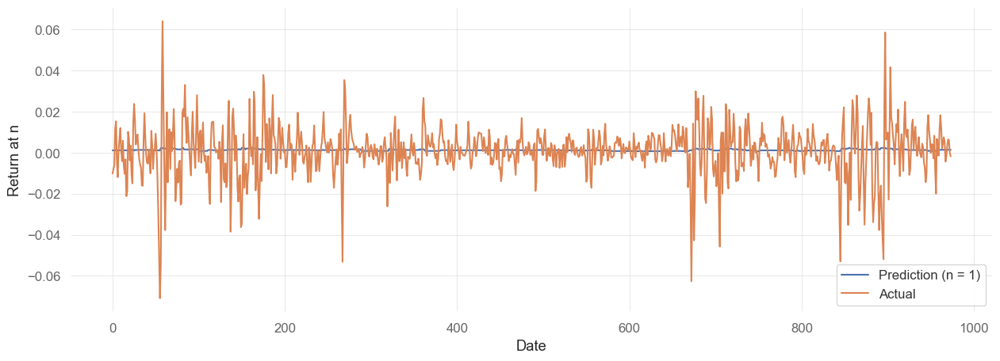

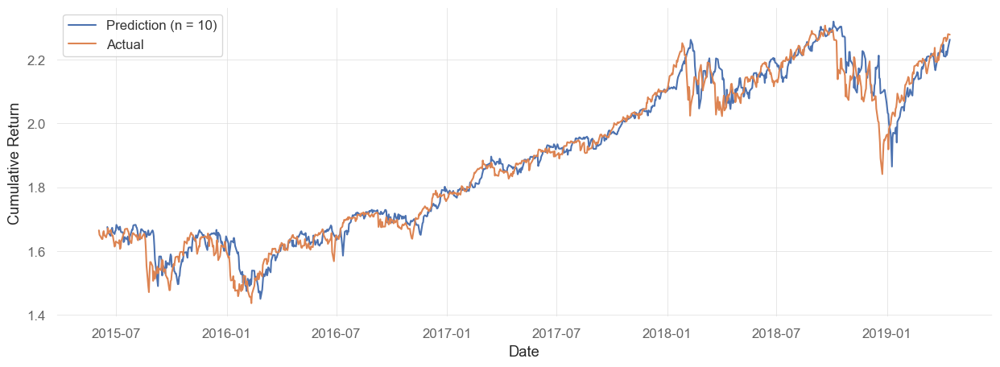

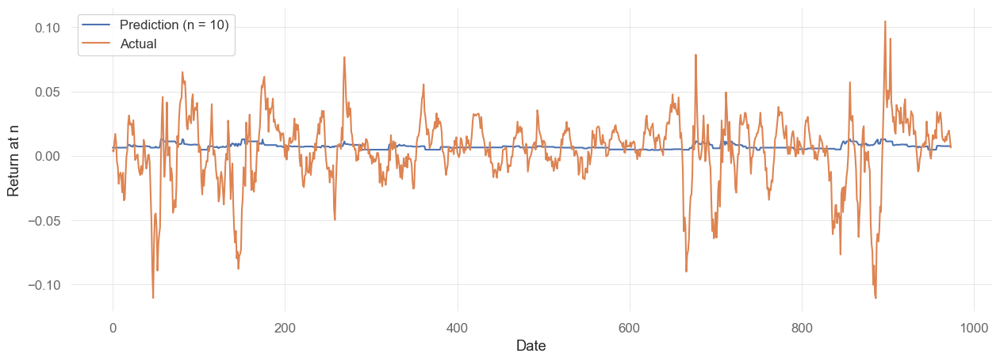

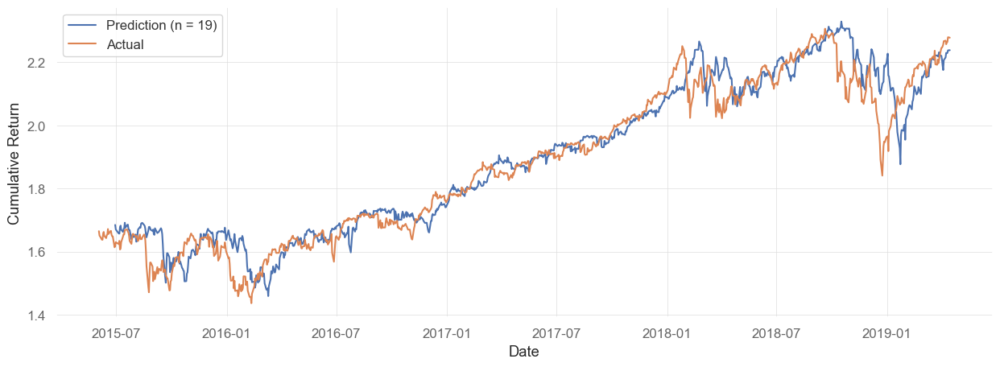

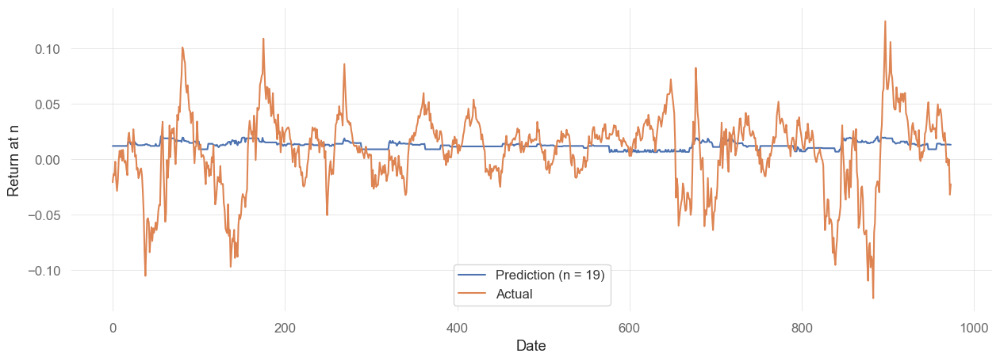

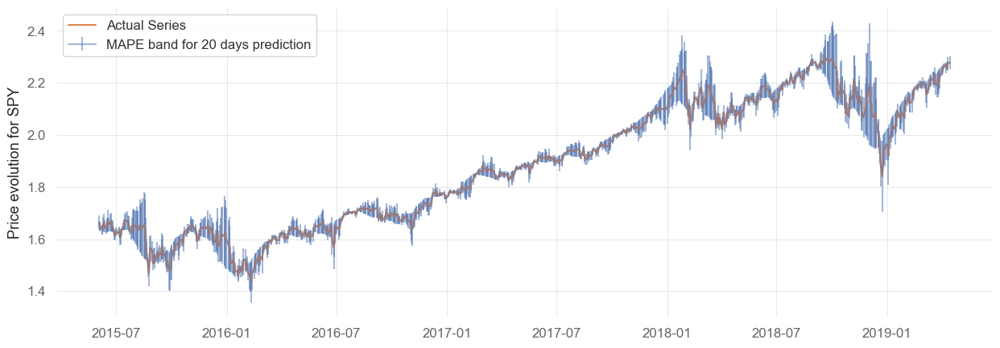

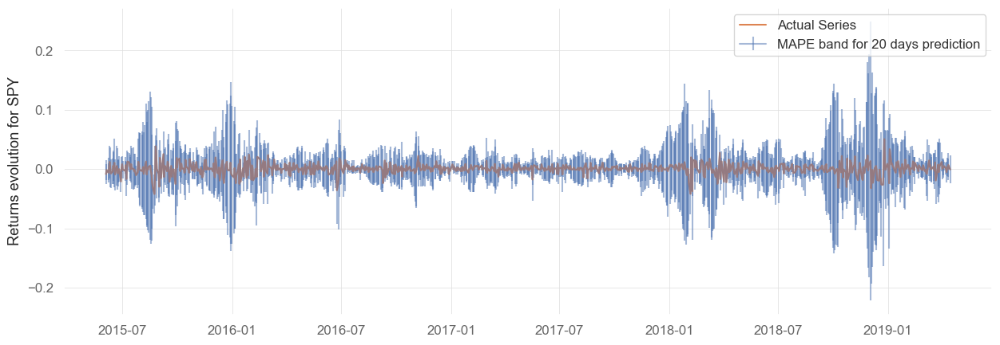

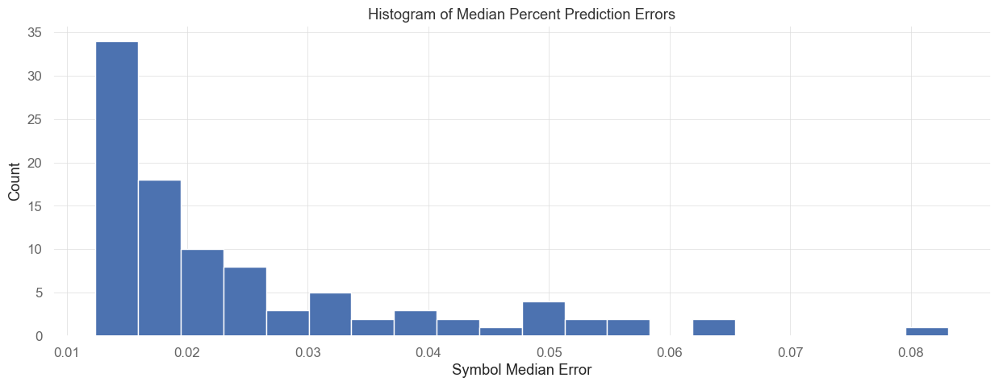

count    97.000000
mean      0.024503
std       0.014349
min       0.012395
25%       0.014372
50%       0.019124
75%       0.029173
max       0.083117
Name: 50%, dtype: float64
Median of Median Errors    0.019124
Mean of Median Errors      0.024503
Mean of Mean Errors        0.032010
dtype: float64
max_depth: 5, learning_rate: 0.001
------


In [ ]:
max_depth_vals = [-1, 2, 5]
learning_rate_vals = [0.9, 0.1, 0.01, 0.001]
df_results = None
for max_depth in max_depth_vals:
    for learning_rate in learning_rate_vals:
        lgbm_model = UnivariateLightGBMs(
            windows=[5, 20, 60, 180, 400],
            lgbm_hpts={"max_depth": max_depth, "learning_rate": learning_rate},
        )
        lgbm_model.fit(df_train.iloc[:i_predict_min])
        predictions_lgbm = lgbm_model.predict(
            df_train,
            n_steps_predict=w_size,
            index_start=i_predict_min,
            index_end=i_predict_max + 1,
        )
        ser_results = summary_analysis(
            df=df_train,
            n_predict=w_size,
            predictions=predictions_lgbm[:-1, :, :],
            actuals=actuals,
            index_start=i_predict_min,
            index_end=i_predict_max,
            symbol="SPY",
        )
        print(f"max_depth: {max_depth}, learning_rate: {learning_rate}")
        print("------")
        if df_results is None:
            df_results = pd.DataFrame(ser_results).T
            df_results["max_depth"] = max_depth
            df_results["learning_rate"] = learning_rate
        else:
            df_res = pd.DataFrame(ser_results).T
            df_res["max_depth"] = max_depth
            df_res["learning_rate"] = learning_rate
            df_results = pd.concat([df_results, df_res], axis=0).reset_index(drop=True)
df_results.to_csv("results_lightgbm.csv")

Training BIB...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003268 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8589
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features: 44
[LightGBM] [Info] Start training from score 0.003317
Training CSM...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003936 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8617
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features: 44
[LightGBM] [Info] Start training from score 0.000691
Training CURE...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001587 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8582
[LightGBM] [Info] Number of data points in the train set: 11500, number

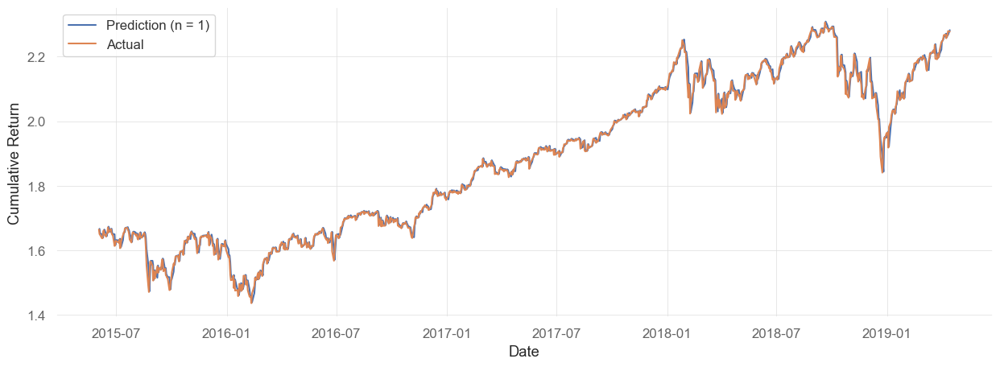

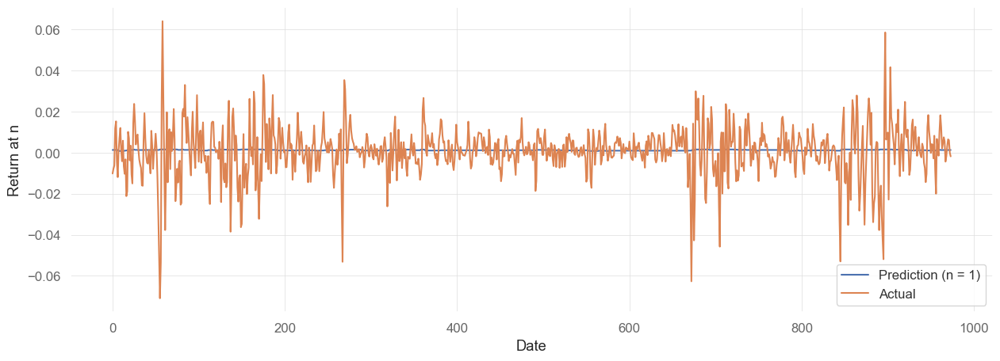

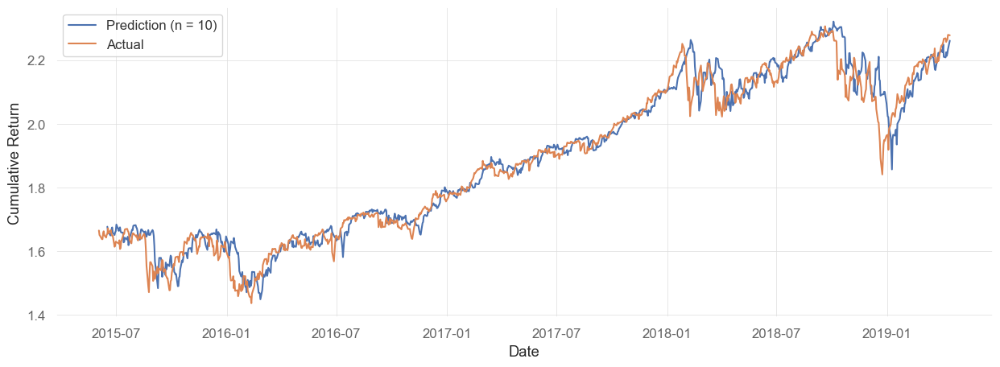

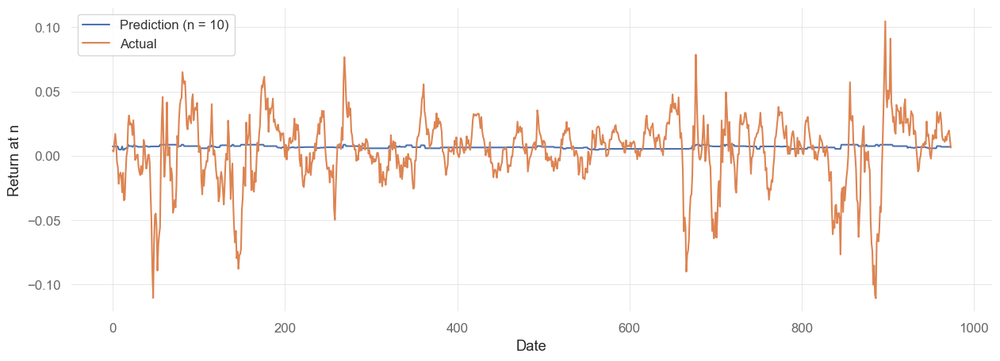

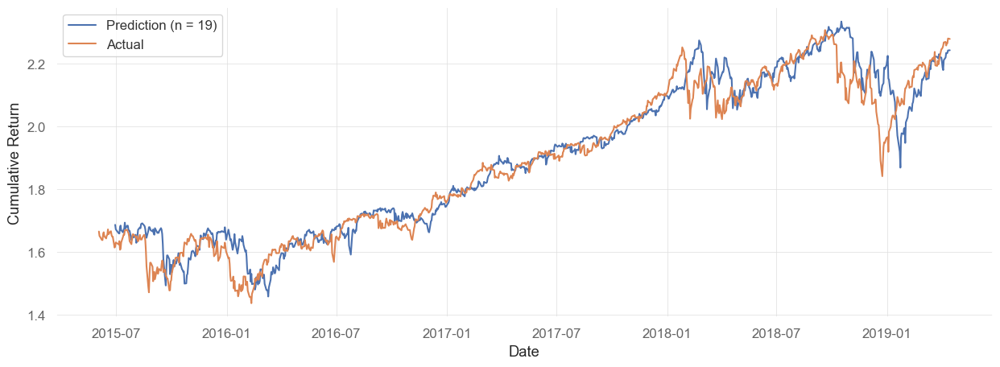

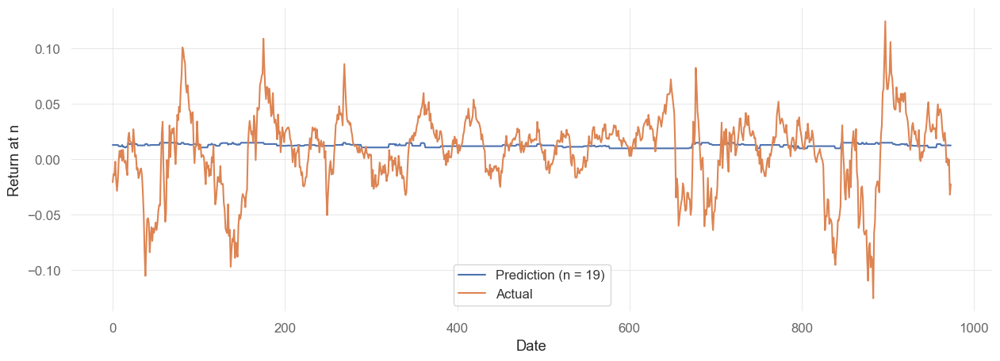

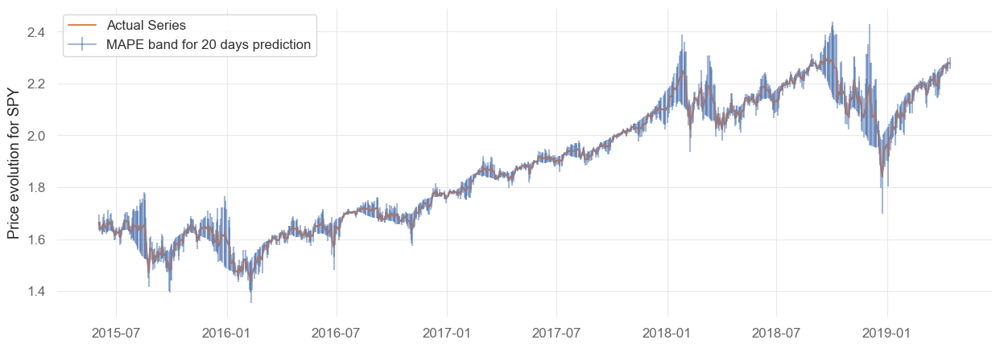

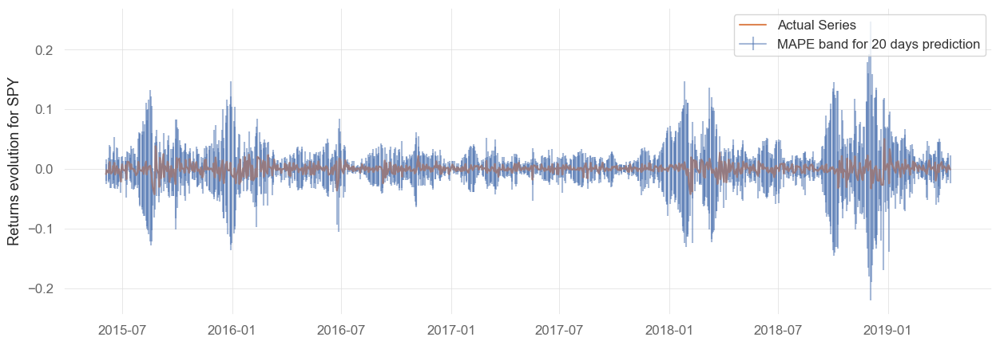

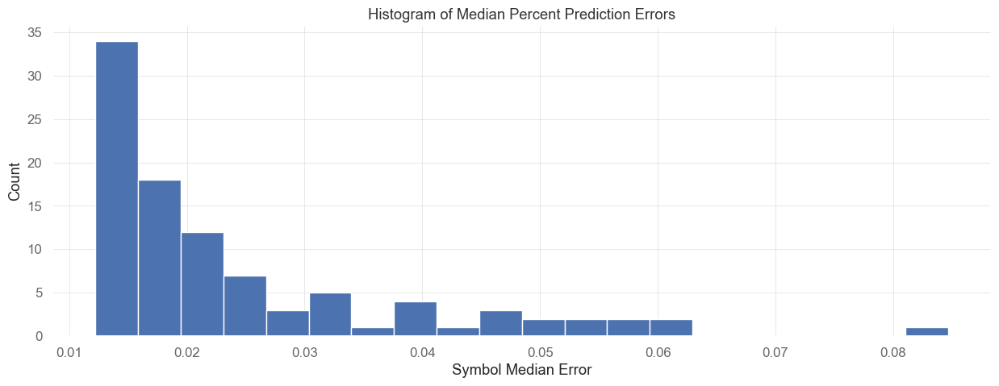

count    97.000000
mean      0.024445
std       0.014379
min       0.012234
25%       0.014231
50%       0.019303
75%       0.028354
max       0.084684
Name: 50%, dtype: float64
Median of Median Errors    0.019303
Mean of Median Errors      0.024445
Mean of Mean Errors        0.031922
dtype: float64
max_depth: -1, learning_rate: 0.0005
------
Training BIB...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002476 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8589
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features: 44
[LightGBM] [Info] Start training from score 0.003317
Training CSM...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002487 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8617
[LightGBM] [Info] Number of data points in the train set: 11500, number of used featu

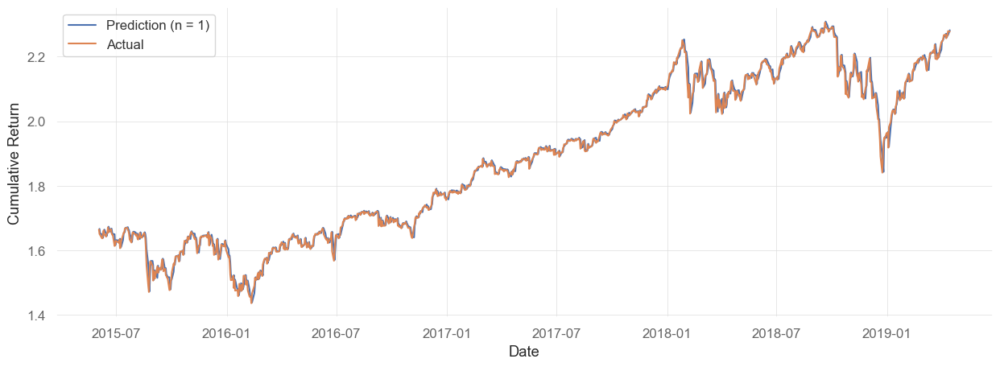

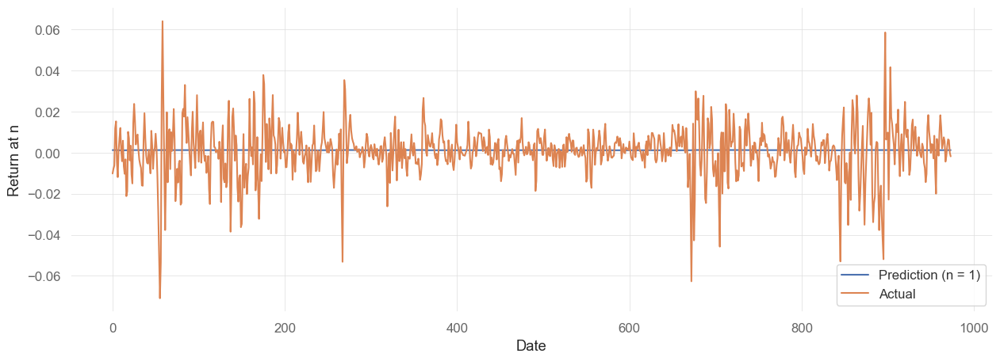

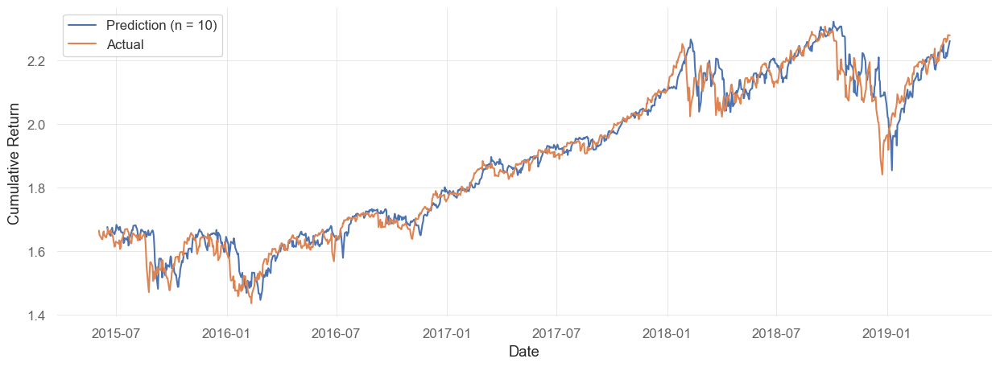

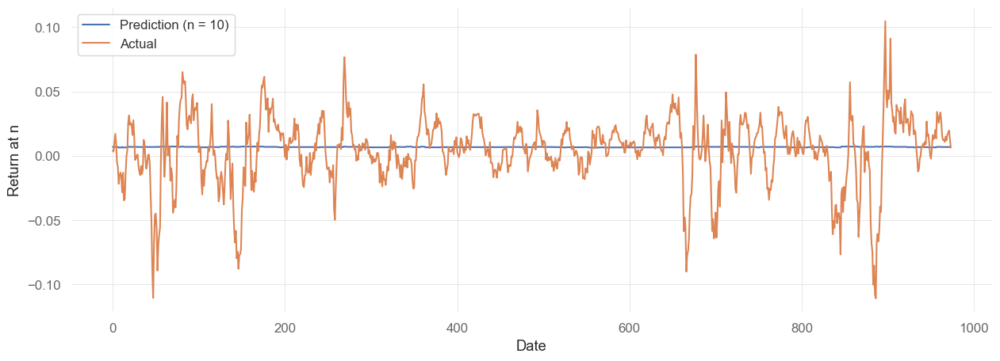

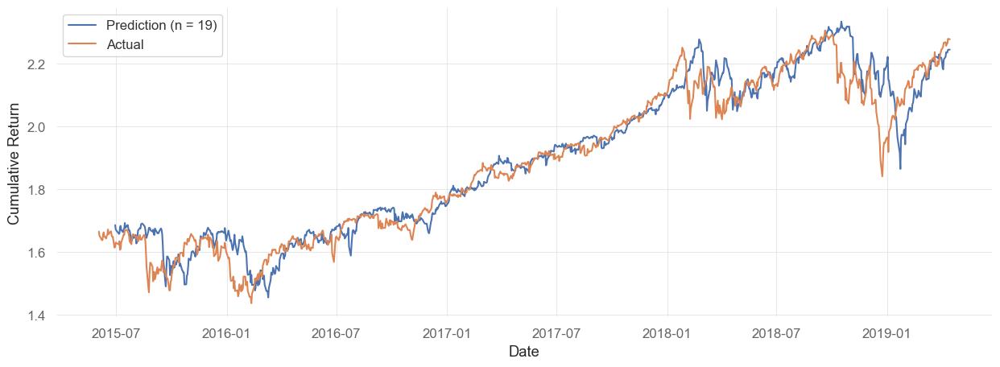

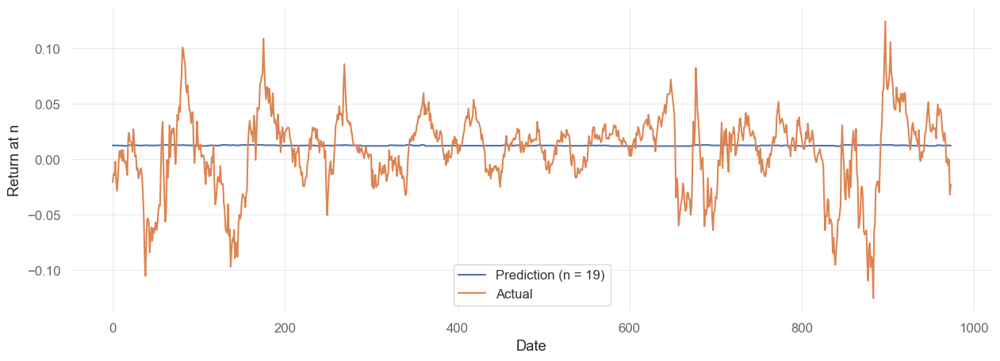

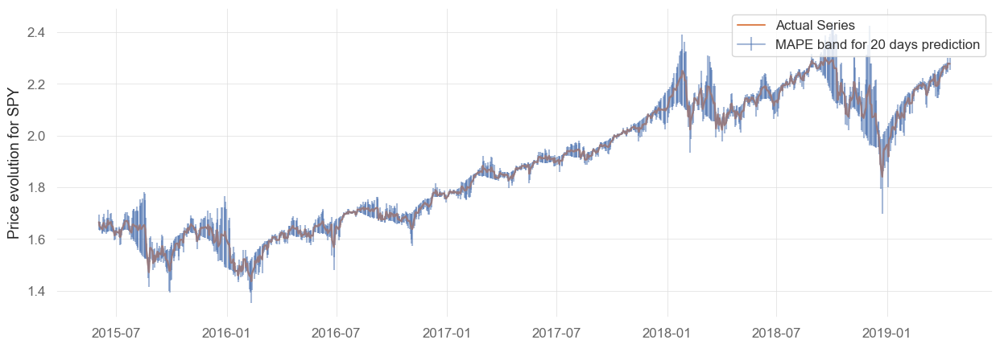

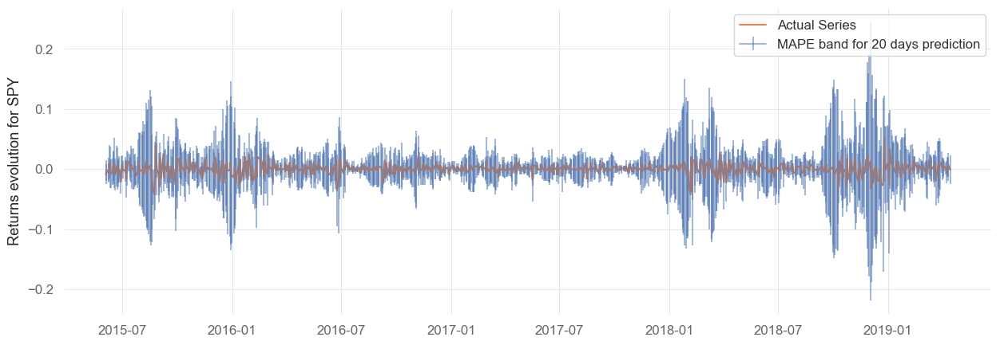

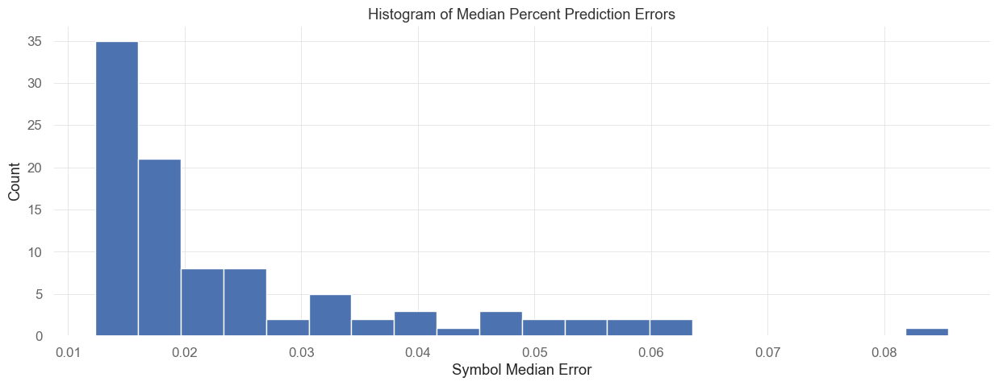

count    97.000000
mean      0.024407
std       0.014369
min       0.012365
25%       0.014338
50%       0.019349
75%       0.028365
max       0.085496
Name: 50%, dtype: float64
Median of Median Errors    0.019349
Mean of Median Errors      0.024407
Mean of Mean Errors        0.031883
dtype: float64
max_depth: -1, learning_rate: 0.0001
------
Training BIB...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002810 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8589
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features: 44
[LightGBM] [Info] Start training from score 0.003317
Training CSM...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002841 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8617
[LightGBM] [Info] Number of data points in the train set: 11500, number of used featu

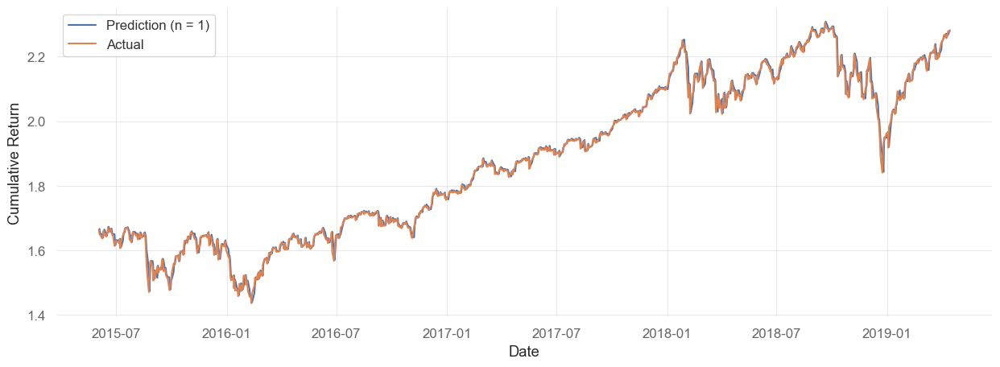

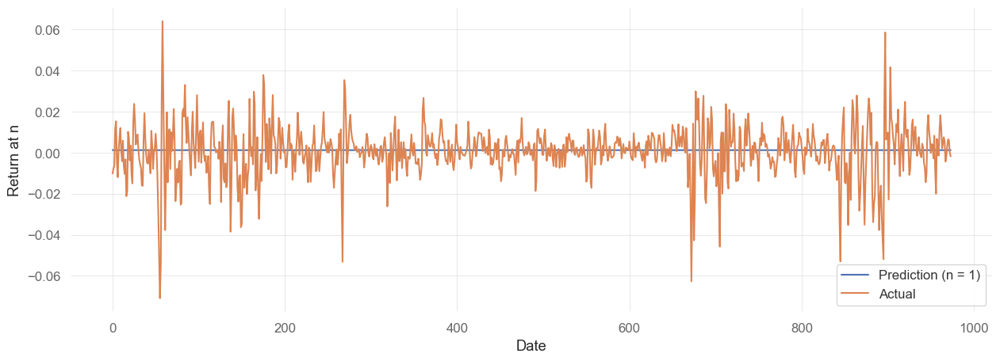

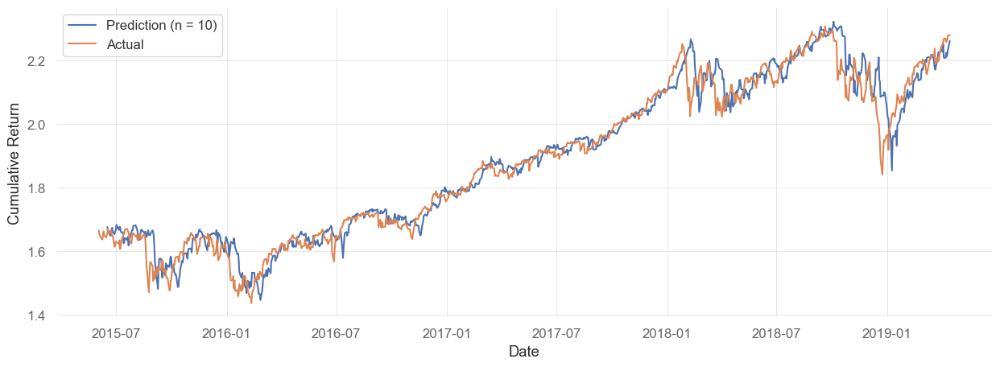

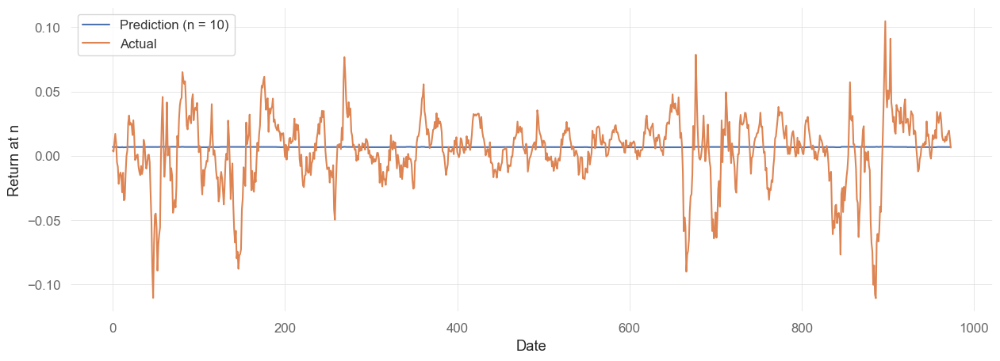

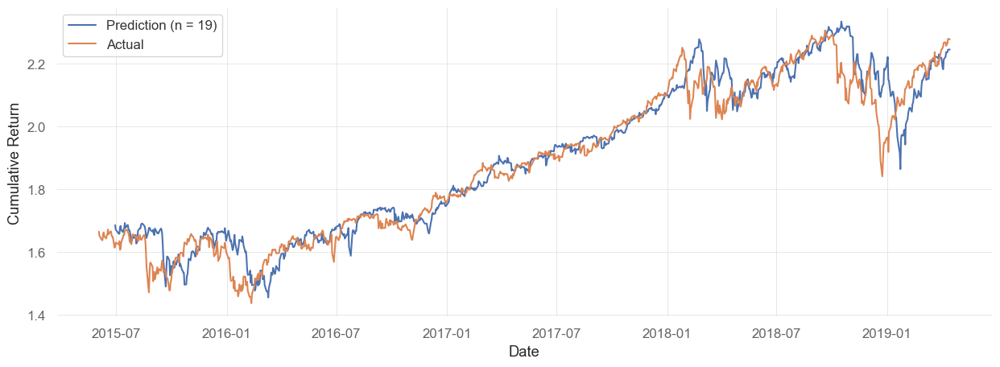

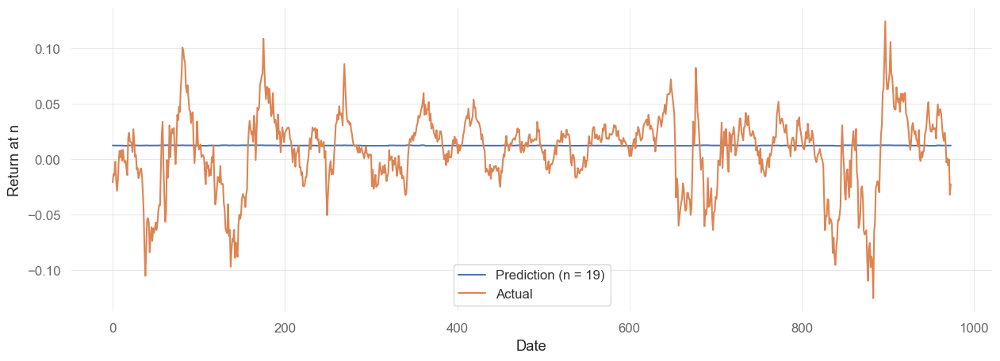

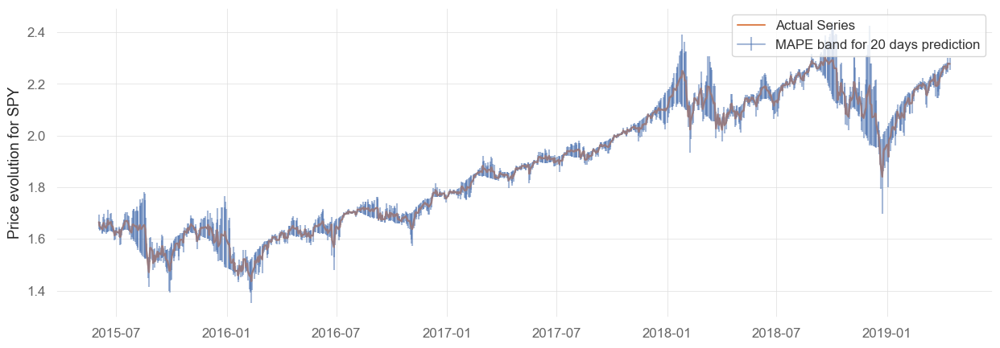

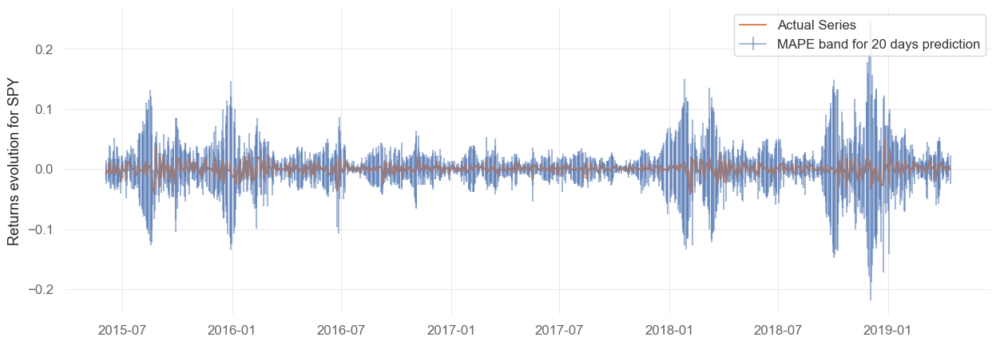

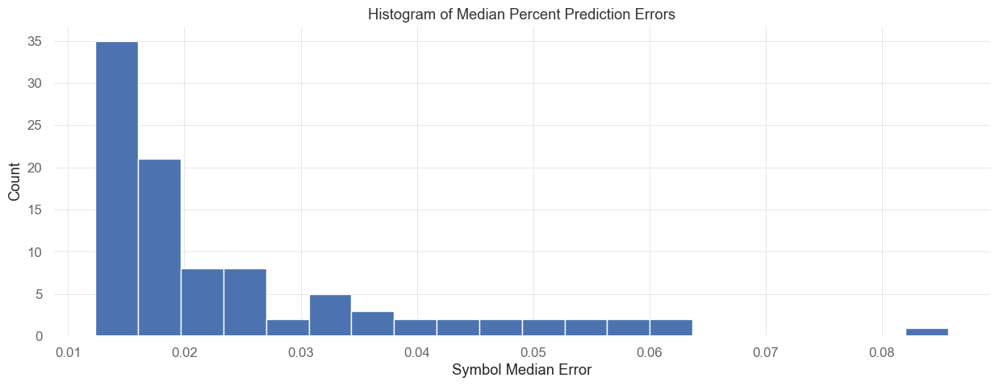

count    97.000000
mean      0.024406
std       0.014374
min       0.012351
25%       0.014307
50%       0.019355
75%       0.028422
max       0.085732
Name: 50%, dtype: float64
Median of Median Errors    0.019355
Mean of Median Errors      0.024406
Mean of Mean Errors        0.031881
dtype: float64
max_depth: -1, learning_rate: 5e-05
------


In [8]:
learning_rate_vals = [0.0005, 0.0001, 0.00005]
df_results = None
for max_depth in [-1]:
    for learning_rate in learning_rate_vals:
        lgbm_model = UnivariateLightGBMs(
            windows=[5, 20, 60, 180, 400],
            lgbm_hpts={"max_depth": max_depth, "learning_rate": learning_rate},
        )
        lgbm_model.fit(df_train.iloc[:i_predict_min])
        predictions_lgbm = lgbm_model.predict(
            df_train,
            n_steps_predict=w_size,
            index_start=i_predict_min,
            index_end=i_predict_max + 1,
        )
        ser_results = summary_analysis(
            df=df_train,
            n_predict=w_size,
            predictions=predictions_lgbm[:-1, :, :],
            actuals=actuals,
            index_start=i_predict_min,
            index_end=i_predict_max,
            symbol="SPY",
        )
        print(f"max_depth: {max_depth}, learning_rate: {learning_rate}")
        print("------")
        if df_results is None:
            df_results = pd.DataFrame(ser_results).T
            df_results["max_depth"] = max_depth
            df_results["learning_rate"] = learning_rate
        else:
            df_res = pd.DataFrame(ser_results).T
            df_res["max_depth"] = max_depth
            df_res["learning_rate"] = learning_rate
            df_results = pd.concat([df_results, df_res], axis=0).reset_index(drop=True)
df_results.to_csv("results_lightgb2.csv")

Training BIB...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003089 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8589
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features: 44
[LightGBM] [Info] Start training from score 0.003317
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits wit

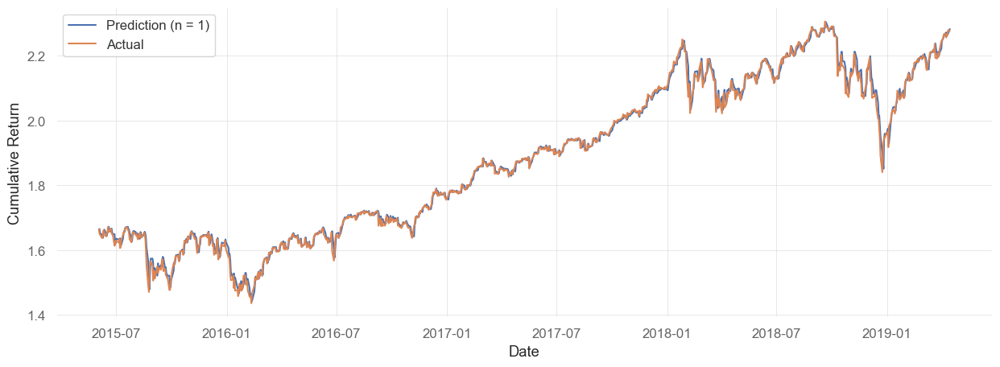

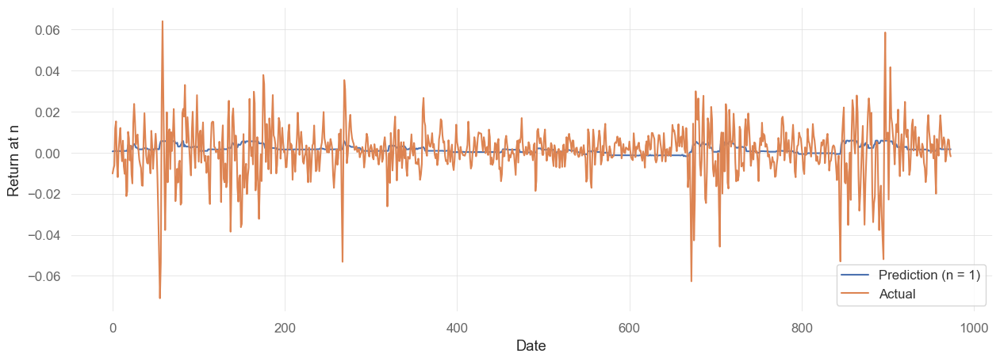

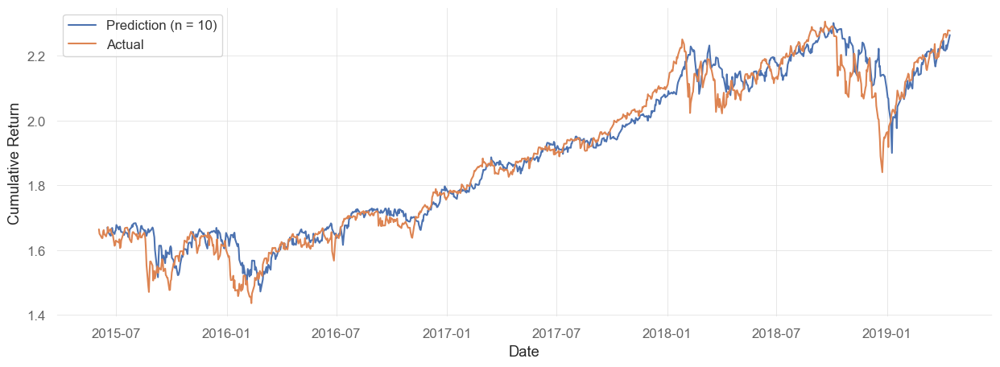

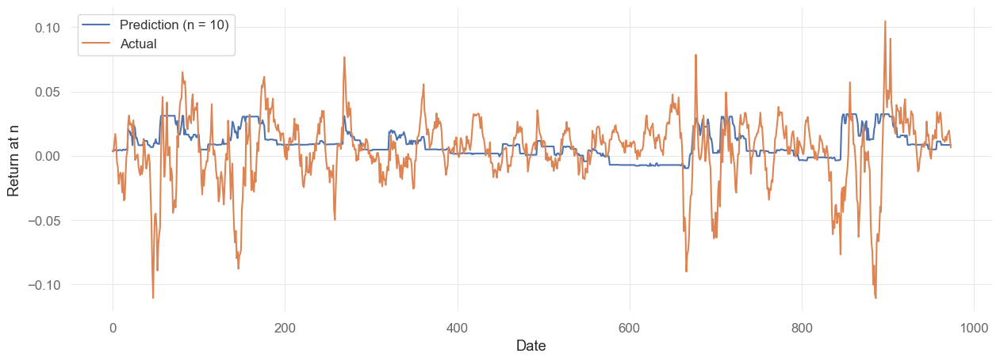

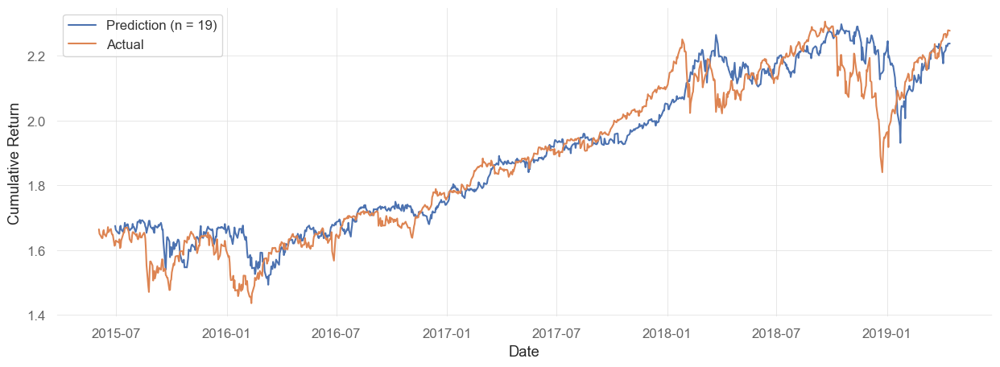

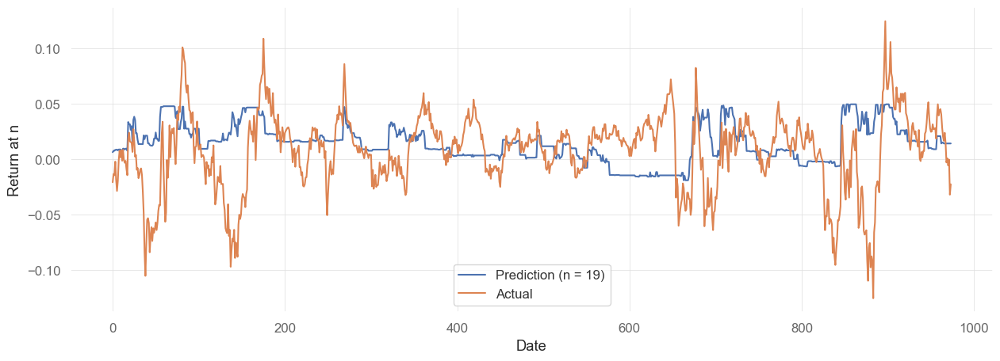

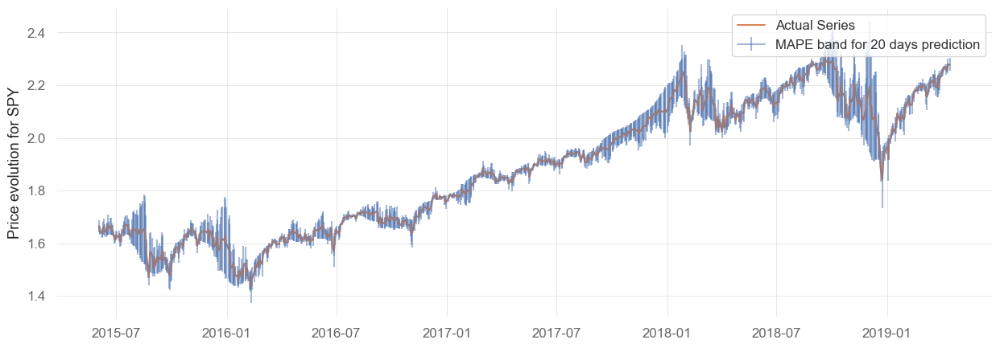

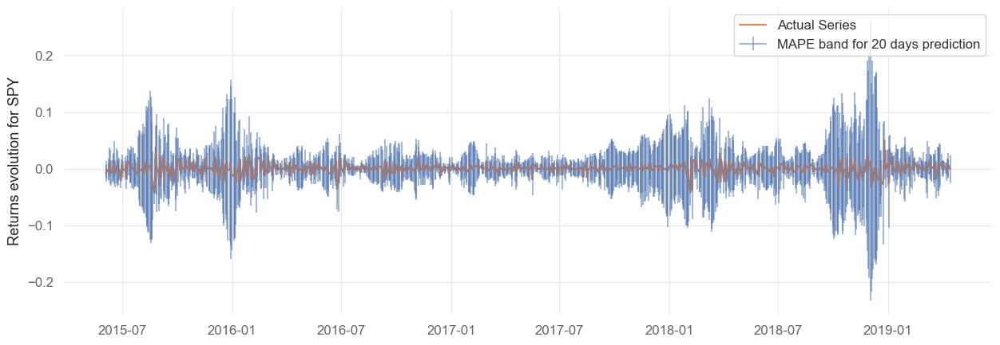

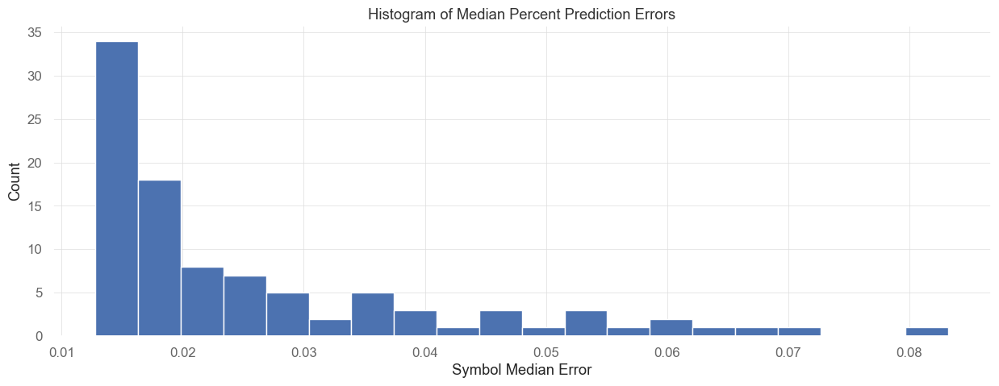

count    97.000000
mean      0.025926
std       0.015459
min       0.012795
25%       0.015005
50%       0.018792
75%       0.031129
max       0.083235
Name: 50%, dtype: float64
Median of Median Errors    0.018792
Mean of Median Errors      0.025926
Mean of Mean Errors        0.033788
dtype: float64
max_depth: 3, learning_rate: 0.01
------
Training BIB...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002838 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8589
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features: 44
[LightGBM] [Info] Start training from score 0.003317
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


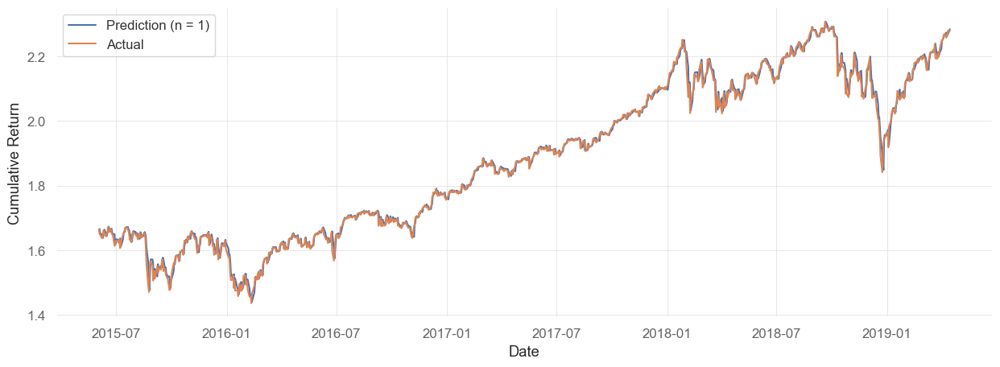

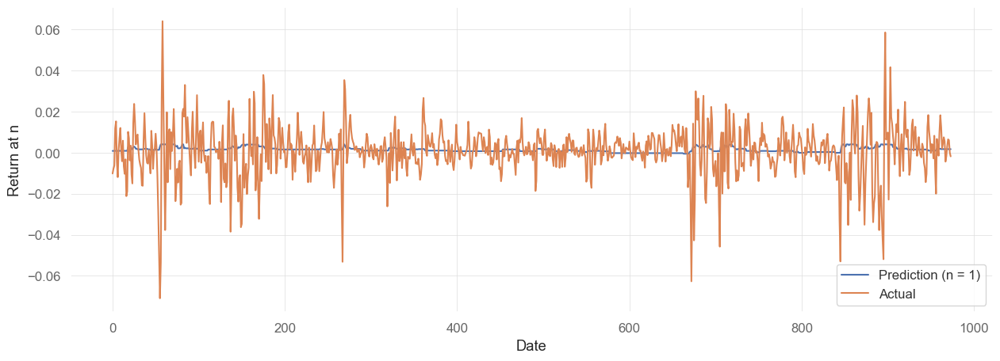

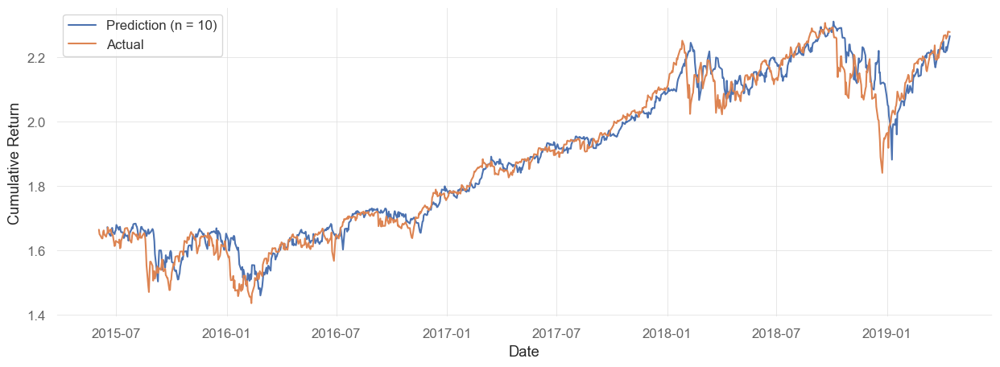

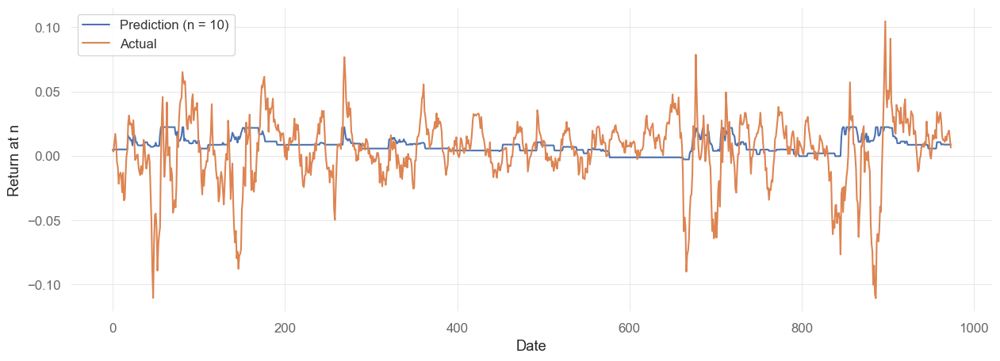

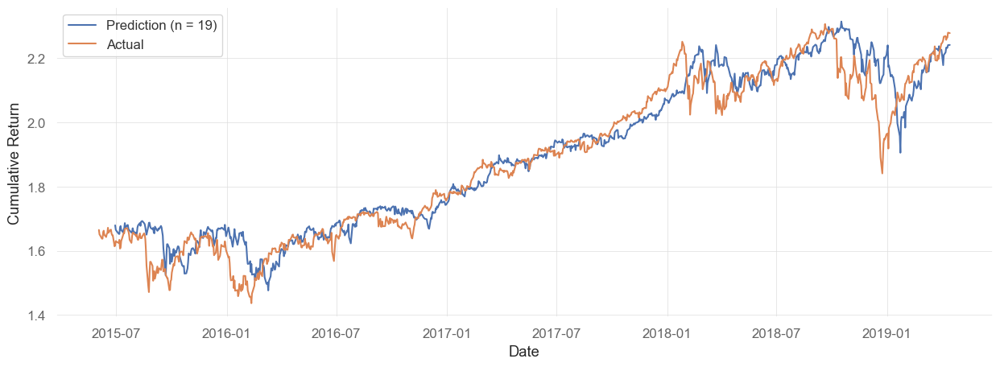

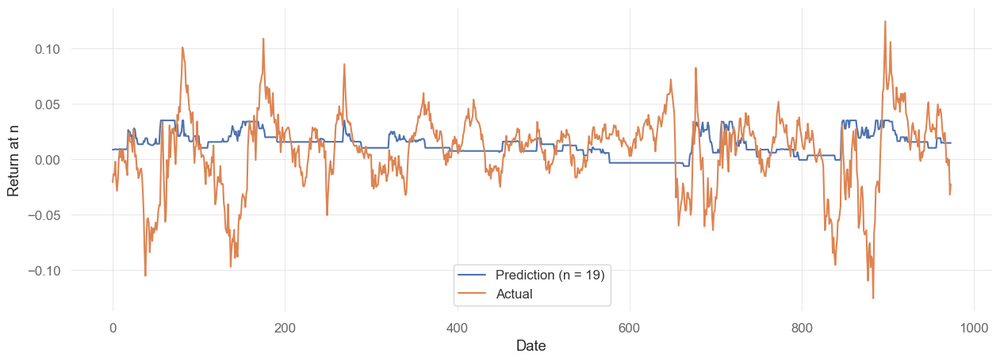

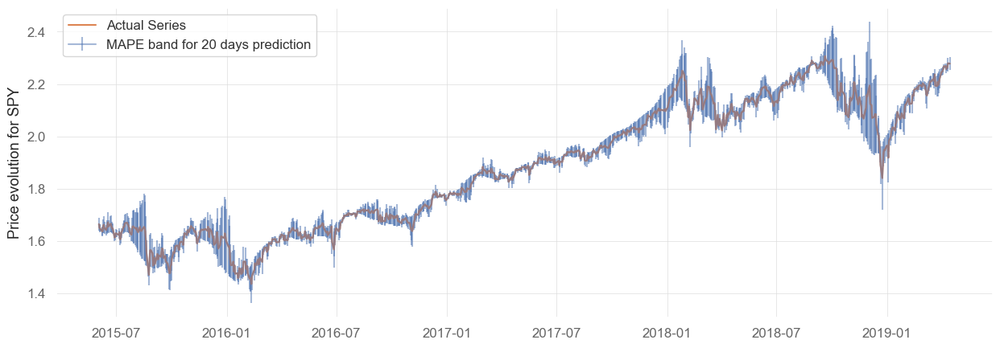

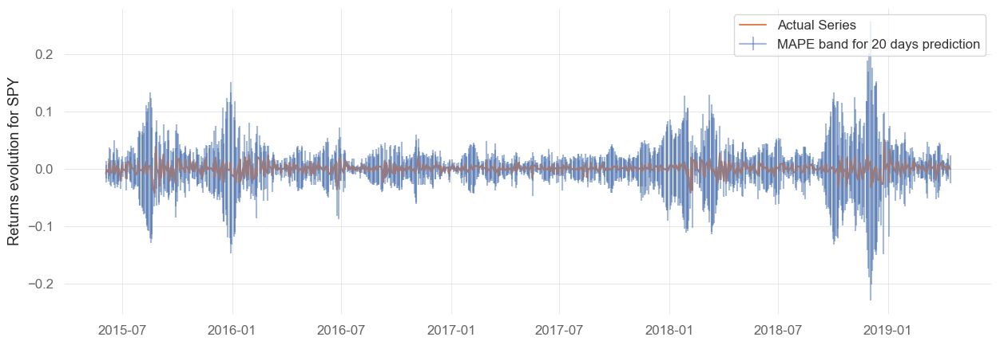

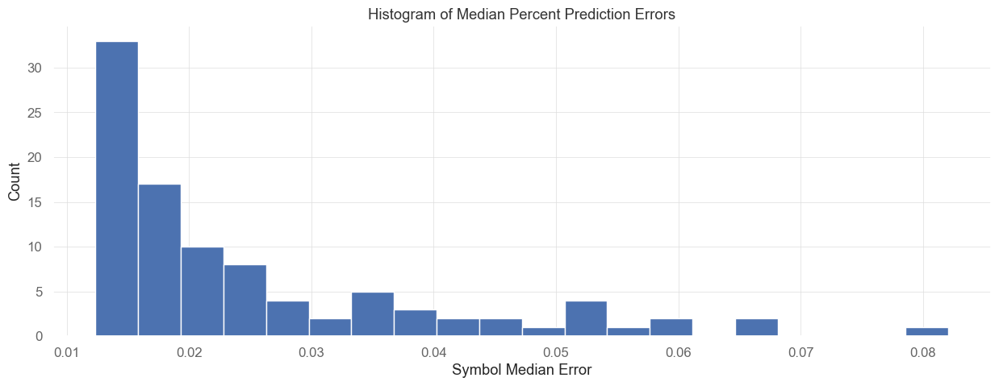

count    97.000000
mean      0.025152
std       0.014825
min       0.012362
25%       0.014551
50%       0.019110
75%       0.030265
max       0.082073
Name: 50%, dtype: float64
Median of Median Errors    0.019110
Mean of Median Errors      0.025152
Mean of Mean Errors        0.032772
dtype: float64
max_depth: 3, learning_rate: 0.005
------
Training BIB...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002480 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8589
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features: 44
[LightGBM] [Info] Start training from score 0.003317
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

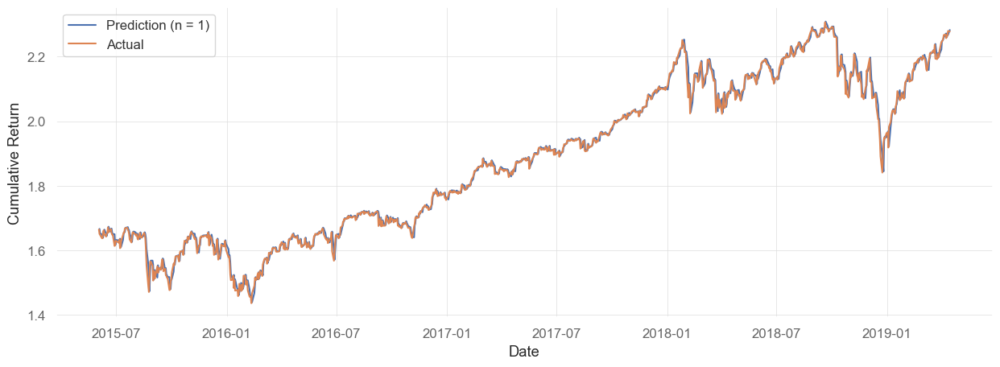

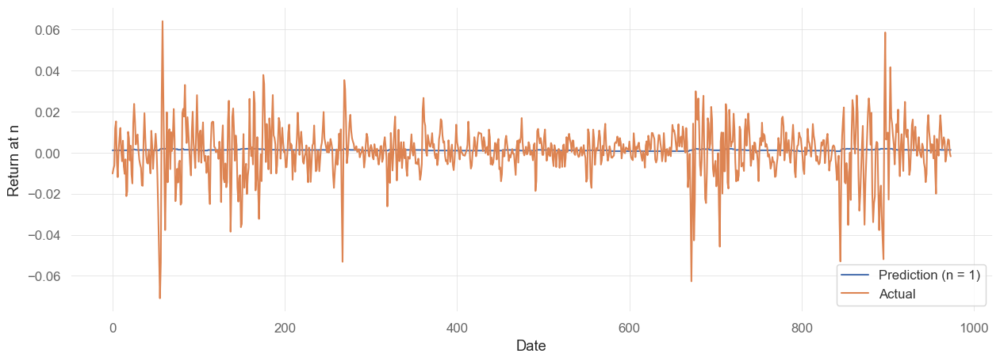

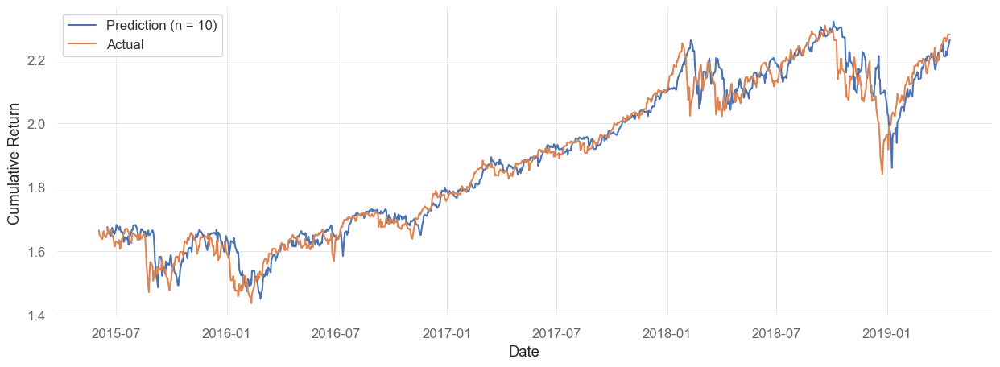

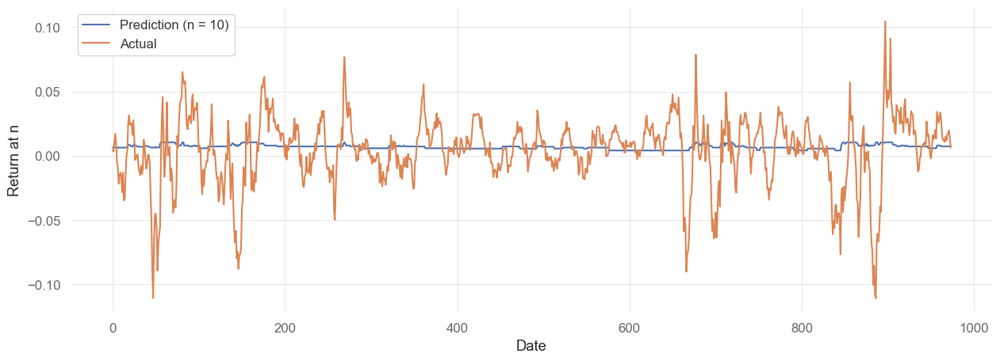

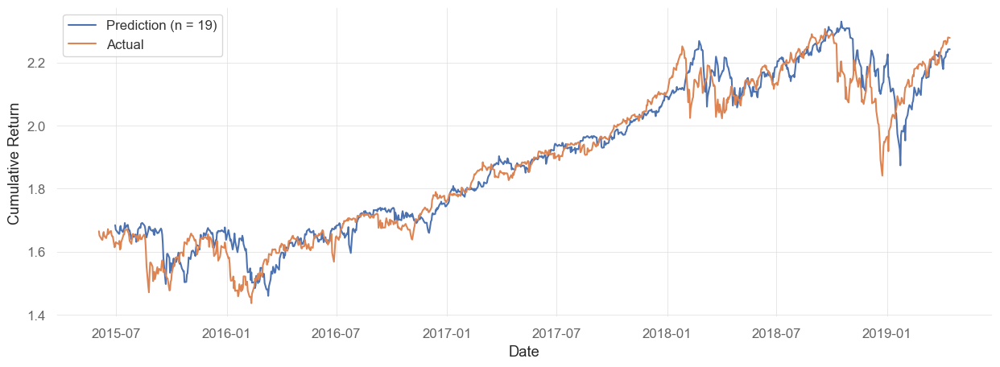

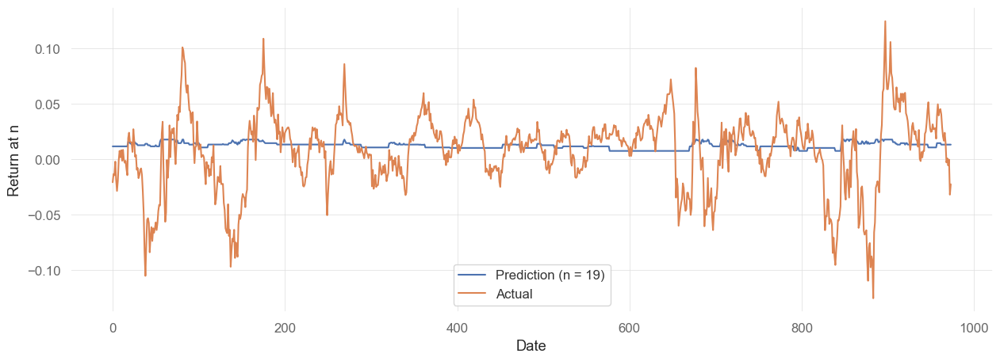

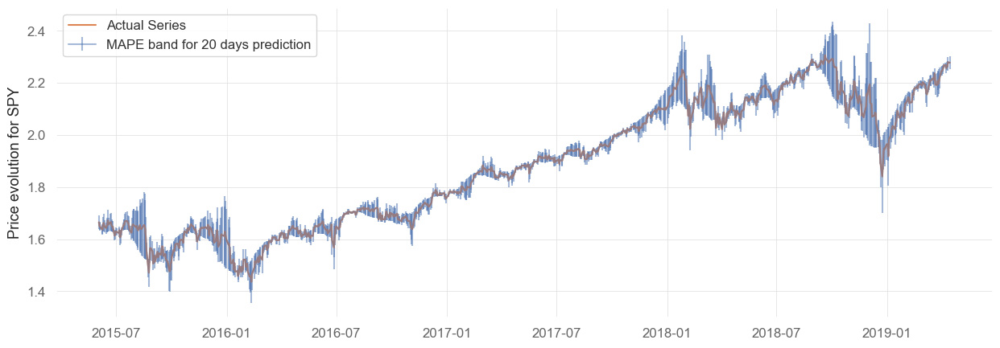

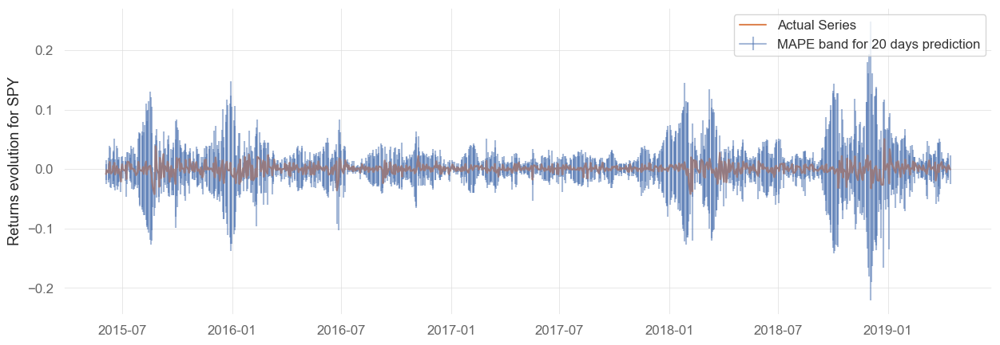

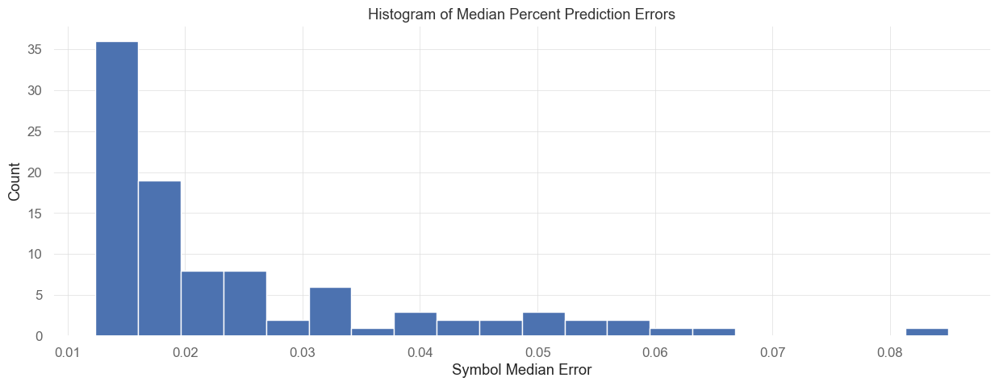

count    97.000000
mean      0.024506
std       0.014451
min       0.012379
25%       0.014275
50%       0.019172
75%       0.028577
max       0.084963
Name: 50%, dtype: float64
Median of Median Errors    0.019172
Mean of Median Errors      0.024506
Mean of Mean Errors        0.031973
dtype: float64
max_depth: 3, learning_rate: 0.001
------
Training BIB...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002320 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8589
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features: 44
[LightGBM] [Info] Start training from score 0.003317
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

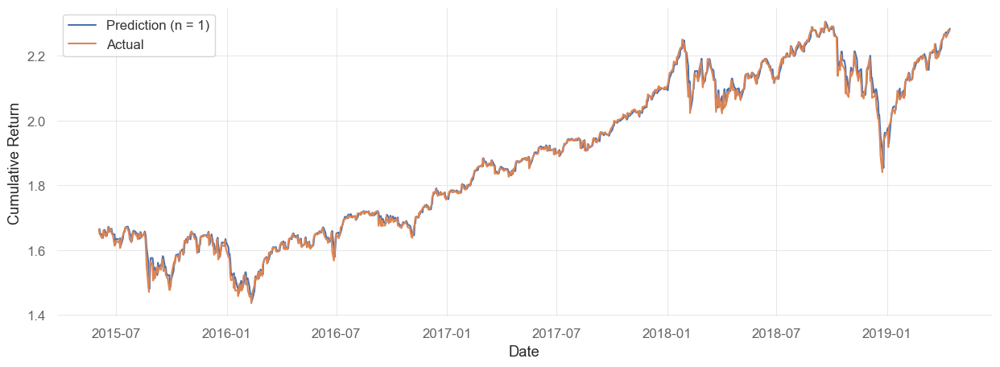

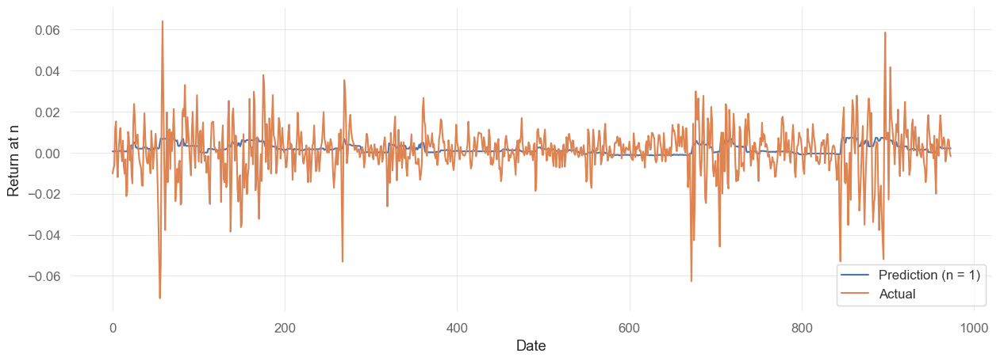

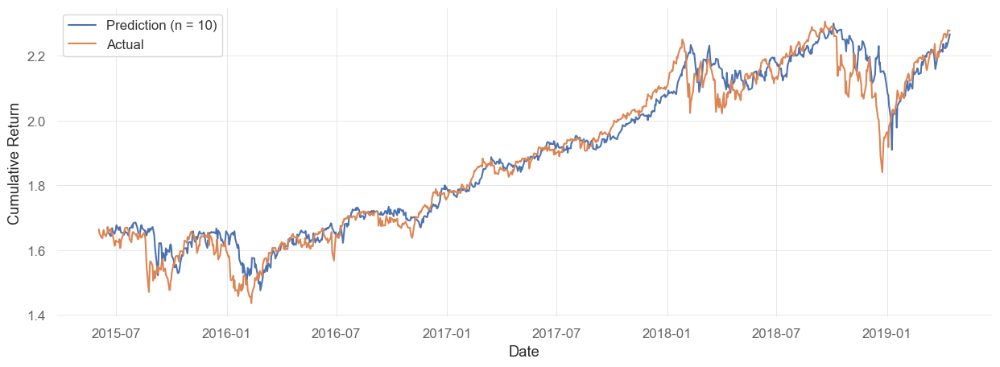

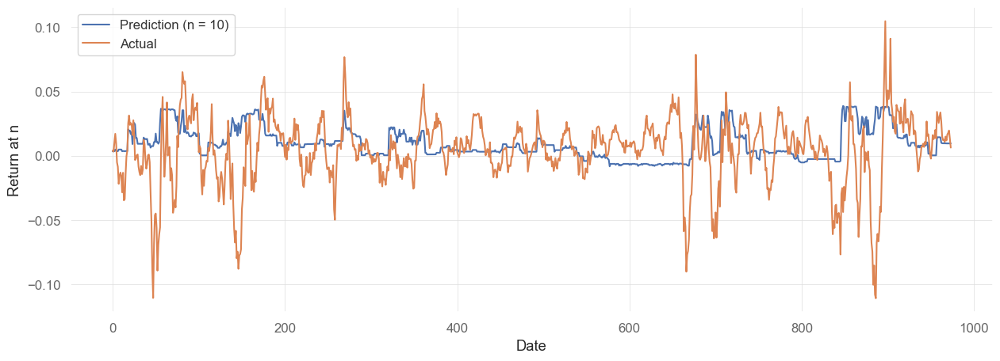

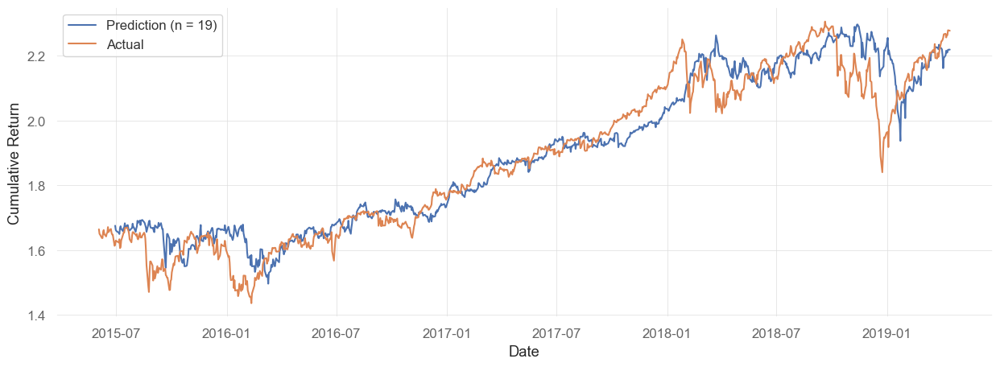

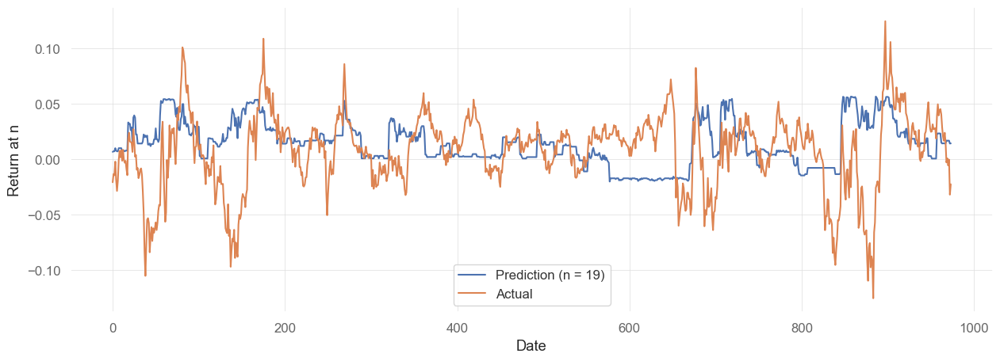

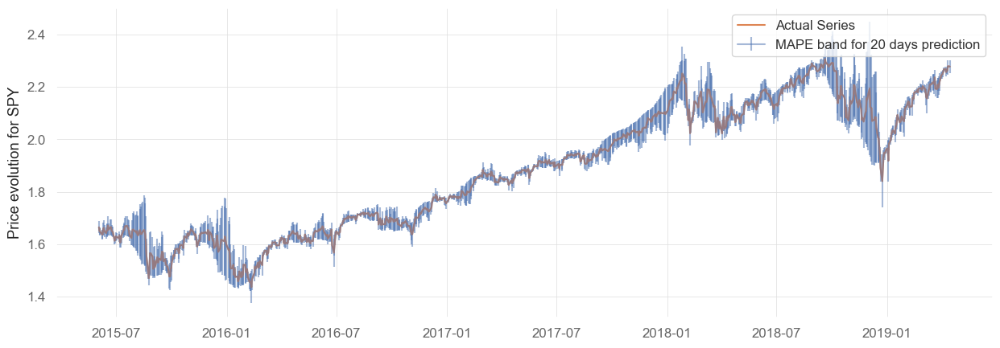

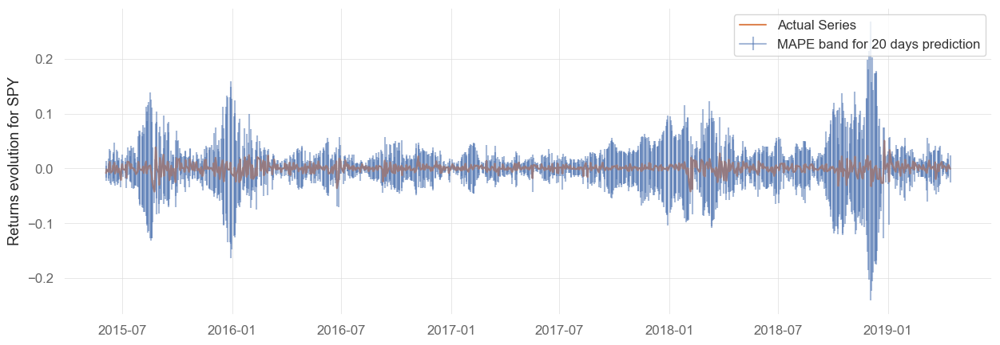

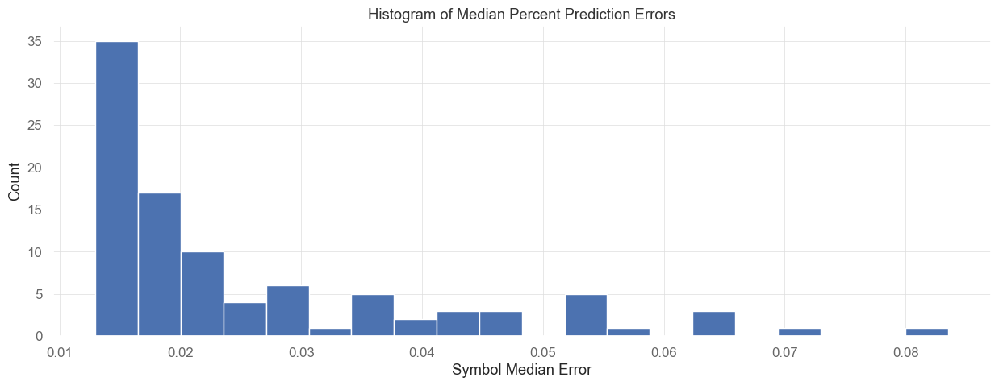

count    97.000000
mean      0.026188
std       0.015645
min       0.012986
25%       0.015202
50%       0.018854
75%       0.031346
max       0.083537
Name: 50%, dtype: float64
Median of Median Errors    0.018854
Mean of Median Errors      0.026188
Mean of Mean Errors        0.034289
dtype: float64
max_depth: 4, learning_rate: 0.01
------
Training BIB...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002523 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8589
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features: 44
[LightGBM] [Info] Start training from score 0.003317
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


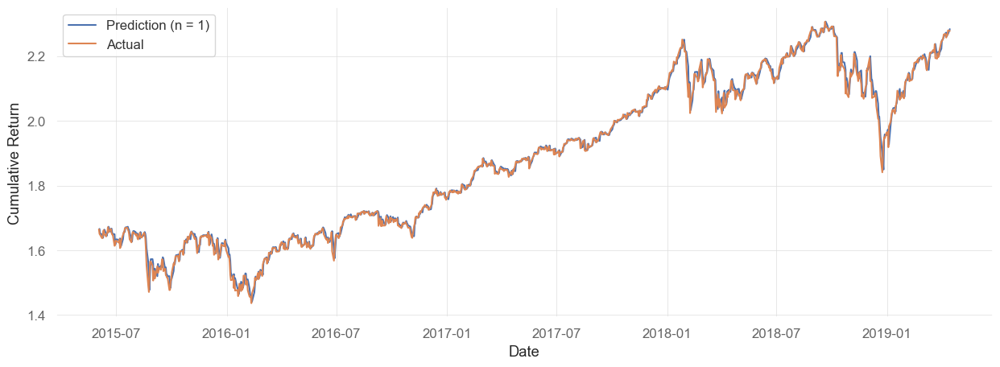

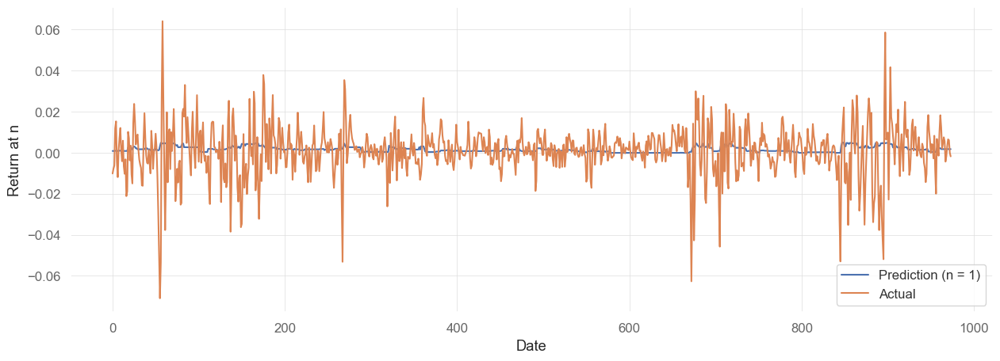

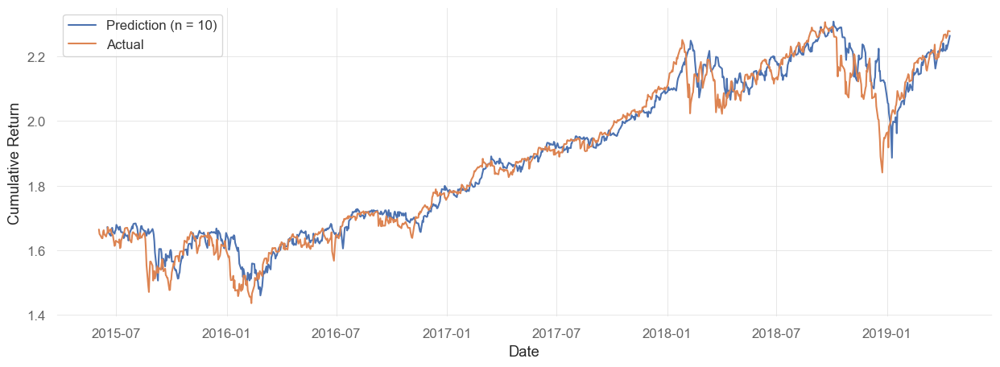

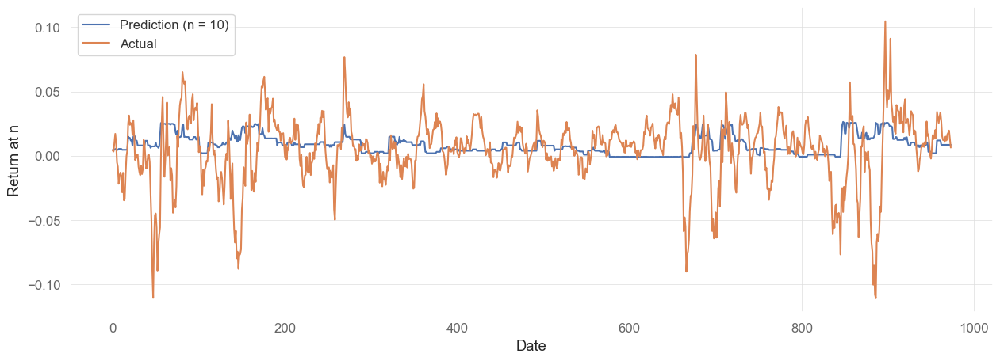

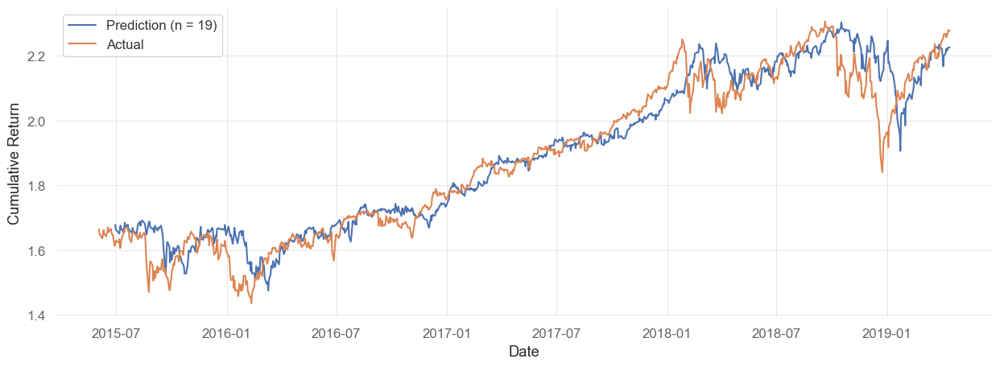

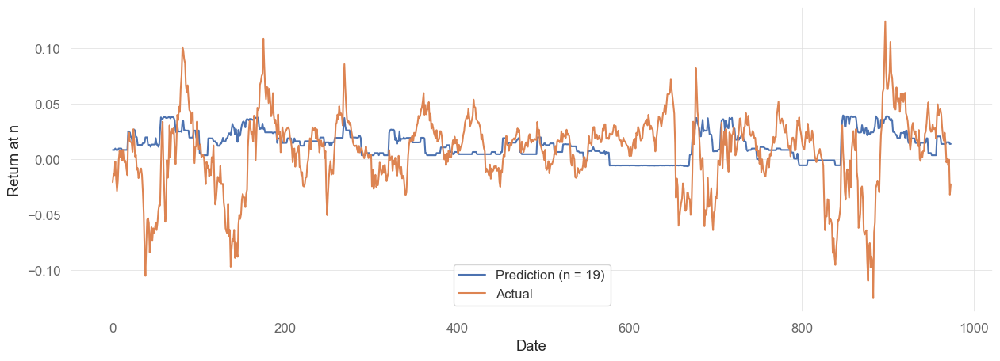

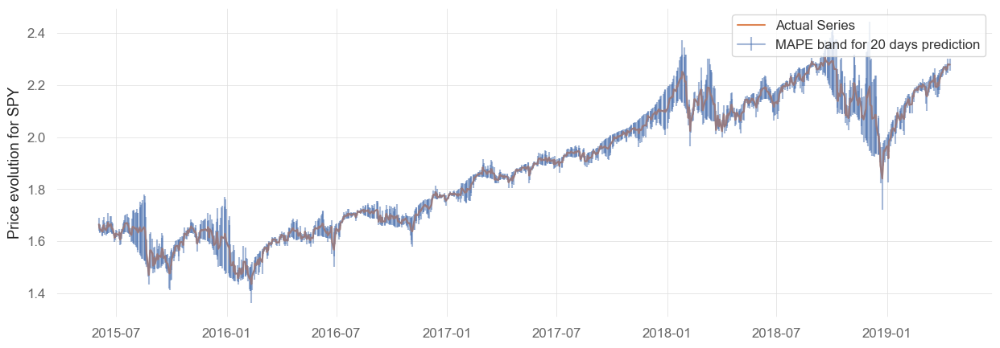

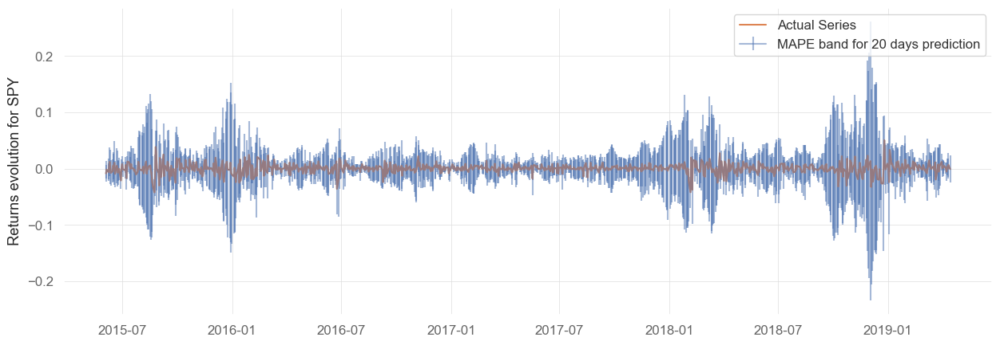

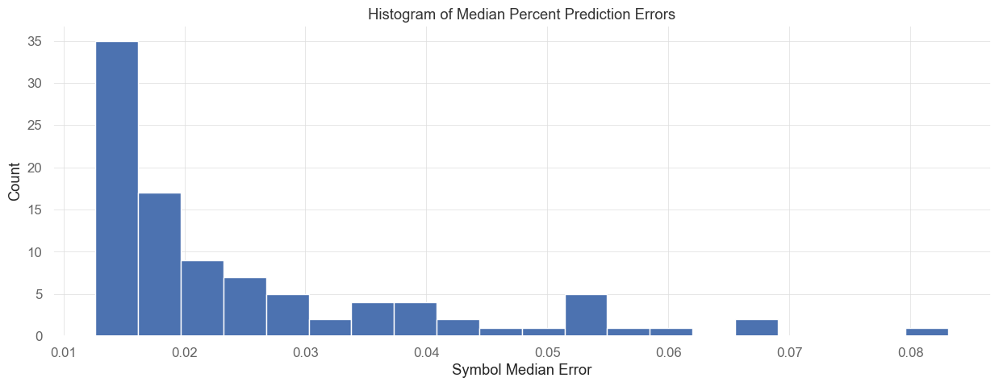

count    97.000000
mean      0.025302
std       0.014935
min       0.012653
25%       0.014540
50%       0.019115
75%       0.030193
max       0.083119
Name: 50%, dtype: float64
Median of Median Errors    0.019115
Mean of Median Errors      0.025302
Mean of Mean Errors        0.032986
dtype: float64
max_depth: 4, learning_rate: 0.005
------
Training BIB...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002707 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8589
[LightGBM] [Info] Number of data points in the train set: 11500, number of used features: 44
[LightGBM] [Info] Start training from score 0.003317
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

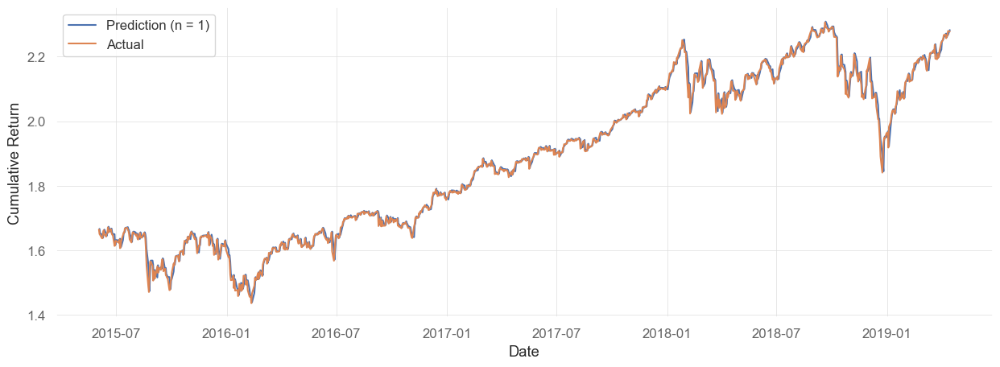

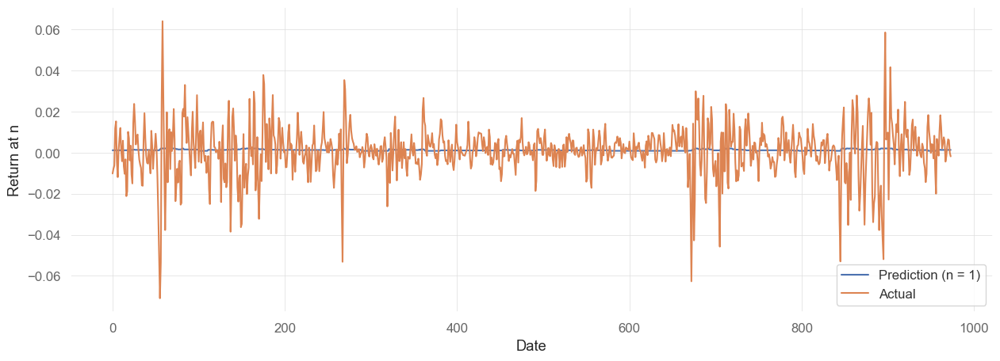

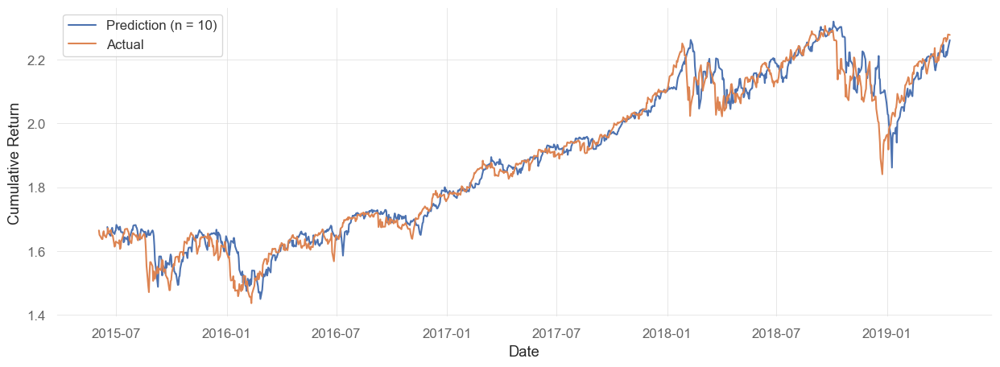

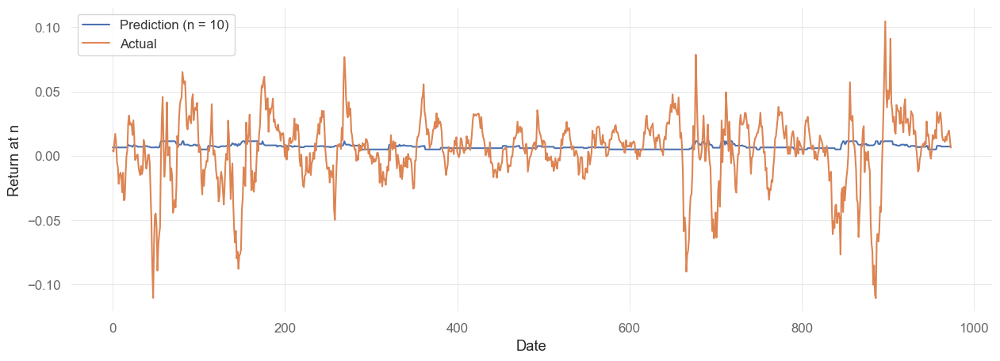

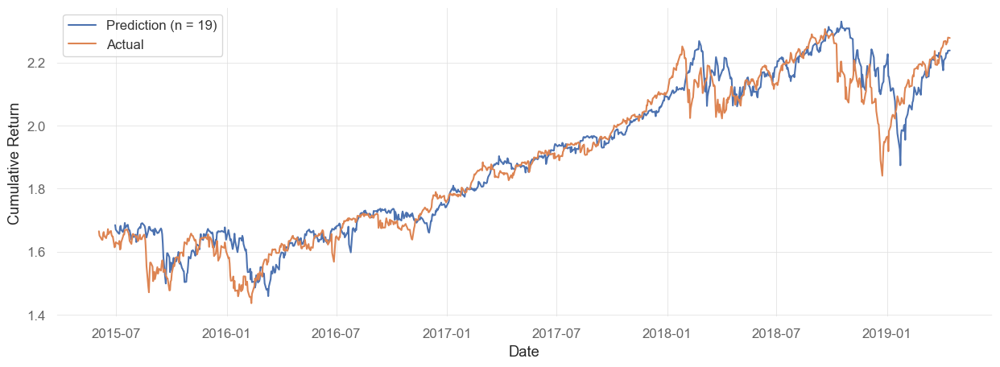

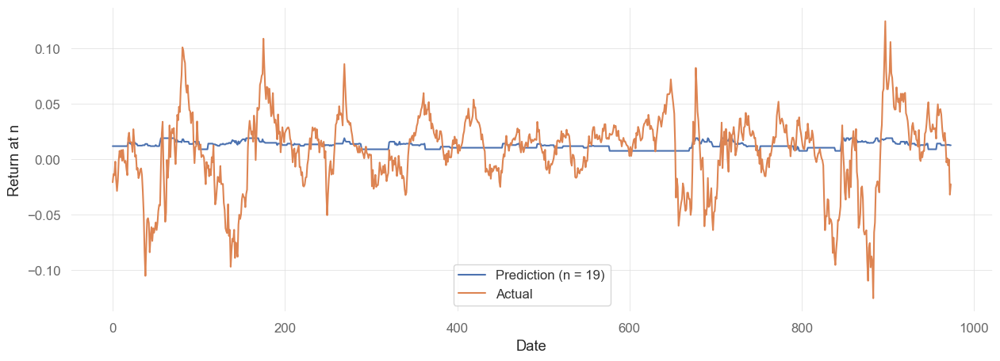

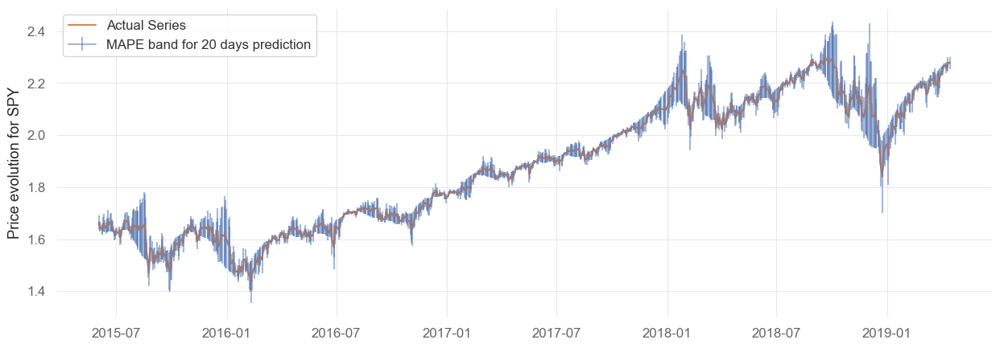

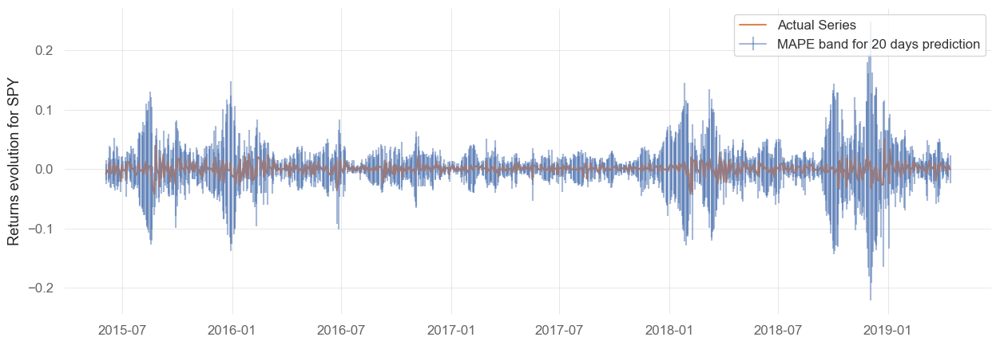

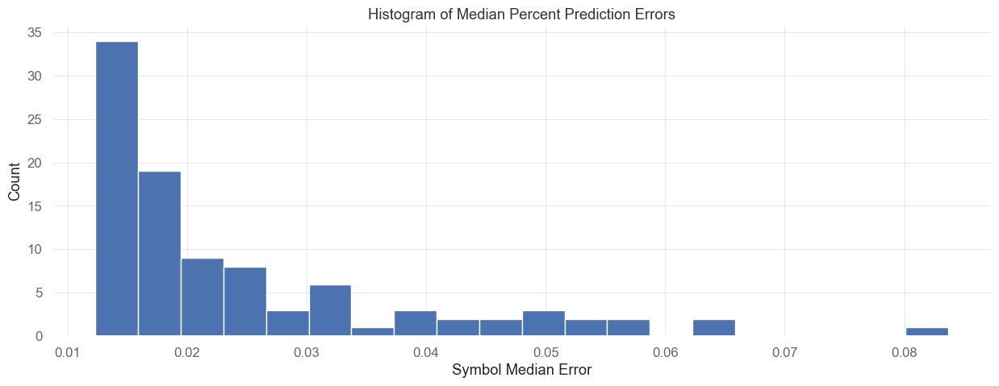

count    97.000000
mean      0.024491
std       0.014367
min       0.012344
25%       0.014353
50%       0.019178
75%       0.029026
max       0.083689
Name: 50%, dtype: float64
Median of Median Errors    0.019178
Mean of Median Errors      0.024491
Mean of Mean Errors        0.031986
dtype: float64
max_depth: 4, learning_rate: 0.001
------


In [9]:
max_depth_vals = [3, 4]
learning_rate_vals = [0.01, 0.005, 0.001]
df_results = None
for max_depth in max_depth_vals:
    for learning_rate in learning_rate_vals:
        lgbm_model = UnivariateLightGBMs(
            windows=[5, 20, 60, 180, 400],
            lgbm_hpts={"max_depth": max_depth, "learning_rate": learning_rate},
        )
        lgbm_model.fit(df_train.iloc[:i_predict_min])
        predictions_lgbm = lgbm_model.predict(
            df_train,
            n_steps_predict=w_size,
            index_start=i_predict_min,
            index_end=i_predict_max + 1,
        )
        ser_results = summary_analysis(
            df=df_train,
            n_predict=w_size,
            predictions=predictions_lgbm[:-1, :, :],
            actuals=actuals,
            index_start=i_predict_min,
            index_end=i_predict_max,
            symbol="SPY",
        )
        print(f"max_depth: {max_depth}, learning_rate: {learning_rate}")
        print("------")
        if df_results is None:
            df_results = pd.DataFrame(ser_results).T
            df_results["max_depth"] = max_depth
            df_results["learning_rate"] = learning_rate
        else:
            df_res = pd.DataFrame(ser_results).T
            df_res["max_depth"] = max_depth
            df_res["learning_rate"] = learning_rate
            df_results = pd.concat([df_results, df_res], axis=0).reset_index(drop=True)
df_results.to_csv("results_lightgbm3.csv")